<a href="https://colab.research.google.com/github/kuldeep27396/Apparel-recommendation/blob/master/Kuldeep_AppliedAIWorkshop.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<h1> Amazon Apparel Recommendations </h1>



In [1]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [13]:
ls

 16k_data_cnn_feature_asins.npy  'Installing Python'
 16k_data_cnn_features.npy        pickels/
 16k_images/                      Python_Optional/
 AppliedAIWorkshop.ipynb          tops_fashion.json
 dedupe/                          word2vec_model
 image_similarity_cnn.ipynb


### [4.2] Data and Code:
https://drive.google.com/open?id=0BwNkduBnePt2VWhCYXhMV3p4dTg



In [17]:
pip3 install pandas --upgrade

SyntaxError: ignored

### [4.3] Overview of the data

In [18]:
#import all the necessary packages.

from PIL import Image
import requests
from io import BytesIO
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import warnings
from bs4 import BeautifulSoup
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
import math
import time
import re
import os
import pandas.util.testing as tm
import seaborn as sns
from collections import Counter
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity  
from sklearn.metrics import pairwise_distances
from matplotlib import gridspec
from scipy.sparse import hstack
import plotly
import plotly.figure_factory as ff
from plotly.graph_objs import Scatter, Layout

plotly.offline.init_notebook_mode(connected=True)
warnings.filterwarnings("ignore")

In [0]:
# we have give a json file which consists of all information about
# the products
# loading the data using pandas' read_json file.
data = pd.read_json('tops_fashion.json')


In [20]:
print ('Number of data points : ', data.shape[0], \
       'Number of features/variables:', data.shape[1])

Number of data points :  183138 Number of features/variables: 19


### Terminology:
What is a dataset? <br>
Rows and columns <br>
Data-point <br>
Feature/variable <br>







In [22]:
# each product/item has 19 features in the raw dataset.
data.columns # prints column-names or feature-names.

Index(['sku', 'asin', 'product_type_name', 'formatted_price', 'author',
       'color', 'brand', 'publisher', 'availability', 'reviews',
       'large_image_url', 'availability_type', 'small_image_url',
       'editorial_review', 'title', 'model', 'medium_image_url',
       'manufacturer', 'editorial_reivew'],
      dtype='object')

Of these 19 features, we will be using only 6 features in this workshop.
    1. asin  ( Amazon standard identification number)
    2. brand ( brand to which the product belongs to )
    3. color ( Color information of apparel, it can contain many colors as   a value ex: red and black stripes ) 
    4. product_type_name (type of the apperal, ex: SHIRT/TSHIRT )
    5. medium_image_url  ( url of the image )
    6. title (title of the product.)
    7. formatted_price (price of the product)

In [0]:
data = data[['asin', 'brand', 'color', 'medium_image_url', 'product_type_name', 'title', 'formatted_price']]

In [24]:
print ('Number of data points : ', data.shape[0], \
       'Number of features:', data.shape[1])
data.head() # prints the top rows in the table.

Number of data points :  183138 Number of features: 7


,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
0,B016I2TS4W,FNC7C,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,Minions Como Superheroes Ironman Long Sleeve R...,None
1,B01N49AI08,FIG Clothing,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,FIG Clothing Womens Izo Tunic,None
2,B01JDPCOHO,FIG Clothing,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,FIG Clothing Womens Won Top,None
3,B01N19U5H5,Focal18,None,https://images-na.ssl-images-amazon.com/images...,SHIRT,Focal18 Sailor Collar Bubble Sleeve Blouse Shi...,None
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26


### [5.1] Missing data for various features.

####  Basic stats for the feature: product_type_name

In [25]:
# We have total 72 unique type of product_type_names
print(data['product_type_name'].describe())

# 91.62% (167794/183138) of the products are shirts,


count     183138
unique        72
top        SHIRT
freq      167794
Name: product_type_name, dtype: object


In [26]:
# names of different product types
print(data['product_type_name'].unique())

['SHIRT' 'SWEATER' 'APPAREL' 'OUTDOOR_RECREATION_PRODUCT'
 'BOOKS_1973_AND_LATER' 'PANTS' 'HAT' 'SPORTING_GOODS' 'DRESS' 'UNDERWEAR'
 'SKIRT' 'OUTERWEAR' 'BRA' 'ACCESSORY' 'ART_SUPPLIES' 'SLEEPWEAR'
 'ORCA_SHIRT' 'HANDBAG' 'PET_SUPPLIES' 'SHOES' 'KITCHEN' 'ADULT_COSTUME'
 'HOME_BED_AND_BATH' 'MISC_OTHER' 'BLAZER' 'HEALTH_PERSONAL_CARE'
 'TOYS_AND_GAMES' 'SWIMWEAR' 'CONSUMER_ELECTRONICS' 'SHORTS' 'HOME'
 'AUTO_PART' 'OFFICE_PRODUCTS' 'ETHNIC_WEAR' 'BEAUTY'
 'INSTRUMENT_PARTS_AND_ACCESSORIES' 'POWERSPORTS_PROTECTIVE_GEAR' 'SHIRTS'
 'ABIS_APPAREL' 'AUTO_ACCESSORY' 'NONAPPARELMISC' 'TOOLS' 'BABY_PRODUCT'
 'SOCKSHOSIERY' 'POWERSPORTS_RIDING_SHIRT' 'EYEWEAR' 'SUIT'
 'OUTDOOR_LIVING' 'POWERSPORTS_RIDING_JACKET' 'HARDWARE' 'SAFETY_SUPPLY'
 'ABIS_DVD' 'VIDEO_DVD' 'GOLF_CLUB' 'MUSIC_POPULAR_VINYL'
 'HOME_FURNITURE_AND_DECOR' 'TABLET_COMPUTER' 'GUILD_ACCESSORIES'
 'ABIS_SPORTS' 'ART_AND_CRAFT_SUPPLY' 'BAG' 'MECHANICAL_COMPONENTS'
 'SOUND_AND_RECORDING_EQUIPMENT' 'COMPUTER_COMPONENT' 'JEWELRY'
 'B

In [27]:
# find the 10 most frequent product_type_names.
product_type_count = Counter(list(data['product_type_name']))
product_type_count.most_common(10)

[('SHIRT', 167794),
 ('APPAREL', 3549),
 ('BOOKS_1973_AND_LATER', 3336),
 ('DRESS', 1584),
 ('SPORTING_GOODS', 1281),
 ('SWEATER', 837),
 ('OUTERWEAR', 796),
 ('OUTDOOR_RECREATION_PRODUCT', 729),
 ('ACCESSORY', 636),
 ('UNDERWEAR', 425)]

####  Basic stats for the feature: brand

In [28]:
# there are 10577 unique brands
print(data['brand'].describe())

# 183138 - 182987 = 151 missing values.

count     182987
unique     10577
top         Zago
freq         223
Name: brand, dtype: object


In [29]:
brand_count = Counter(list(data['brand']))
brand_count.most_common(10)

[('Zago', 223),
 ('XQS', 222),
 ('Yayun', 215),
 ('YUNY', 198),
 ('XiaoTianXin-women clothes', 193),
 ('Generic', 192),
 ('Boohoo', 190),
 ('Alion', 188),
 ('Abetteric', 187),
 ('TheMogan', 187)]

####  Basic stats for the feature: color

In [30]:

print(data['color'].describe())


# we have 7380 unique colors
# 7.2% of products are black in color
# 64956 of 183138 products have brand information. That's approx 35.4%.

count     64956
unique     7380
top       Black
freq      13207
Name: color, dtype: object


In [31]:
color_count = Counter(list(data['color']))
color_count.most_common(10)

[(None, 118182),
 ('Black', 13207),
 ('White', 8616),
 ('Blue', 3570),
 ('Red', 2289),
 ('Pink', 1842),
 ('Grey', 1499),
 ('*', 1388),
 ('Green', 1258),
 ('Multi', 1203)]

####  Basic stats for the feature: formatted_price

In [32]:
 
print(data['formatted_price'].describe())

# Only 28,395 (15.5% of whole data) products with price information

count      28395
unique      3135
top       $19.99
freq         945
Name: formatted_price, dtype: object


In [33]:
price_count = Counter(list(data['formatted_price']))
price_count.most_common(10)

[(None, 154743),
 ('$19.99', 945),
 ('$9.99', 749),
 ('$9.50', 601),
 ('$14.99', 472),
 ('$7.50', 463),
 ('$24.99', 414),
 ('$29.99', 370),
 ('$8.99', 343),
 ('$9.01', 336)]

#### Basic stats for the feature: title


In [34]:
print(data['title'].describe())

# All of the products have a title. 
# Titles are fairly descriptive of what the product is. 
# We use titles extensively in this workshop 
# as they are short and informative.


count                                                183138
unique                                               175985
top       Nakoda Cotton Self Print Straight Kurti For Women
freq                                                     77
Name: title, dtype: object


In [44]:
ls

16k_apperal_data               17k_apperal_data   180k_apperal_data
16k_apperal_data_preprocessed  180k_apparel_data  28k_apparel_data


In [46]:
data.to_pickle('28k_apparel_data')

PermissionError: ignored

   We save data files at every major step in our processing in "pickle" files. If you are stuck anywhere (or) if some code takes too long to run on your laptop, you may use the pickle files we give you to speed things up.

In [53]:
# consider products which have price information
# data['formatted_price'].isnull() => gives the information 
#about the dataframe row's which have null values price == None|Null
data = data.loc[~data['formatted_price'].isnull()]
print('Number of data points After eliminating price=NULL :', data.shape[0])

Number of data points After eliminating price=NULL : 28385


In [54]:
# consider products which have color information
# data['color'].isnull() => gives the information about the dataframe row's which have null values price == None|Null
data =data.loc[~data['color'].isnull()]
print('Number of data points After eliminating color=NULL :', data.shape[0])

Number of data points After eliminating color=NULL : 28385


#### We brought down the number of data points from 183K  to 28K.

We are processing only 28K points so that most of the workshop participants can run this code on thier laptops in a reasonable amount of time. <br> 

For those of you who have powerful computers and some time to spare, you are recommended to use all of the 183K images.


In [50]:
data.to_pickle('28k_apparel_data')

PermissionError: ignored

In [0]:
# You can download all these 28k images using this code below.
# You do NOT need to run this code and hence it is commented.


'''
from PIL import Image
import requests
from io import BytesIO

for index, row in images.iterrows():
        url = row['large_image_url']
        response = requests.get(url)
        img = Image.open(BytesIO(response.content))
        img.save('images/28k_images/'+row['asin']+'.jpeg')


'''

"\nfrom PIL import Image\nimport requests\nfrom io import BytesIO\n\nfor index, row in images.iterrows():\n        url = row['large_image_url']\n        response = requests.get(url)\n        img = Image.open(BytesIO(response.content))\n        img.save('workshop/images/28k_images/'+row['asin']+'.jpeg')\n\n\n"

### [5.2] Remove near duplicate items

#### [5.2.1] Understand about duplicates.

In [51]:
# read data from pickle file from previous stage
data = pd.read_pickle('pickels/28k_apparel_data')

# find number of products that have duplicate titles.
print(sum(data.duplicated('title')))
# we have 2325 products which have same title but different color


FileNotFoundError: ignored

In [55]:
print(sum(data.duplicated('title')))

2325


#### These shirts are exactly same except in size (S, M,L,XL)

![alt text](https://)<table>
<tr> 
<td><img src="/content/drive/My Drive/Data Science and ML/Copy of Applied_AI_Workshop_Code_Data/dedupe/B00AQ4GMCK.jpeg",width=100,height=100> :B00AQ4GMCK</td>
<td><img src="/content/drive/My Drive/Data Science and ML/Copy of Applied_AI_Workshop_Code_Data/dedupe/B00AQ4GMTS.jpeg",width=100,height=100> :B00AQ4GMTS</td>
</tr>
<tr> 
<td><img src="/content/drive/My Drive/Data Science and ML/Copy of Applied_AI_Workshop_Code_Data/dedupe/B00AQ4GMLQ.jpeg",width=100,height=100> :B00AQ4GMLQ</td>
<td><img src="/content/drive/My Drive/Data Science and ML/Copy of Applied_AI_Workshop_Code_Data/dedupe/B00AQ4GN3I.jpeg",width=100,height=100> :B00AQ4GN3I</td>
</tr>
</table>

#### These shirts exactly same except  in color

<table>
<tr> 
<td><img src="dedupe/B00G278GZ6.jpeg",width=100,height=100> :B00G278GZ6</td>
<td><img src="dedupe/B00G278W6O.jpeg",width=100,height=100> :B00G278W6O</td>
</tr>
<tr> 
<td><img src="dedupe/B00G278Z2A.jpeg",width=100,height=100> :B00G278Z2A</td>
<td><img src="dedupe/B00G2786X8.jpeg",width=100,height=100> :B00G2786X8</td>
</tr>
</table>

#### In our data there are many duplicate products like the above examples, we need to de-dupe them for better results.


#### [5.2.2] Remove duplicates : Part 1

In [0]:
# read data from pickle file from previous stage
data = pd.read_pickle('pickels/28k_apparel_data')

In [56]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
4,B004GSI2OS,FeatherLite,Onyx Black/ Stone,https://images-na.ssl-images-amazon.com/images...,SHIRT,Featherlite Ladies' Long Sleeve Stain Resistan...,$26.26
6,B012YX2ZPI,HX-Kingdom Fashion T-shirts,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,Women's Unique 100% Cotton T - Special Olympic...,$9.99
11,B001LOUGE4,Fitness Etc.,Black,https://images-na.ssl-images-amazon.com/images...,SHIRT,Ladies Cotton Tank 2x1 Ribbed Tank Top,$11.99
15,B003BSRPB0,FeatherLite,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,FeatherLite Ladies' Moisture Free Mesh Sport S...,$20.54
21,B014ICEDNA,FNC7C,Purple,https://images-na.ssl-images-amazon.com/images...,SHIRT,Supernatural Chibis Sam Dean And Castiel Short...,$7.50


In [57]:
# Remove All products with very few words in title
data_sorted = data[data['title'].apply(lambda x: len(x.split())>4)]
print("After removal of products with short description:", data_sorted.shape[0])

After removal of products with short description: 27949


In [58]:
# Sort the whole data based on title (alphabetical order of title) 
data_sorted.sort_values('title',inplace=True, ascending=False)
data_sorted.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
61973,B06Y1KZ2WB,Éclair,Black/Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,Éclair Women's Printed Thin Strap Blouse Black...,$24.99
133820,B010RV33VE,xiaoming,Pink,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Womens Sleeveless Loose Long T-shirts...,$18.19
81461,B01DDSDLNS,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Women's White Long Sleeve Single Brea...,$21.58
75995,B00X5LYO9Y,xiaoming,Red Anchors,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Stripes Tank Patch/Bear Sleeve Anchor...,$15.91
151570,B00WPJG35K,xiaoming,White,https://images-na.ssl-images-amazon.com/images...,SHIRT,xiaoming Sleeve Sheer Loose Tassel Kimono Woma...,$14.32


#### Some examples of dupliacte titles that differ only in the last few words.

<pre>
Titles 1:
16. woman's place is in the house and the senate shirts for Womens XXL White
17. woman's place is in the house and the senate shirts for Womens M Grey

Title 2:
25. tokidoki The Queen of Diamonds Women's Shirt X-Large
26. tokidoki The Queen of Diamonds Women's Shirt Small
27. tokidoki The Queen of Diamonds Women's Shirt Large

Title 3:
61. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
62. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
63. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
64. psychedelic colorful Howling Galaxy Wolf T-shirt/Colorful Rainbow Animal Print Head Shirt for woman Neon Wolf t-shirt
</pre>

In [0]:
indices = []
for i,row in data_sorted.iterrows():
    indices.append(i)

In [0]:
import itertools
stage1_dedupe_asins = []
i = 0
j = 0
num_data_points = data_sorted.shape[0]
while i < num_data_points and j < num_data_points:
    
    previous_i = i

    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    a = data['title'].loc[indices[i]].split()

    # search for the similar products sequentially 
    j = i+1
    while j < num_data_points:

        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'Small']
        b = data['title'].loc[indices[j]].split()

        # store the maximum length of two strings
        length = max(len(a), len(b))

        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0] == k[1]):
                count += 1

        # if the number of words in which both strings differ are > 2 , we are considering it as those two apperals are different
        # if the number of words in which both strings differ are < 2 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) > 2: # number of words in which both sensences differ
            # if both strings are differ by more than 2 words we include the 1st string index
            stage1_dedupe_asins.append(data_sorted['asin'].loc[indices[i]])


            # start searching for similar apperals corresponds 2nd string
            i = j
            break
        else:
            j += 1
    if previous_i == i:
        break

In [0]:
data = data.loc[data['asin'].isin(stage1_dedupe_asins)]

#### We removed  the dupliactes which differ only at the end.

In [62]:
print('Number of data points : ', data.shape[0])

Number of data points :  17592


In [63]:
data.to_pickle('pickels/17k_apperal_data')

FileNotFoundError: ignored

#### [5.2.3] Remove duplicates : Part 2

<pre>

In the previous cell, we sorted whole data in alphabetical order of  titles.Then, we removed titles which are adjacent and very similar title

But there are some products whose titles are not adjacent but very similar.

Examples:

Titles-1
86261.  UltraClub Women's Classic Wrinkle-Free Long Sleeve Oxford Shirt, Pink, XX-Large
115042. UltraClub Ladies Classic Wrinkle-Free Long-Sleeve Oxford Light Blue XXL

TItles-2
75004.  EVALY Women's Cool University Of UTAH 3/4 Sleeve Raglan Tee
109225. EVALY Women's Unique University Of UTAH 3/4 Sleeve Raglan Tees
120832. EVALY Women's New University Of UTAH 3/4-Sleeve Raglan Tshirt

</pre>

In [0]:
data = pd.read_pickle('pickels/17k_apperal_data')

In [0]:
# This code snippet takes significant amount of time.
# O(n^2) time.
# Takes about an hour to run on a decent computer.

indices = []
for i,row in data.iterrows():
    indices.append(i)

stage2_dedupe_asins = []
while len(indices)!=0:
    i = indices.pop()
    stage2_dedupe_asins.append(data['asin'].loc[i])
    # consider the first apperal's title
    a = data['title'].loc[i].split()
    # store the list of words of ith string in a, ex: a = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
    for j in indices:
        
        b = data['title'].loc[j].split()
        # store the list of words of jth string in b, ex: b = ['tokidoki', 'The', 'Queen', 'of', 'Diamonds', 'Women's', 'Shirt', 'X-Large']
        
        length = max(len(a),len(b))
        
        # count is used to store the number of words that are matched in both strings
        count  = 0

        # itertools.zip_longest(a,b): will map the corresponding words in both strings, it will appened None in case of unequal strings
        # example: a =['a', 'b', 'c', 'd']
        # b = ['a', 'b', 'd']
        # itertools.zip_longest(a,b): will give [('a','a'), ('b','b'), ('c','d'), ('d', None)]
        for k in itertools.zip_longest(a,b): 
            if (k[0]==k[1]):
                count += 1

        # if the number of words in which both strings differ are < 3 , we are considering it as those two apperals are same, hence we are ignoring them
        if (length - count) < 3:
            indices.remove(j)

In [0]:
# from whole previous products we will consider only 
# the products that are found in previous cell 
data = data.loc[data['asin'].isin(stage2_dedupe_asins)]

In [75]:
print('Number of data points after stage two of dedupe: ',data.shape[0])
# from 17k apperals we reduced to 16k apperals

Number of data points after stage two of dedupe:  721


In [69]:
data.to_pickle('pickels/16k_apperal_data')
# Storing these products in a pickle file
# candidates who wants to download these files instead 
# of 180K they can download and use them from the Google Drive folder.

FileNotFoundError: ignored

# 6. Text pre-processing

In [0]:
data = pd.read_pickle('pickels/16k_apperal_data')

# NLTK download stop words. [RUN ONLY ONCE]
# goto Terminal (Linux/Mac) or Command-Prompt (Window) 
# In the temrinal, type these commands
# $python3
# $import nltk
# $nltk.download()

In [76]:
import nltk
nltk.download()

NLTK Downloader
---------------------------------------------------------------------------
    d) Download   l) List    u) Update   c) Config   h) Help   q) Quit
---------------------------------------------------------------------------
Downloader> d

Download which package (l=list; x=cancel)?
  Identifier> l
Packages:
  [ ] abc................. Australian Broadcasting Commission 2006
  [ ] alpino.............. Alpino Dutch Treebank
  [ ] averaged_perceptron_tagger Averaged Perceptron Tagger
  [ ] averaged_perceptron_tagger_ru Averaged Perceptron Tagger (Russian)
  [ ] basque_grammars..... Grammars for Basque
  [ ] biocreative_ppi..... BioCreAtIvE (Critical Assessment of Information
                           Extraction Systems in Biology)
  [ ] bllip_wsj_no_aux.... BLLIP Parser: WSJ Model
  [ ] book_grammars....... Grammars from NLTK Book
  [ ] brown............... Brown Corpus
  [ ] brown_tei........... Brown Corpus (TEI XML Version)
  [ ] cess_cat............ CESS-CAT Treebank
  [

True

In [77]:
# we use the list of stop words that are downloaded from nltk lib.
stop_words = set(stopwords.words('english'))
print ('list of stop words:', stop_words)

def nlp_preprocessing(total_text, index, column):
    if type(total_text) is not int:
        string = ""
        for words in total_text.split():
            # remove the special chars in review like '"#$@!%^&*()_+-~?>< etc.
            word = ("".join(e for e in words if e.isalnum()))
            # Conver all letters to lower-case
            word = word.lower()
            # stop-word removal
            if not word in stop_words:
                string += word + " "
        data[column][index] = string

list of stop words: {'ours', 'weren', 'again', 'myself', 'him', 'their', 'under', 'through', 'yourselves', 'isn', 'further', 'some', 'theirs', 'shouldn', 'wouldn', 'we', 'is', 'mightn', 'being', 'off', 'don', 'am', "aren't", 'or', 'who', 'here', 'while', 'yours', 'in', 'for', 'its', 'she', 'his', 'them', 'than', 'have', "needn't", "shan't", 'up', "hasn't", "wasn't", 'other', 'then', "it's", 'same', 'those', 'll', 'himself', 'there', 'ma', 'my', 'out', 'between', 'this', 'can', 'her', 'herself', 'haven', 'after', 'because', 'did', 'having', "you've", "you're", 'by', "mightn't", 'themselves', 'with', 'hadn', 'until', "isn't", "mustn't", 'down', 'all', 'couldn', 'and', 'the', "shouldn't", "should've", "couldn't", 'mustn', "she's", 'does', 'most', 'your', 'such', 'do', "haven't", 'too', 'our', 'which', 'below', 'needn', "doesn't", 'y', 'had', 'as', 'few', 'but', "won't", 'just', 'they', 'own', 'd', "wouldn't", 'at', 'he', 'to', 'now', 'doesn', "don't", 'm', 'ourselves', 'won', 'over', "you

In [81]:
start_time = time.clock()
# we take each title and we text-preprocess it.
for index, row in data.iterrows():
    nlp_preprocessing(row['title'], index, 'title')
# we print the time it took to preprocess whole titles 
print(time.clock() - start_time, "seconds")

0.16006699999996954 seconds


In [79]:
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
174463,B00LNR2L4W,Apparel Sense,Navy,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens relaxed oversize premium cotton button ...,$15.99
174468,B01N6UUWLU,Caribbean Joe,Military Blue,https://images-na.ssl-images-amazon.com/images...,SHIRT,caribbean joe petite tropical storm crochet fr...,$19.99
174469,B01N8ZWV3E,Kylin Express,White B,https://images-na.ssl-images-amazon.com/images...,SHIRT,fashionable shirt collar fake collar detachabl...,$14.66
174484,B0757856HY,Blue Life,White/Grey,https://images-na.ssl-images-amazon.com/images...,SHIRT,blue life izzy top fades grey,$92.00
174485,B019XS6OLS,Anna-Kaci,Red,https://images-na.ssl-images-amazon.com/images...,SHIRT,anna kaci sm fit womens lace hem long sheer sl...,$19.99


In [0]:
data.to_pickle('pickels/16k_apperal_data_preprocessed')

## Stemming 

In [80]:
from nltk.stem.porter import *
stemmer = PorterStemmer()
print(stemmer.stem('arguing'))
print(stemmer.stem('fishing'))


# We tried using stemming on our titles and it didnot work very well. 


argu
fish


# [8] Text based product similarity

In [91]:
#data = pd.read_pickle('pickels/16k_apperal_data_preprocessed')
data.head()

,asin,brand,color,medium_image_url,product_type_name,title,formatted_price
174463,B00LNR2L4W,Apparel Sense,Navy,https://images-na.ssl-images-amazon.com/images...,SHIRT,womens relaxed oversize premium cotton button ...,$15.99
174468,B01N6UUWLU,Caribbean Joe,Military Blue,https://images-na.ssl-images-amazon.com/images...,SHIRT,caribbean joe petite tropical storm crochet fr...,$19.99
174469,B01N8ZWV3E,Kylin Express,White B,https://images-na.ssl-images-amazon.com/images...,SHIRT,fashionable shirt collar fake collar detachabl...,$14.66
174484,B0757856HY,Blue Life,White/Grey,https://images-na.ssl-images-amazon.com/images...,SHIRT,blue life izzy top fades grey,$92.00
174485,B019XS6OLS,Anna-Kaci,Red,https://images-na.ssl-images-amazon.com/images...,SHIRT,anna kaci sm fit womens lace hem long sheer sl...,$19.99


In [0]:
# Utility Functions which we will use through the rest of the workshop.


#Display an image
def display_img(url,ax,fig):
    # we get the url of the apparel and download it
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    # we will display it in notebook 
    plt.imshow(img)
  
#plotting code to understand the algorithm's decision.
def plot_heatmap(keys, values, labels, url, text):
        # keys: list of words of recommended title
        # values: len(values) ==  len(keys), values(i) represents the occurence of the word keys(i)
        # labels: len(labels) == len(keys), the values of labels depends on the model we are using
                # if model == 'bag of words': labels(i) = values(i)
                # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
                # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))
        # url : apparel's url

        # we will devide the whole figure into two parts
        gs = gridspec.GridSpec(2, 2, width_ratios=[4,1], height_ratios=[4,1]) 
        fig = plt.figure(figsize=(25,3))
        
        # 1st, ploting heat map that represents the count of commonly ocurred words in title2
        ax = plt.subplot(gs[0])
        # it displays a cell in white color if the word is intersection(lis of words of title1 and list of words of title2), in black if not
        ax = sns.heatmap(np.array([values]), annot=np.array([labels]))
        ax.set_xticklabels(keys) # set that axis labels as the words of title
        ax.set_title(text) # apparel title
        
        # 2nd, plotting image of the the apparel
        ax = plt.subplot(gs[1])
        # we don't want any grid lines for image and no labels on x-axis and y-axis
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        
        # we call dispaly_img based with paramete url
        display_img(url, ax, fig)
        
        # displays combine figure ( heat map and image together)
        plt.show()
    
def plot_heatmap_image(doc_id, vec1, vec2, url, text, model):

    # doc_id : index of the title1
    # vec1 : input apparels's vector, it is of a dict type {word:count}
    # vec2 : recommended apparels's vector, it is of a dict type {word:count}
    # url : apparels image url
    # text: title of recomonded apparel (used to keep title of image)
    # model, it can be any of the models, 
        # 1. bag_of_words
        # 2. tfidf
        # 3. idf

    # we find the common words in both titles, because these only words contribute to the distance between two title vec's
    intersection = set(vec1.keys()) & set(vec2.keys()) 

    # we set the values of non intersecting words to zero, this is just to show the difference in heatmap
    for i in vec2:
        if i not in intersection:
            vec2[i]=0

    # for labeling heatmap, keys contains list of all words in title2
    keys = list(vec2.keys())
    #  if ith word in intersection(lis of words of title1 and list of words of title2): values(i)=count of that word in title2 else values(i)=0 
    values = [vec2[x] for x in vec2.keys()]
    
    # labels: len(labels) == len(keys), the values of labels depends on the model we are using
        # if model == 'bag of words': labels(i) = values(i)
        # if model == 'tfidf weighted bag of words':labels(i) = tfidf(keys(i))
        # if model == 'idf weighted bag of words':labels(i) = idf(keys(i))

    if model == 'bag_of_words':
        labels = values
    elif model == 'tfidf':
        labels = []
        for x in vec2.keys():
            # tfidf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # tfidf_title_features[doc_id, index_of_word_in_corpus] will give the tfidf value of word in given document (doc_id)
            if x in  tfidf_title_vectorizer.vocabulary_:
                labels.append(tfidf_title_features[doc_id, tfidf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)
    elif model == 'idf':
        labels = []
        for x in vec2.keys():
            # idf_title_vectorizer.vocabulary_ it contains all the words in the corpus
            # idf_title_features[doc_id, index_of_word_in_corpus] will give the idf value of word in given document (doc_id)
            if x in  idf_title_vectorizer.vocabulary_:
                labels.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[x]])
            else:
                labels.append(0)

    plot_heatmap(keys, values, labels, url, text)


# this function gets a list of wrods along with the frequency of each 
# word given "text"
def text_to_vector(text):
    word = re.compile(r'\w+')
    words = word.findall(text)
    # words stores list of all words in given string, you can try 'words = text.split()' this will also gives same result
    return Counter(words) # Counter counts the occurence of each word in list, it returns dict type object {word1:count}



def get_result(doc_id, content_a, content_b, url, model):
    text1 = content_a
    text2 = content_b
    
    # vector1 = dict{word11:#count, word12:#count, etc.}
    vector1 = text_to_vector(text1)

    # vector1 = dict{word21:#count, word22:#count, etc.}
    vector2 = text_to_vector(text2)

    plot_heatmap_image(doc_id, vector1, vector2, url, text2, model)

## [8.2] Bag of Words (BoW) on product titles.

In [93]:
from sklearn.feature_extraction.text import CountVectorizer
title_vectorizer = CountVectorizer()
title_features   = title_vectorizer.fit_transform(data['title'])
title_features.get_shape() # get number of rows and columns in feature matrix.
# title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(corpus) returns 
# the a sparase matrix of dimensions #data_points * #words_in_corpus

# What is a sparse vector?

# title_features[doc_id, index_of_word_in_corpus] = number of times the word occured in that doc



(721, 1324)

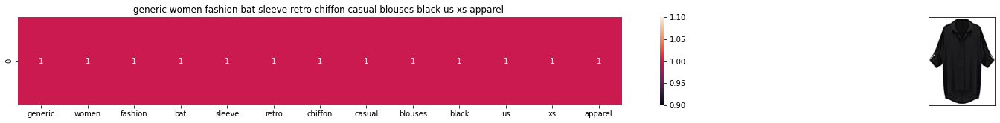

ASIN : B019MDNF8Y
Brand: Absolutely
Title: generic women fashion bat sleeve retro chiffon casual blouses black us xs apparel 
Euclidean similarity with the query image : 0.0


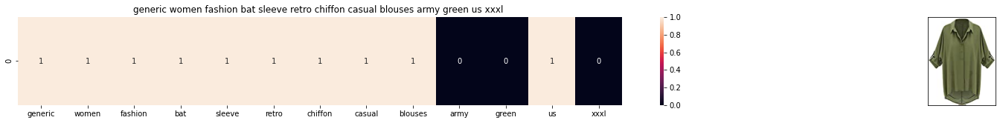

ASIN : B019MDNNHC
Brand: Absolutely
Title: generic women fashion bat sleeve retro chiffon casual blouses army green us xxxl 
Euclidean similarity with the query image : 2.449489742783178


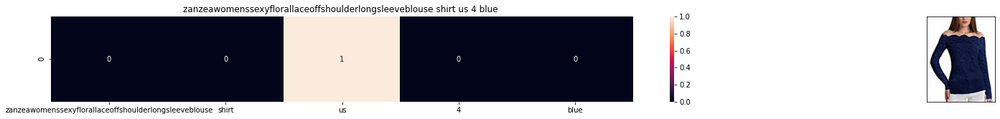

ASIN : B01192N6GC
Brand: ZANZEA
Title: zanzeawomenssexyflorallaceoffshoulderlongsleeveblouse shirt us 4 blue 
Euclidean similarity with the query image : 3.872983346207417


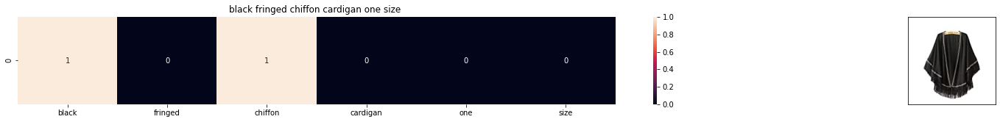

ASIN : B010AMAMLY
Brand: HP-LEISURE
Title: black fringed chiffon cardigan one size 
Euclidean similarity with the query image : 3.872983346207417


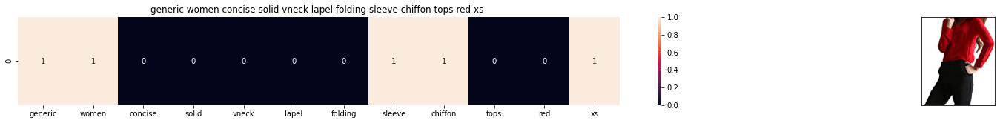

ASIN : B013JPTCV0
Brand: Absolutely
Title: generic women concise solid vneck lapel folding sleeve chiffon tops red xs 
Euclidean similarity with the query image : 3.872983346207417


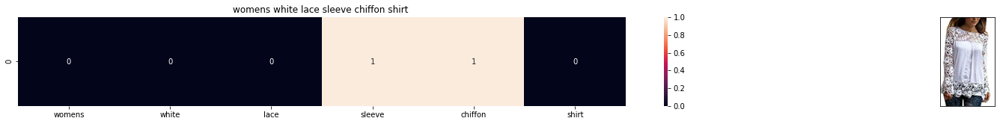

ASIN : B073JWSM1V
Brand: Fuming
Title: womens white lace sleeve chiffon shirt 
Euclidean similarity with the query image : 3.872983346207417


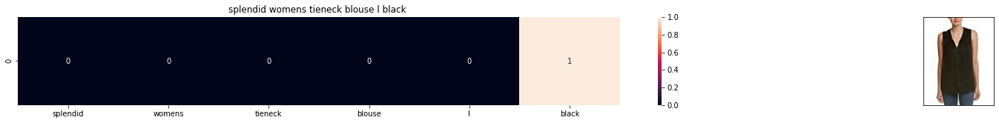

ASIN : B0716F4X2L
Brand: Splendid
Title: splendid womens tieneck blouse l black 
Euclidean similarity with the query image : 4.0


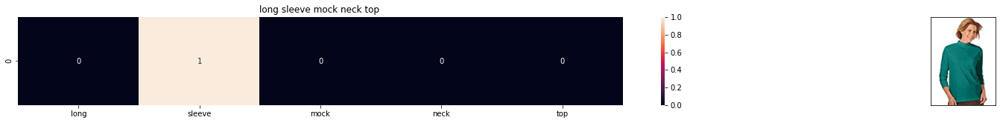

ASIN : B01KZYEWKO
Brand: AmeriMark
Title: long sleeve mock neck top 
Euclidean similarity with the query image : 4.0


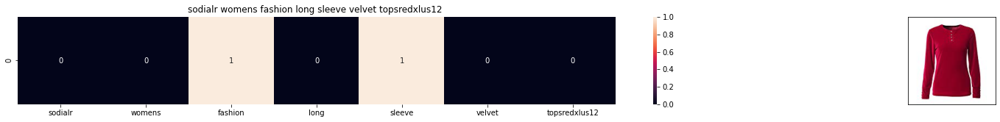

ASIN : B06XC25J1T
Brand: SODIAL(R)
Title: sodialr womens fashion long sleeve velvet topsredxlus12 
Euclidean similarity with the query image : 4.0


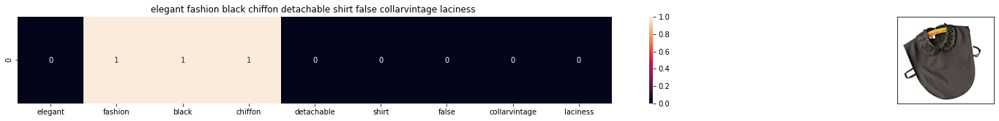

ASIN : B00WQWR9PE
Brand: Black Temptation
Title: elegant fashion black chiffon detachable shirt false collarvintage laciness 
Euclidean similarity with the query image : 4.0


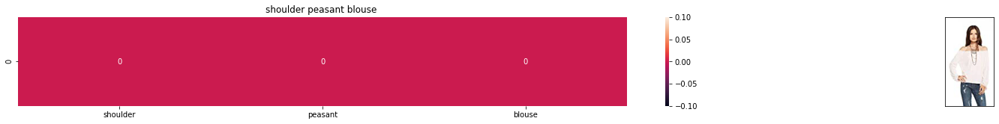

ASIN : B01E1QD5PK
Brand: CHASER
Title: shoulder peasant blouse 
Euclidean similarity with the query image : 4.0


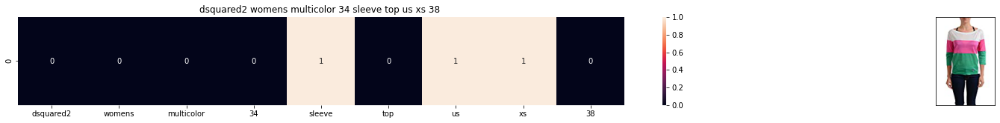

ASIN : B01LXSV2E3
Brand: DSQUARED2
Title: dsquared2 womens multicolor 34 sleeve top us xs 38 
Euclidean similarity with the query image : 4.0


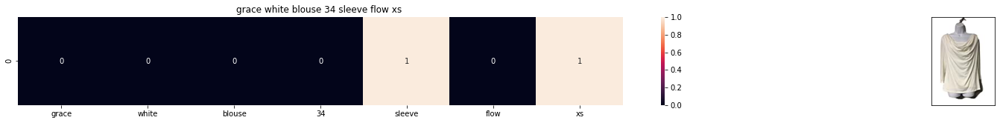

ASIN : B0721CW9F3
Brand: Grace
Title: grace white blouse 34 sleeve flow xs 
Euclidean similarity with the query image : 4.0


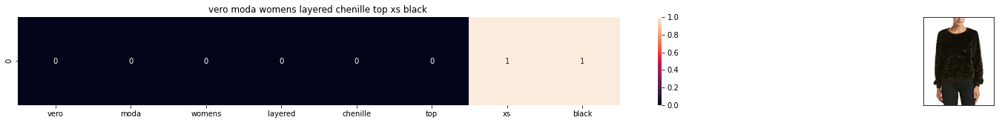

ASIN : B01N8UZQ8L
Brand: VERO MODA
Title: vero moda womens layered chenille top xs black 
Euclidean similarity with the query image : 4.123105625617661


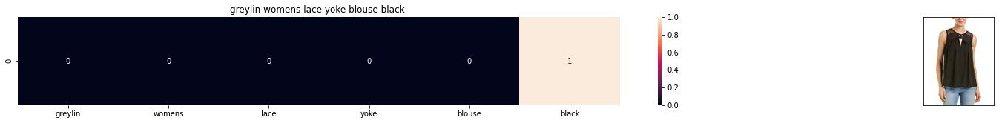

ASIN : B071XD23M5
Brand: Greylin
Title: greylin womens lace yoke blouse black 
Euclidean similarity with the query image : 4.123105625617661


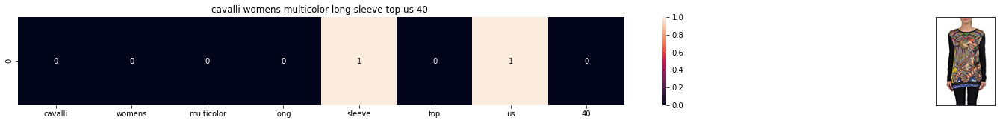

ASIN : B0175BBXY8
Brand: Just Cavalli
Title: cavalli womens multicolor long sleeve top us 40 
Euclidean similarity with the query image : 4.123105625617661


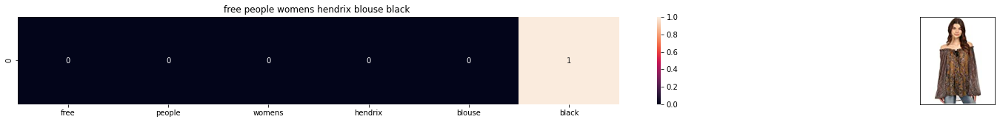

ASIN : B01DBEHXNI
Brand: Free People
Title: free people womens hendrix blouse black 
Euclidean similarity with the query image : 4.123105625617661


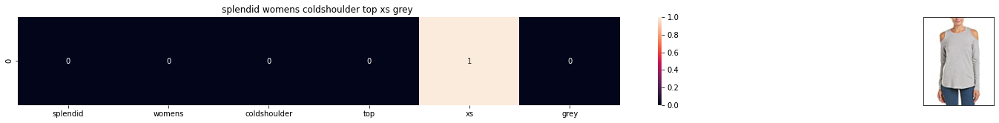

ASIN : B071KFX9ZN
Brand: Splendid
Title: splendid womens coldshoulder top xs grey 
Euclidean similarity with the query image : 4.123105625617661


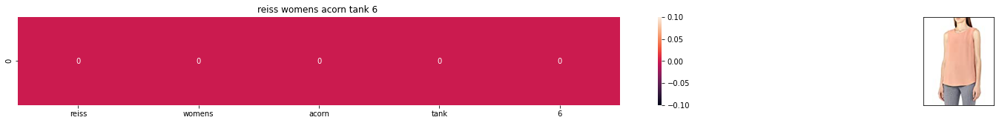

ASIN : B072J7C9L9
Brand: Reiss
Title: reiss womens acorn tank 6 
Euclidean similarity with the query image : 4.123105625617661


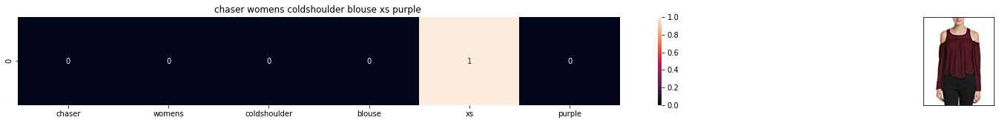

ASIN : B01N0YGSX2
Brand: CHASER
Title: chaser womens coldshoulder blouse xs purple 
Euclidean similarity with the query image : 4.123105625617661


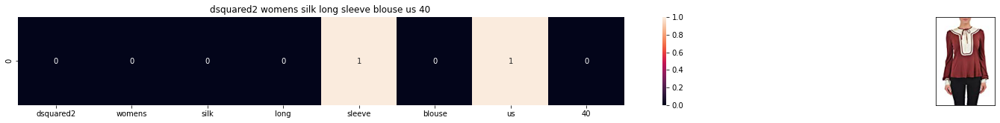

ASIN : B01759GD18
Brand: DSQUARED2
Title: dsquared2 womens silk long sleeve blouse us 40 
Euclidean similarity with the query image : 4.123105625617661


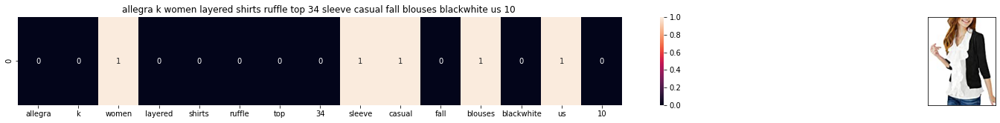

ASIN : B008X1FTI6
Brand: Allegra K
Title: allegra k women layered shirts ruffle top 34 sleeve casual fall blouses blackwhite us 10 
Euclidean similarity with the query image : 4.123105625617661


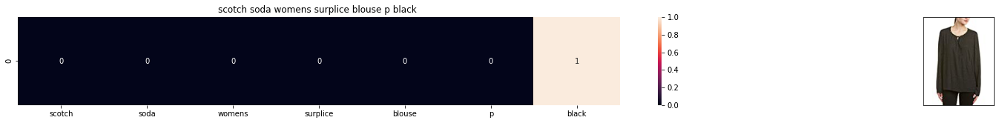

ASIN : B00VTPHIH8
Brand: Scotch & Soda
Title: scotch soda womens surplice blouse p black 
Euclidean similarity with the query image : 4.123105625617661


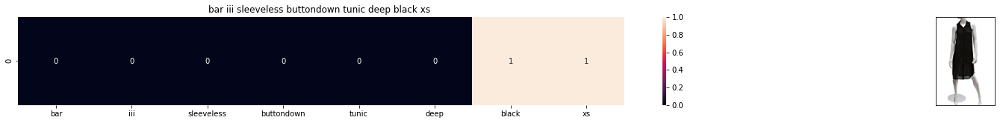

ASIN : B072364BLG
Brand: Bar III
Title: bar iii sleeveless buttondown tunic deep black xs 
Euclidean similarity with the query image : 4.123105625617661


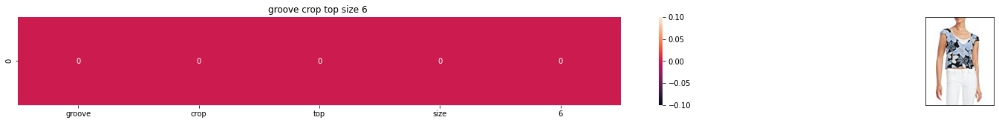

ASIN : B071RZ2ZRH
Brand: Free People
Title: groove crop top size 6 
Euclidean similarity with the query image : 4.123105625617661


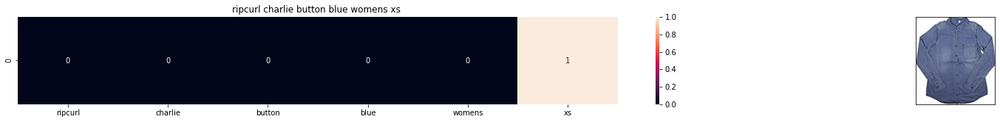

ASIN : B06XYNR9RZ
Brand: Rip Curl
Title: ripcurl charlie button blue womens xs 
Euclidean similarity with the query image : 4.123105625617661


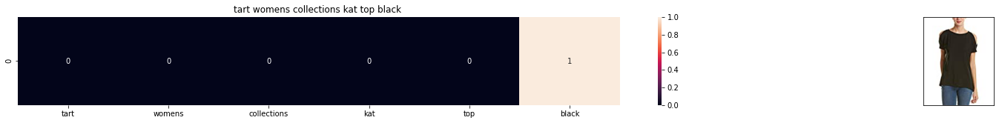

ASIN : B071QZQ29M
Brand: Tart Collections
Title: tart womens collections kat top black 
Euclidean similarity with the query image : 4.123105625617661


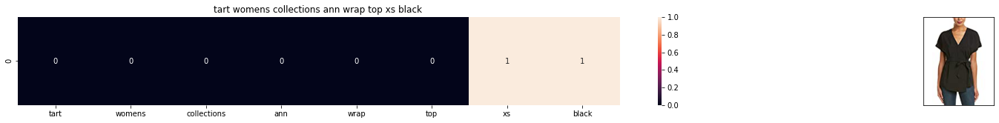

ASIN : B07167SCNH
Brand: Tart Collections
Title: tart womens collections ann wrap top xs black 
Euclidean similarity with the query image : 4.123105625617661


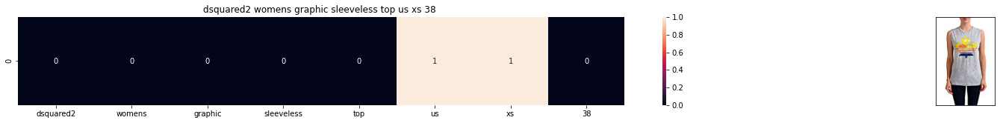

ASIN : B01LBADRWA
Brand: DSQUARED2
Title: dsquared2 womens graphic sleeveless top us xs 38 
Euclidean similarity with the query image : 4.123105625617661


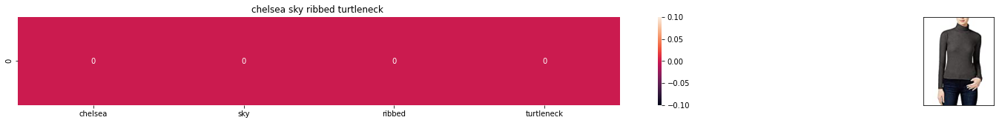

ASIN : B071ZBHPS4
Brand: chelsea sky
Title: chelsea sky ribbed turtleneck 
Euclidean similarity with the query image : 4.123105625617661


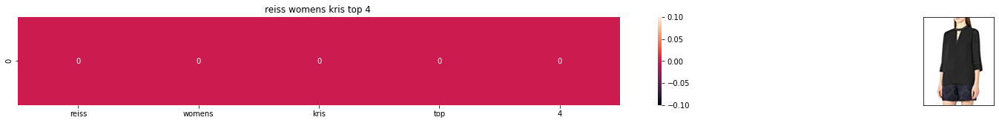

ASIN : B071VY4BH4
Brand: Reiss
Title: reiss womens kris top 4 
Euclidean similarity with the query image : 4.123105625617661


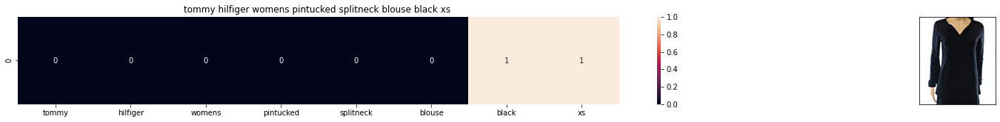

ASIN : B0759NHBZK
Brand: Tommy Hilfiger
Title: tommy hilfiger womens pintucked splitneck blouse black xs 
Euclidean similarity with the query image : 4.123105625617661


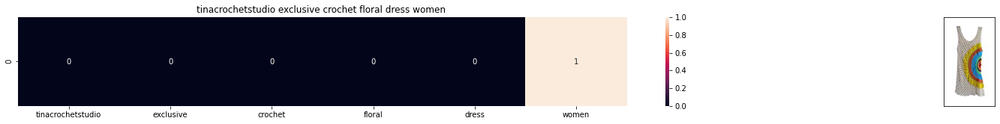

ASIN : B0161FG9D4
Brand: tinacrochetstudio
Title: tinacrochetstudio exclusive crochet floral dress women 
Euclidean similarity with the query image : 4.123105625617661


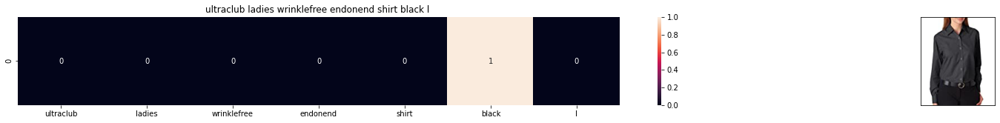

ASIN : B008LT16KU
Brand: UltraClub
Title: ultraclub ladies wrinklefree endonend shirt black l 
Euclidean similarity with the query image : 4.123105625617661


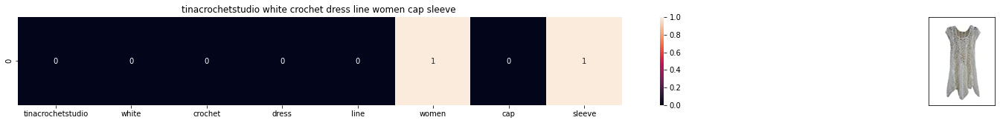

ASIN : B015Y4IX1O
Brand: tinacrochetstudio
Title: tinacrochetstudio white crochet dress line women cap sleeve 
Euclidean similarity with the query image : 4.123105625617661


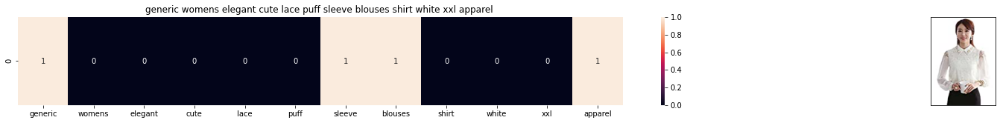

ASIN : B014CF1PC0
Brand: Absolutely
Title: generic womens elegant cute lace puff sleeve blouses shirt white xxl apparel 
Euclidean similarity with the query image : 4.123105625617661


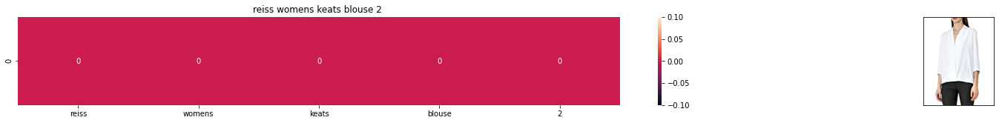

ASIN : B0741HDWGM
Brand: Reiss
Title: reiss womens keats blouse 2 
Euclidean similarity with the query image : 4.123105625617661


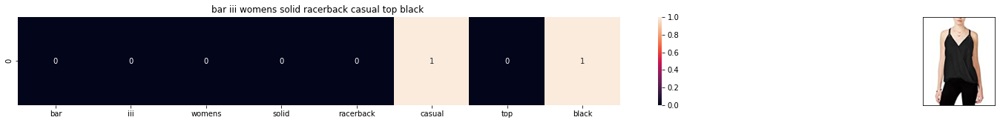

ASIN : B0724ZCX9F
Brand: Bar III
Title: bar iii womens solid racerback casual top black 
Euclidean similarity with the query image : 4.123105625617661


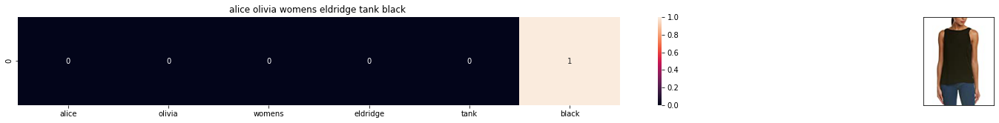

ASIN : B071G2YTJ4
Brand: alice + olivia
Title: alice olivia womens eldridge tank black 
Euclidean similarity with the query image : 4.123105625617661


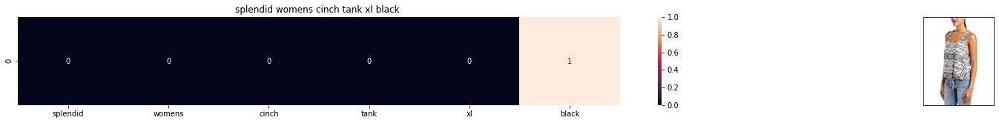

ASIN : B01N809GBN
Brand: Splendid
Title: splendid womens cinch tank xl black 
Euclidean similarity with the query image : 4.123105625617661


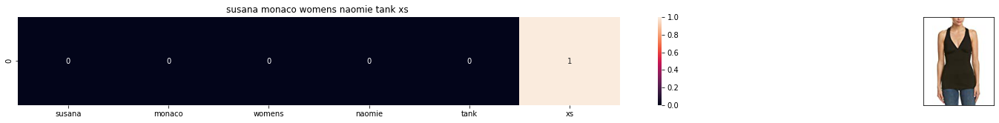

ASIN : B072R518Q1
Brand: susana monaco
Title: susana monaco womens naomie tank xs 
Euclidean similarity with the query image : 4.123105625617661


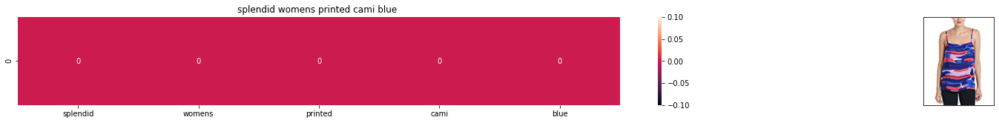

ASIN : B01N5XIJ0C
Brand: Splendid
Title: splendid womens printed cami blue 
Euclidean similarity with the query image : 4.242640687119285


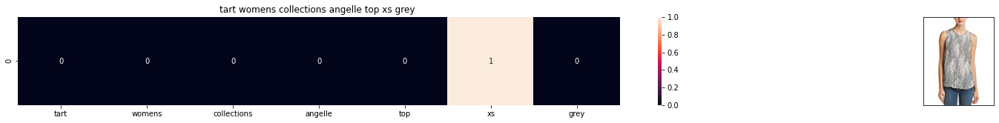

ASIN : B06ZZV4XXV
Brand: Tart Collections
Title: tart womens collections angelle top xs grey 
Euclidean similarity with the query image : 4.242640687119285


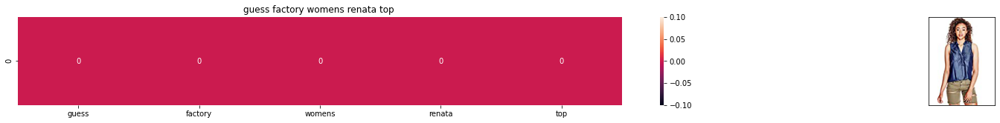

ASIN : B06XQG6S8D
Brand: G by GUESS
Title: guess factory womens renata top 
Euclidean similarity with the query image : 4.242640687119285


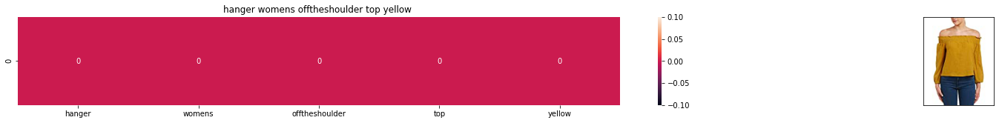

ASIN : B074F4LSN1
Brand: The Hanger
Title: hanger womens offtheshoulder top yellow 
Euclidean similarity with the query image : 4.242640687119285


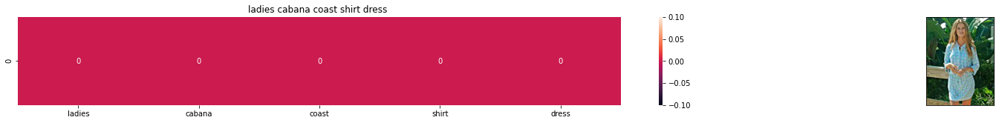

ASIN : B07572PP29
Brand: HAVEN
Title: ladies cabana coast shirt dress 
Euclidean similarity with the query image : 4.242640687119285


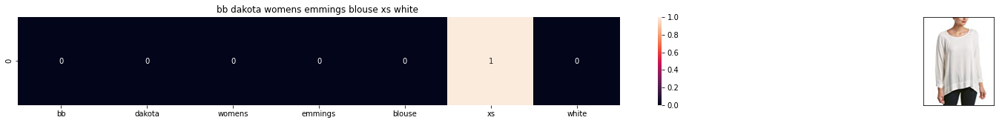

ASIN : B01MZ5CCUV
Brand: BB Dakota
Title: bb dakota womens emmings blouse xs white 
Euclidean similarity with the query image : 4.242640687119285


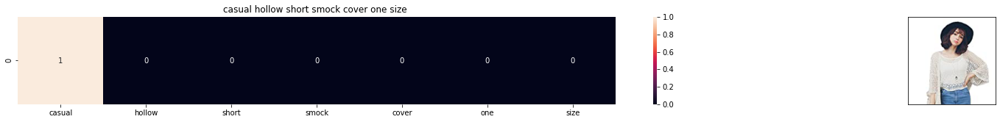

ASIN : B011KLNJSM
Brand: HP-LEISURE
Title: casual hollow short smock cover one size 
Euclidean similarity with the query image : 4.242640687119285


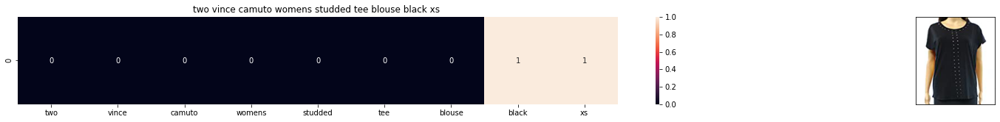

ASIN : B071GZJ5C8
Brand: Two by Vince Camuto
Title: two vince camuto womens studded tee blouse black xs 
Euclidean similarity with the query image : 4.242640687119285


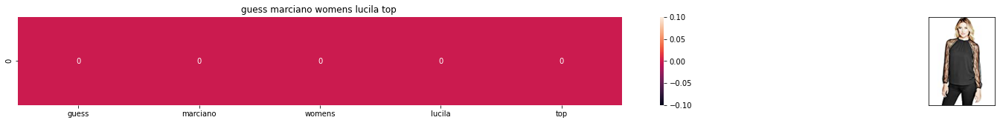

ASIN : B01LZ1BP80
Brand: GUESS by Marciano
Title: guess marciano womens lucila top 
Euclidean similarity with the query image : 4.242640687119285


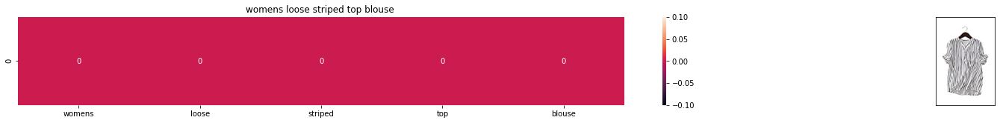

ASIN : B00ZZMYBRG
Brand: HP-LEISURE
Title: womens loose striped top blouse 
Euclidean similarity with the query image : 4.242640687119285


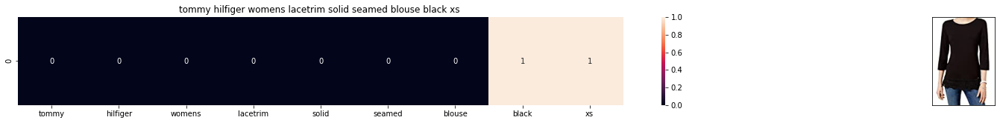

ASIN : B0759M7JYM
Brand: Tommy Hilfiger
Title: tommy hilfiger womens lacetrim solid seamed blouse black xs 
Euclidean similarity with the query image : 4.242640687119285


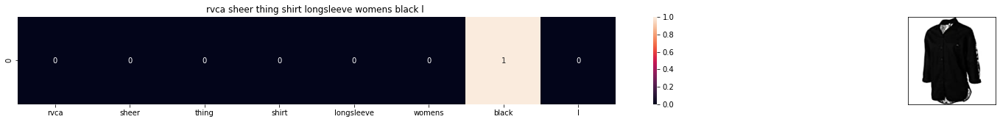

ASIN : B009WWL966
Brand: RVCA
Title: rvca sheer thing shirt longsleeve womens black l 
Euclidean similarity with the query image : 4.242640687119285


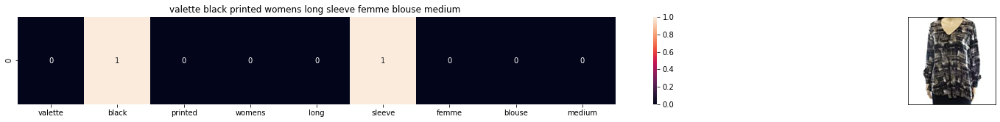

ASIN : B075817HX9
Brand: Valette
Title: valette black printed womens long sleeve femme blouse medium 
Euclidean similarity with the query image : 4.242640687119285


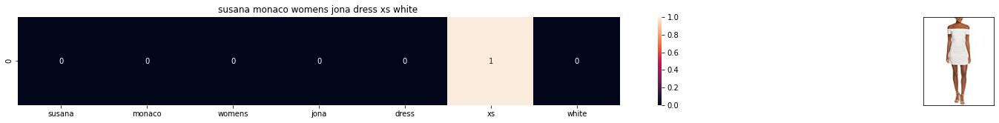

ASIN : B0753KQJ2H
Brand: susana monaco
Title: susana monaco womens jona dress xs white 
Euclidean similarity with the query image : 4.242640687119285


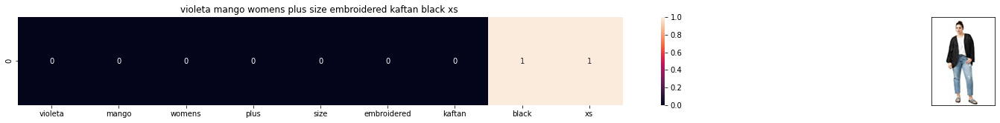

ASIN : B06Y2JPHRS
Brand: Violeta by MANGO
Title: violeta mango womens plus size embroidered kaftan black xs 
Euclidean similarity with the query image : 4.242640687119285


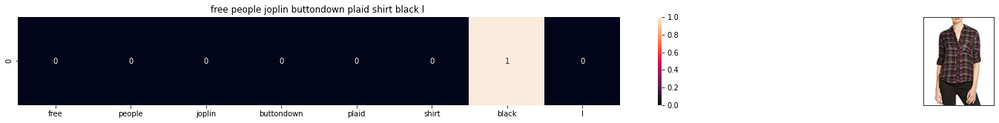

ASIN : B01MXHPJH4
Brand: Free People
Title: free people joplin buttondown plaid shirt black l 
Euclidean similarity with the query image : 4.242640687119285


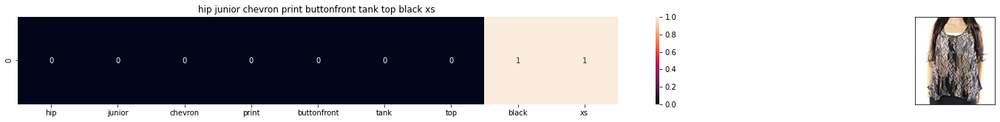

ASIN : B0716TC3YF
Brand: Hip
Title: hip junior chevron print buttonfront tank top black xs 
Euclidean similarity with the query image : 4.242640687119285


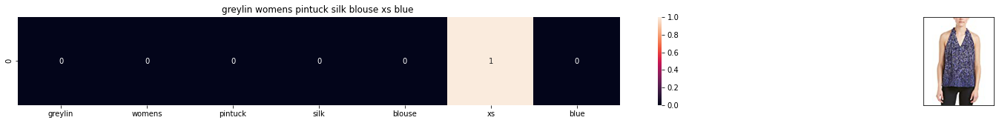

ASIN : B071XQWGSP
Brand: Greylin
Title: greylin womens pintuck silk blouse xs blue 
Euclidean similarity with the query image : 4.242640687119285


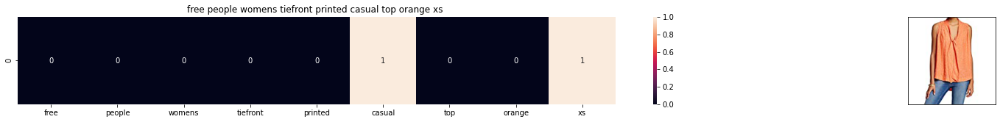

ASIN : B06X6H77F5
Brand: Free People
Title: free people womens tiefront printed casual top orange xs 
Euclidean similarity with the query image : 4.242640687119285


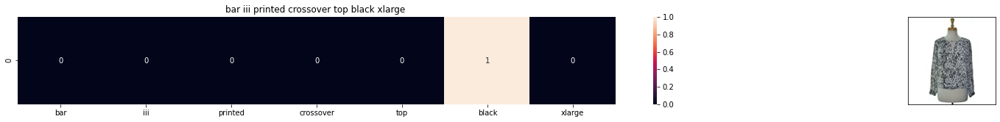

ASIN : B0751TJM3P
Brand: Bar III
Title: bar iii printed crossover top black xlarge 
Euclidean similarity with the query image : 4.242640687119285


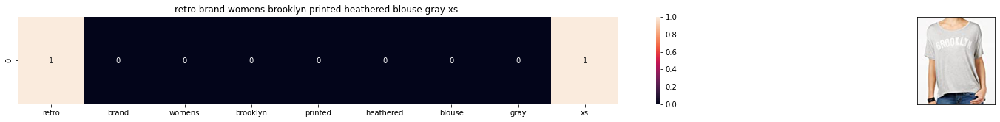

ASIN : B07574CKFL
Brand: Retro
Title: retro brand womens brooklyn printed heathered blouse gray xs 
Euclidean similarity with the query image : 4.242640687119285


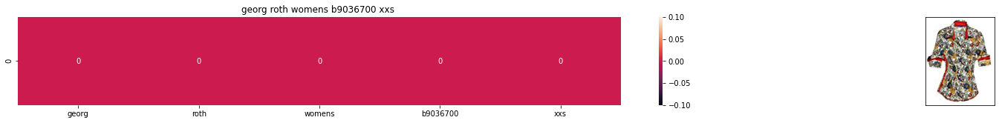

ASIN : B0189NUFTK
Brand: Georg Roth Los Angeles
Title: georg roth womens b9036700 xxs 
Euclidean similarity with the query image : 4.242640687119285


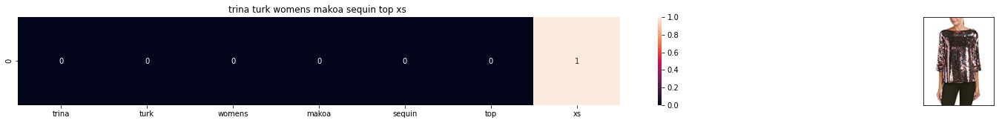

ASIN : B074F58H9Z
Brand: Trina Turk
Title: trina turk womens makoa sequin top xs 
Euclidean similarity with the query image : 4.242640687119285


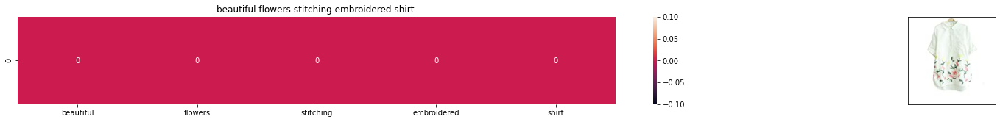

ASIN : B00WWMC56G
Brand: HP-LEISURE
Title: beautiful flowers stitching embroidered shirt 
Euclidean similarity with the query image : 4.242640687119285


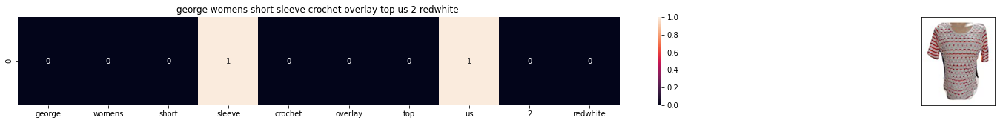

ASIN : B06XFLT65Y
Brand: George
Title: george womens short sleeve crochet overlay top us 2 redwhite 
Euclidean similarity with the query image : 4.242640687119285


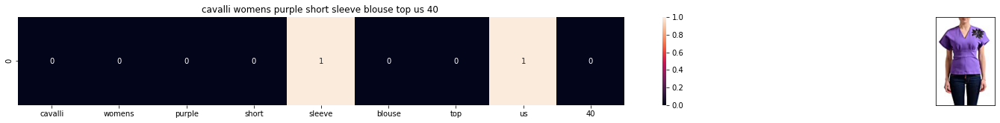

ASIN : B01CAU74LK
Brand: Just Cavalli
Title: cavalli womens purple short sleeve blouse top us 40 
Euclidean similarity with the query image : 4.242640687119285


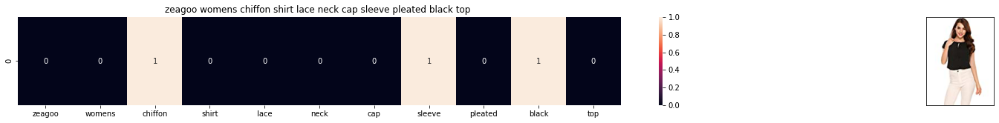

ASIN : B072MYLMVY
Brand: Zeagoo
Title: zeagoo womens chiffon shirt lace neck cap sleeve pleated black top 
Euclidean similarity with the query image : 4.242640687119285


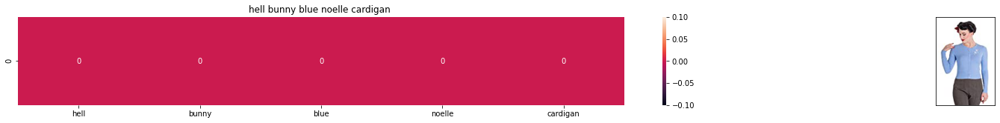

ASIN : B018STTAQY
Brand: Hell Bunny
Title: hell bunny blue noelle cardigan 
Euclidean similarity with the query image : 4.242640687119285


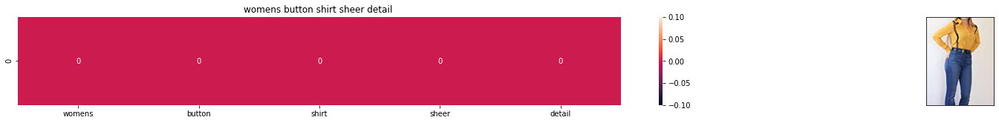

ASIN : B0756RHHHV
Brand: Have
Title: womens button shirt sheer detail 
Euclidean similarity with the query image : 4.242640687119285


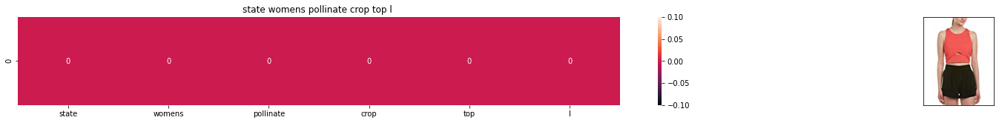

ASIN : B072R521WR
Brand: State of Being
Title: state womens pollinate crop top l 
Euclidean similarity with the query image : 4.242640687119285


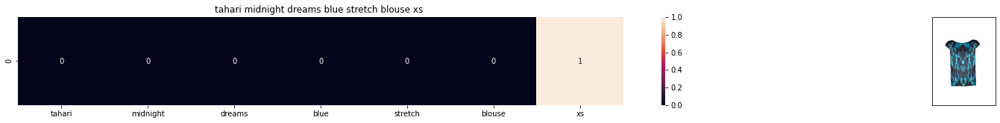

ASIN : B074VBVJ32
Brand: T Tahari
Title: tahari midnight dreams blue stretch blouse xs 
Euclidean similarity with the query image : 4.242640687119285


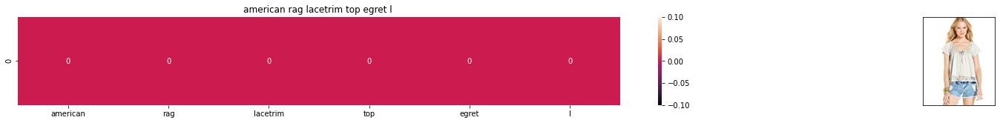

ASIN : B00ZDE97T8
Brand: American Rag
Title: american rag lacetrim top egret l 
Euclidean similarity with the query image : 4.242640687119285


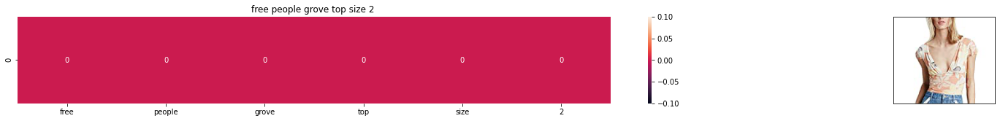

ASIN : B07282SM64
Brand: Free People
Title: free people grove top size 2 
Euclidean similarity with the query image : 4.242640687119285


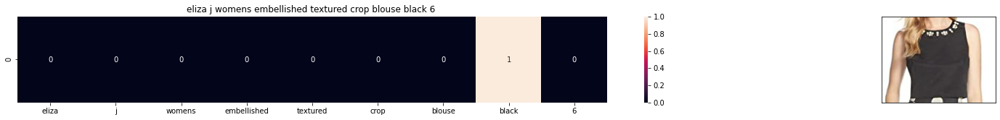

ASIN : B0757ZSHH3
Brand: Eliza J
Title: eliza j womens embellished textured crop blouse black 6 
Euclidean similarity with the query image : 4.242640687119285


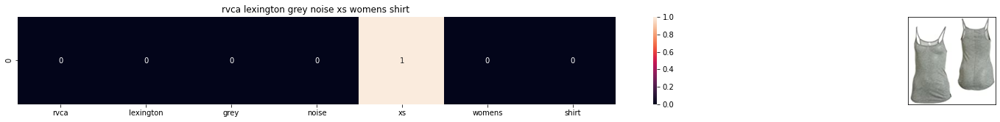

ASIN : B004TKDJBY
Brand: RVCA
Title: rvca lexington grey noise xs womens shirt 
Euclidean similarity with the query image : 4.242640687119285


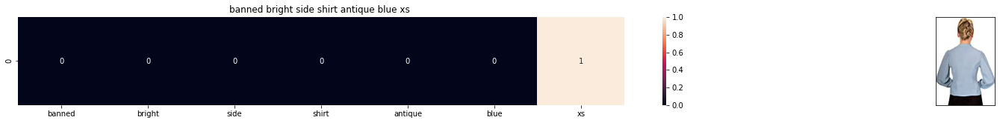

ASIN : B017NU1G6G
Brand: Banned
Title: banned bright side shirt antique blue xs 
Euclidean similarity with the query image : 4.242640687119285


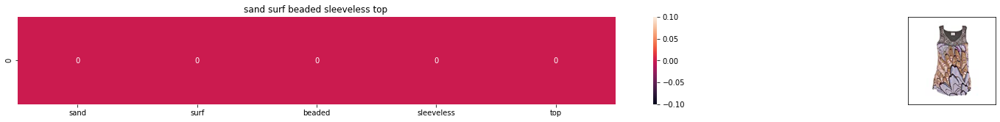

ASIN : B010MR64SC
Brand: GreaterGood
Title: sand surf beaded sleeveless top 
Euclidean similarity with the query image : 4.242640687119285


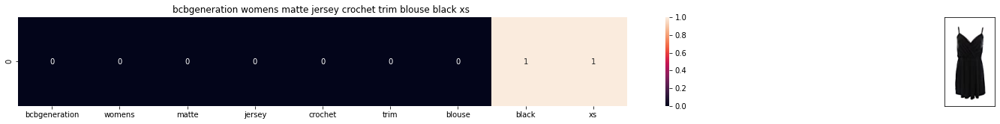

ASIN : B01EV7Q6UA
Brand: BCBGeneration
Title: bcbgeneration womens matte jersey crochet trim blouse black xs 
Euclidean similarity with the query image : 4.242640687119285


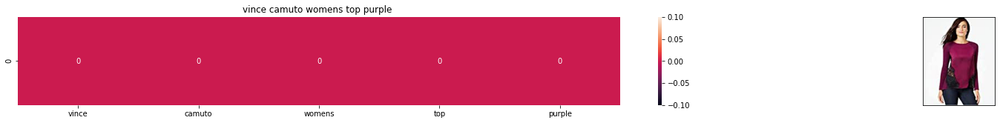

ASIN : B01LFVWUDC
Brand: Two by Vince Camuto
Title: vince camuto womens top purple 
Euclidean similarity with the query image : 4.242640687119285


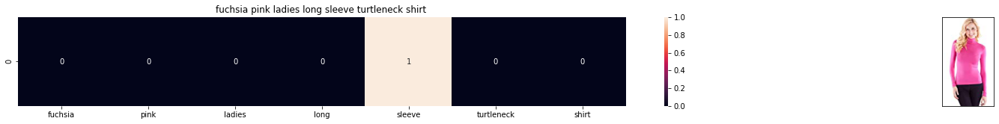

ASIN : B00EFG56Y0
Brand: Clothes Effect
Title: fuchsia pink ladies long sleeve turtleneck shirt 
Euclidean similarity with the query image : 4.242640687119285


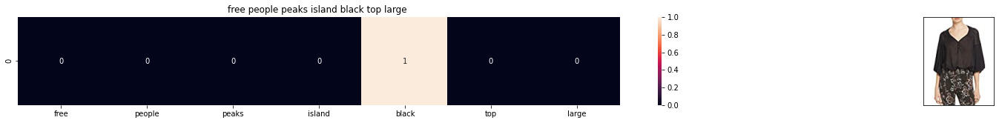

ASIN : B01M1OC0NX
Brand: Free People
Title: free people peaks island black top large 
Euclidean similarity with the query image : 4.242640687119285


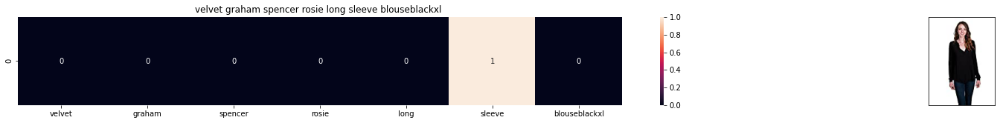

ASIN : B00JX13JIW
Brand: Velvet by Graham & Spencer
Title: velvet graham spencer rosie long sleeve blouseblackxl 
Euclidean similarity with the query image : 4.242640687119285


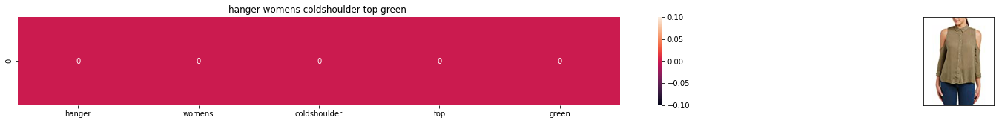

ASIN : B074F52Y28
Brand: The Hanger
Title: hanger womens coldshoulder top green 
Euclidean similarity with the query image : 4.242640687119285


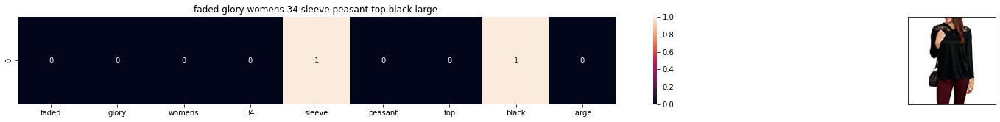

ASIN : B06XXHYBL6
Brand: Faded Glory
Title: faded glory womens 34 sleeve peasant top black large 
Euclidean similarity with the query image : 4.242640687119285


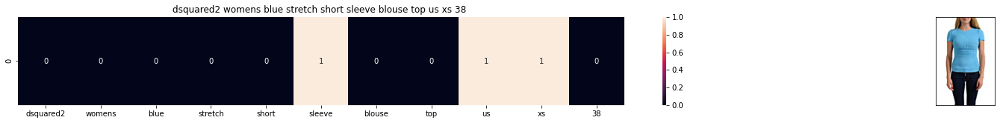

ASIN : B01L61XJ1I
Brand: DSQUARED2
Title: dsquared2 womens blue stretch short sleeve blouse top us xs 38 
Euclidean similarity with the query image : 4.242640687119285


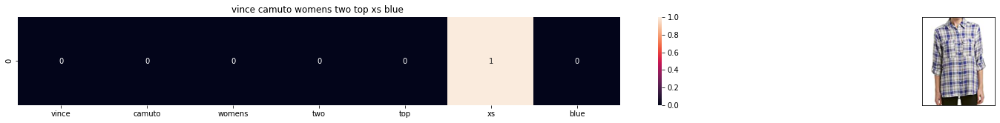

ASIN : B01N7BNEV4
Brand: Two by Vince Camuto
Title: vince camuto womens two top xs blue 
Euclidean similarity with the query image : 4.242640687119285


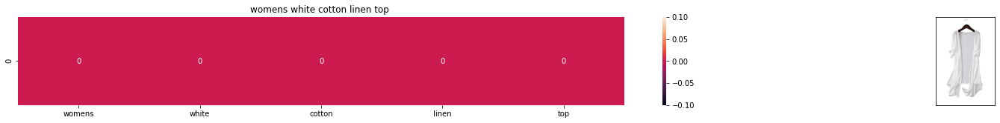

ASIN : B00ZZPR4Y0
Brand: HP-LEISURE
Title: womens white cotton linen top 
Euclidean similarity with the query image : 4.242640687119285


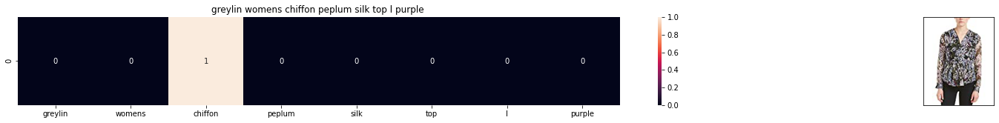

ASIN : B06XSG711M
Brand: Greylin
Title: greylin womens chiffon peplum silk top l purple 
Euclidean similarity with the query image : 4.242640687119285


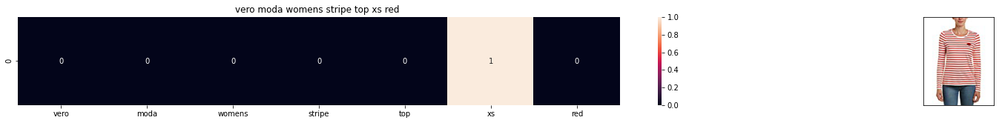

ASIN : B071GTYW32
Brand: VERO MODA
Title: vero moda womens stripe top xs red 
Euclidean similarity with the query image : 4.242640687119285


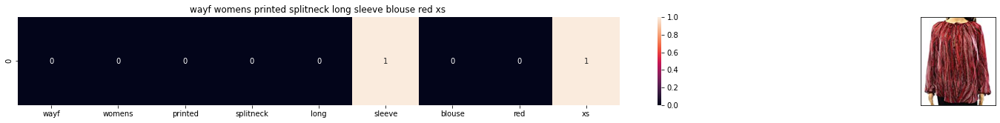

ASIN : B01GRY940Y
Brand: WAYF
Title: wayf womens printed splitneck long sleeve blouse red xs 
Euclidean similarity with the query image : 4.242640687119285


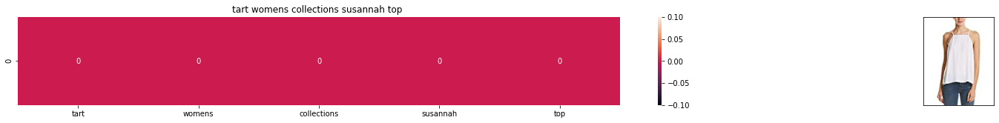

ASIN : B06ZYF6FPL
Brand: Tart Collections
Title: tart womens collections susannah top 
Euclidean similarity with the query image : 4.242640687119285


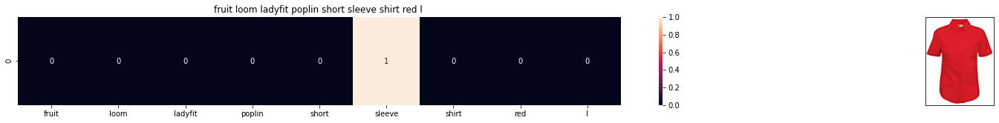

ASIN : B003ARIBQU
Brand: Fruit of the Loom
Title: fruit loom ladyfit poplin short sleeve shirt red l 
Euclidean similarity with the query image : 4.358898943540674


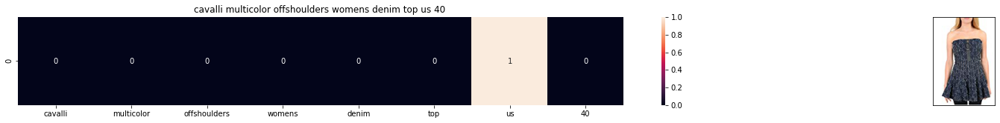

ASIN : B011SMFVVQ
Brand: Just Cavalli
Title: cavalli multicolor offshoulders womens denim top us 40 
Euclidean similarity with the query image : 4.358898943540674


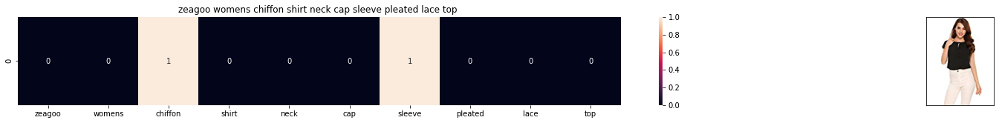

ASIN : B072KCRTKK
Brand: Zeagoo
Title: zeagoo womens chiffon shirt neck cap sleeve pleated lace top 
Euclidean similarity with the query image : 4.358898943540674


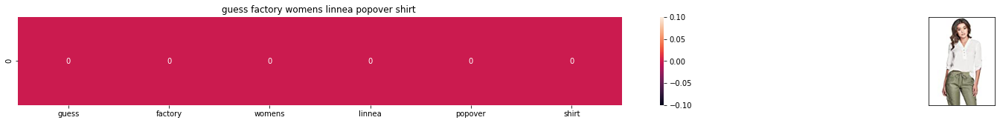

ASIN : B06XJ1XHWF
Brand: G by GUESS
Title: guess factory womens linnea popover shirt 
Euclidean similarity with the query image : 4.358898943540674


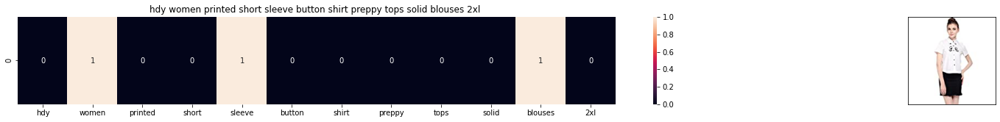

ASIN : B01M9C24GM
Brand: WeHeart
Title: hdy women printed short sleeve button shirt preppy tops solid blouses 2xl 
Euclidean similarity with the query image : 4.358898943540674


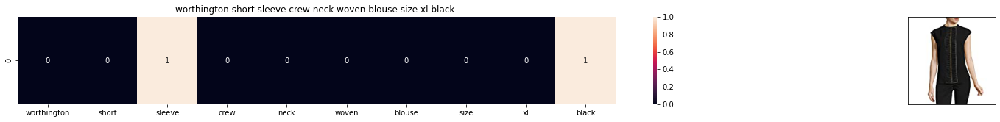

ASIN : B073MPS3TQ
Brand: Worthington
Title: worthington short sleeve crew neck woven blouse size xl black 
Euclidean similarity with the query image : 4.358898943540674


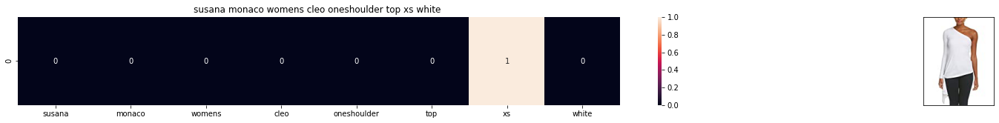

ASIN : B0753K3549
Brand: susana monaco
Title: susana monaco womens cleo oneshoulder top xs white 
Euclidean similarity with the query image : 4.358898943540674


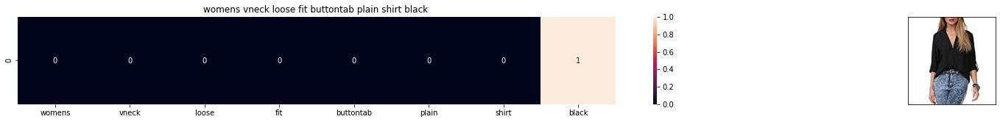

ASIN : B01DOWXEUI
Brand: Generic
Title: womens vneck loose fit buttontab plain shirt black 
Euclidean similarity with the query image : 4.358898943540674


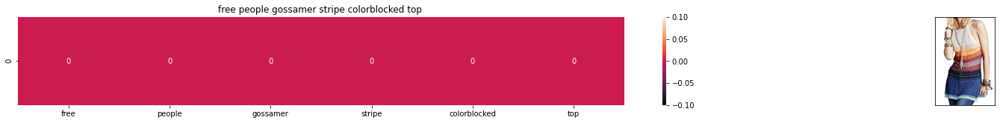

ASIN : B06XG47XYD
Brand: Free People
Title: free people gossamer stripe colorblocked top 
Euclidean similarity with the query image : 4.358898943540674


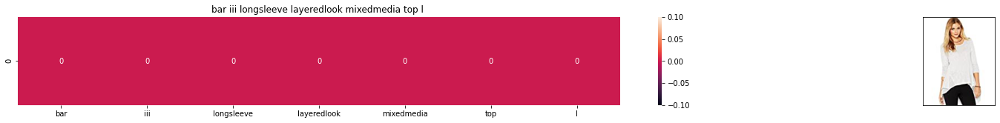

ASIN : B071SG3RT6
Brand: Bar III
Title: bar iii longsleeve layeredlook mixedmedia top l 
Euclidean similarity with the query image : 4.358898943540674


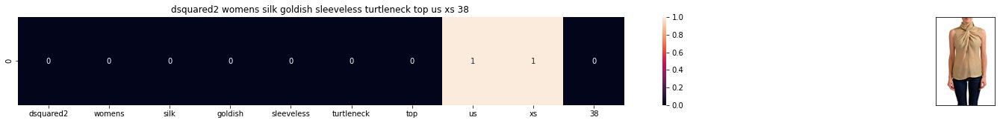

ASIN : B01LBAY4KE
Brand: DSQUARED2
Title: dsquared2 womens silk goldish sleeveless turtleneck top us xs 38 
Euclidean similarity with the query image : 4.358898943540674


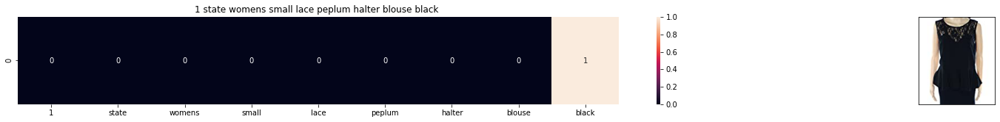

ASIN : B072XN45H5
Brand: 1.State
Title: 1 state womens small lace peplum halter blouse black 
Euclidean similarity with the query image : 4.358898943540674


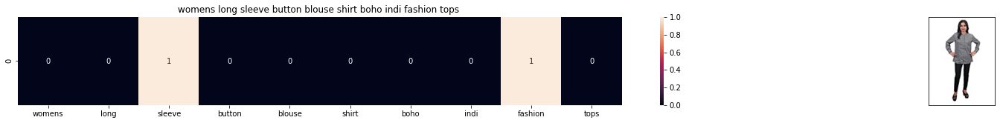

ASIN : B012WGJT6A
Brand: Mogul Interior
Title: womens long sleeve button blouse shirt boho indi fashion tops 
Euclidean similarity with the query image : 4.358898943540674


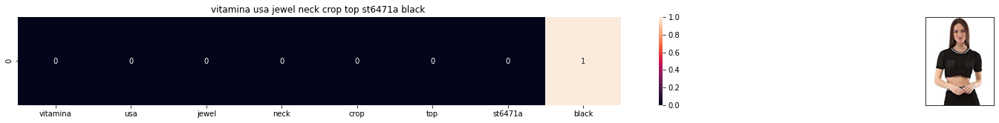

ASIN : B011WFBG0E
Brand: Vitamina USA
Title: vitamina usa jewel neck crop top st6471a black 
Euclidean similarity with the query image : 4.358898943540674


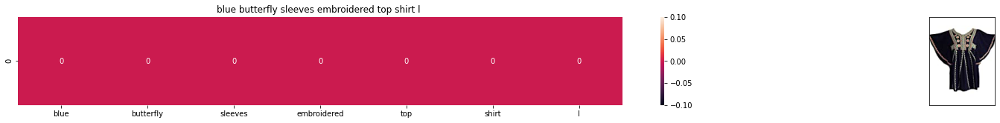

ASIN : B01EXCAGBI
Brand: Sacred Threads Sample/Lobo Tag
Title: blue butterfly sleeves embroidered top shirt l 
Euclidean similarity with the query image : 4.358898943540674


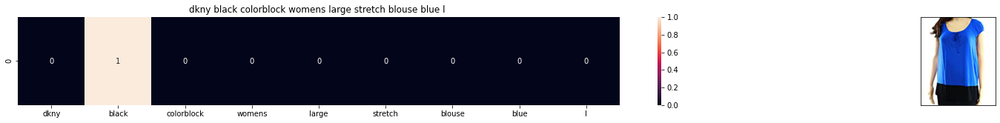

ASIN : B01MRCQ30S
Brand: DKNY
Title: dkny black colorblock womens large stretch blouse blue l 
Euclidean similarity with the query image : 4.358898943540674


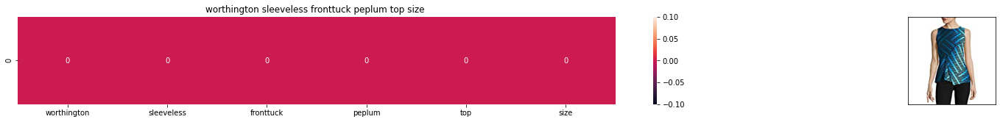

ASIN : B072JQXGT4
Brand: Worthington
Title: worthington sleeveless fronttuck peplum top size 
Euclidean similarity with the query image : 4.358898943540674


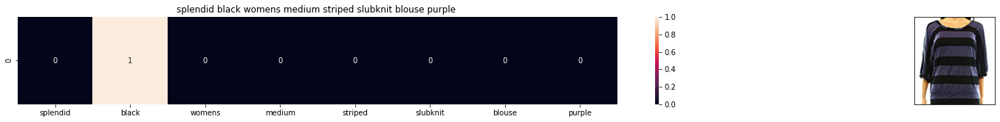

ASIN : B074T32Q3N
Brand: Splendid
Title: splendid black womens medium striped slubknit blouse purple 
Euclidean similarity with the query image : 4.358898943540674


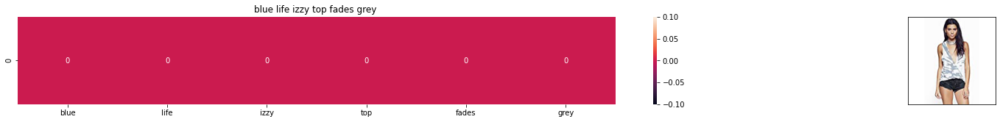

ASIN : B0757856HY
Brand: Blue Life
Title: blue life izzy top fades grey 
Euclidean similarity with the query image : 4.358898943540674


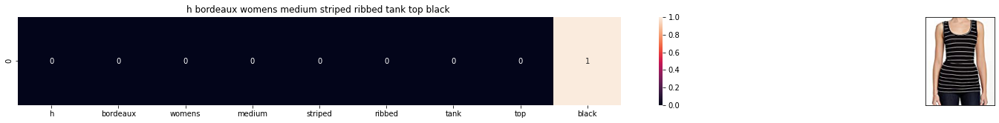

ASIN : B07574D8KQ
Brand: H By Bordeaux
Title: h bordeaux womens medium striped ribbed tank top black 
Euclidean similarity with the query image : 4.358898943540674


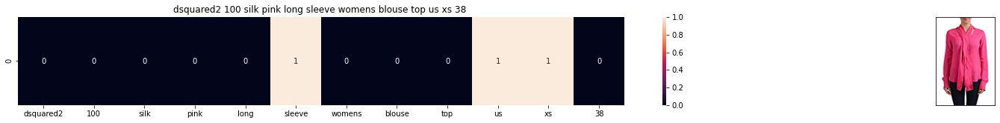

ASIN : B01M087PQ5
Brand: DSQUARED2
Title: dsquared2 100 silk pink long sleeve womens blouse top us xs 38 
Euclidean similarity with the query image : 4.358898943540674


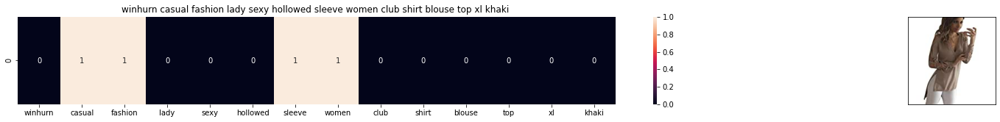

ASIN : B01NAFTMGN
Brand: Winhurn
Title: winhurn casual fashion lady sexy hollowed sleeve women club shirt blouse top xl khaki 
Euclidean similarity with the query image : 4.358898943540674


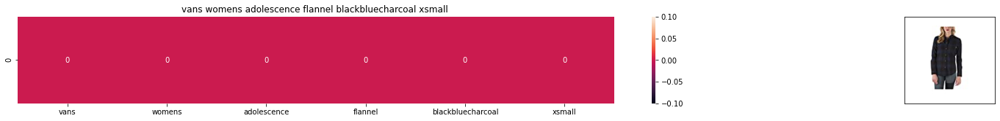

ASIN : B00WRY6UKQ
Brand: Vans
Title: vans womens adolescence flannel blackbluecharcoal xsmall 
Euclidean similarity with the query image : 4.358898943540674


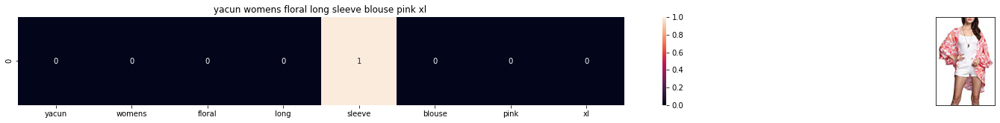

ASIN : B06XFWP2V1
Brand: Yacun
Title: yacun womens floral long sleeve blouse pink xl 
Euclidean similarity with the query image : 4.358898943540674


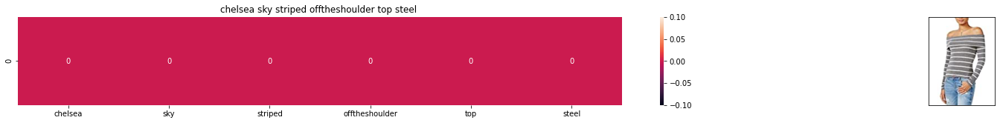

ASIN : B072MJHVHC
Brand: Chelsea Sky
Title: chelsea sky striped offtheshoulder top steel 
Euclidean similarity with the query image : 4.358898943540674


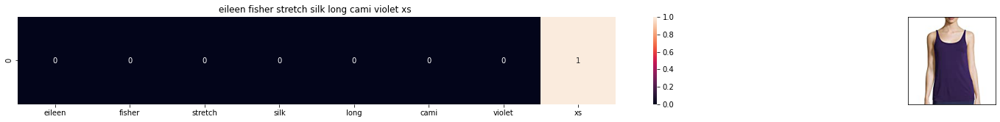

ASIN : B01LY34YPS
Brand: VERO MODA
Title: eileen fisher stretch silk long cami violet xs 
Euclidean similarity with the query image : 4.358898943540674


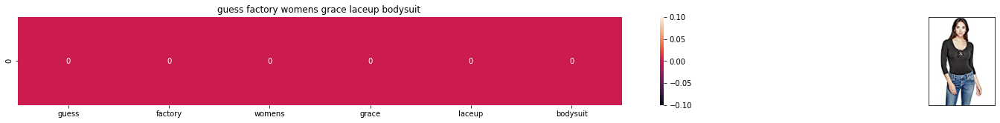

ASIN : B01MG8VVD1
Brand: G by GUESS
Title: guess factory womens grace laceup bodysuit 
Euclidean similarity with the query image : 4.358898943540674


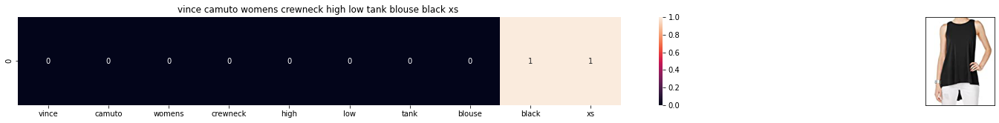

ASIN : B071LMW7K8
Brand: Vince Camuto
Title: vince camuto womens crewneck high low tank blouse black xs 
Euclidean similarity with the query image : 4.358898943540674


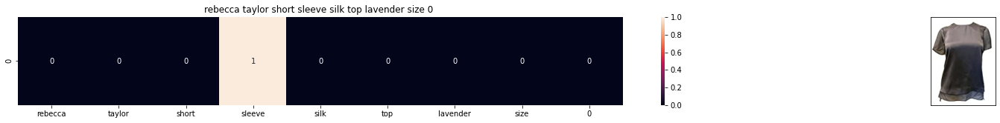

ASIN : B06X9Y8SQF
Brand: Rebecca Taylor
Title: rebecca taylor short sleeve silk top lavender size 0 
Euclidean similarity with the query image : 4.358898943540674


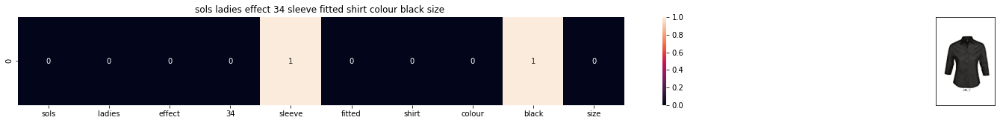

ASIN : B00D5VPZ1K
Brand: SOL'S
Title: sols ladies effect 34 sleeve fitted shirt colour black size 
Euclidean similarity with the query image : 4.358898943540674


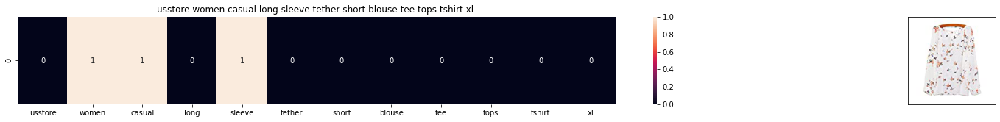

ASIN : B01F0X7ZUE
Brand: Usstore
Title: usstore women casual long sleeve tether short blouse tee tops tshirt xl 
Euclidean similarity with the query image : 4.358898943540674


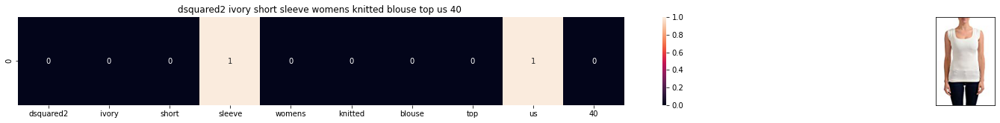

ASIN : B01LZX5EQB
Brand: DSQUARED2
Title: dsquared2 ivory short sleeve womens knitted blouse top us 40 
Euclidean similarity with the query image : 4.358898943540674


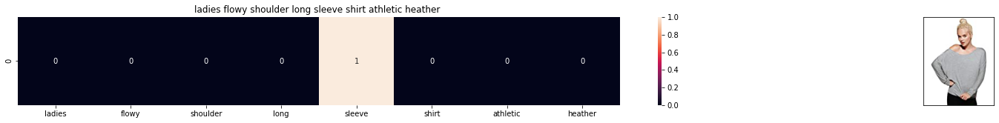

ASIN : B00BR9I62W
Brand: Bella
Title: ladies flowy shoulder long sleeve shirt athletic heather 
Euclidean similarity with the query image : 4.358898943540674


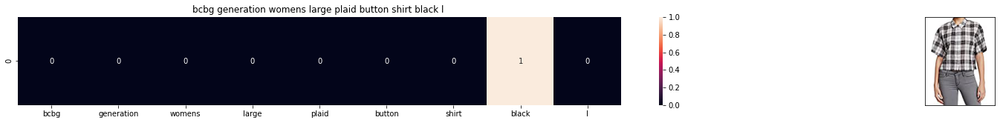

ASIN : B072XL7MTT
Brand: BCBGeneration
Title: bcbg generation womens large plaid button shirt black l 
Euclidean similarity with the query image : 4.358898943540674


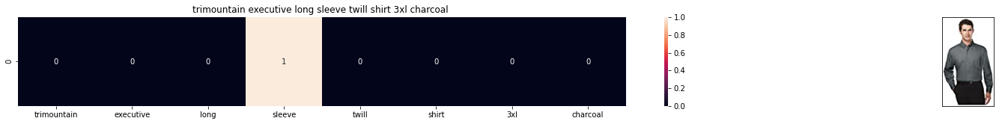

ASIN : B000RZ4X7Y
Brand: Tri-Mountain
Title: trimountain executive long sleeve twill shirt 3xl charcoal 
Euclidean similarity with the query image : 4.358898943540674


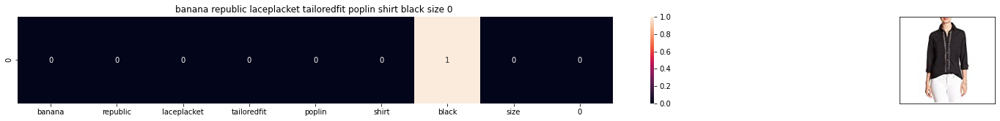

ASIN : B009JTYX9C
Brand: Banana Republic
Title: banana republic laceplacket tailoredfit poplin shirt black size 0 
Euclidean similarity with the query image : 4.358898943540674


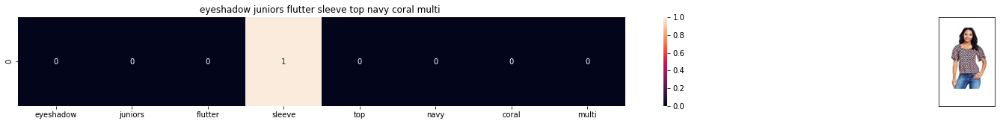

ASIN : B071V697JD
Brand: Eyeshadow
Title: eyeshadow juniors flutter sleeve top navy coral multi 
Euclidean similarity with the query image : 4.358898943540674


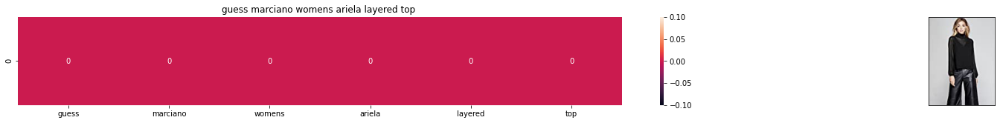

ASIN : B01LETT1IW
Brand: GUESS by Marciano
Title: guess marciano womens ariela layered top 
Euclidean similarity with the query image : 4.358898943540674


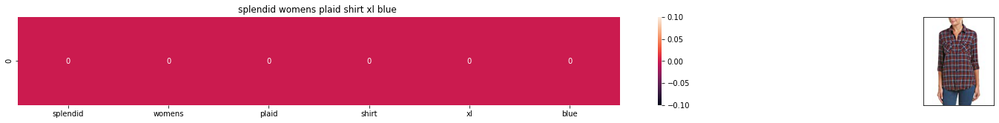

ASIN : B072KNKP98
Brand: Splendid
Title: splendid womens plaid shirt xl blue 
Euclidean similarity with the query image : 4.358898943540674


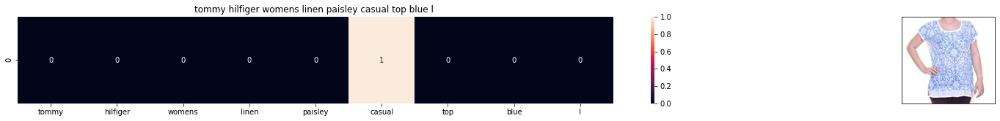

ASIN : B06WLHTS8S
Brand: Tommy Hilfiger
Title: tommy hilfiger womens linen paisley casual top blue l 
Euclidean similarity with the query image : 4.358898943540674


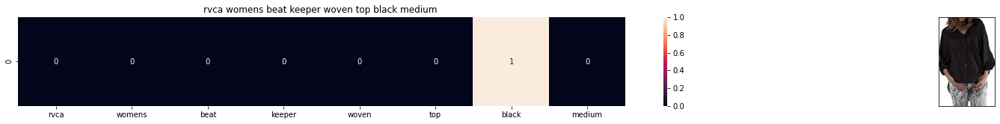

ASIN : B007SNTDGO
Brand: RVCA
Title: rvca womens beat keeper woven top black medium 
Euclidean similarity with the query image : 4.358898943540674


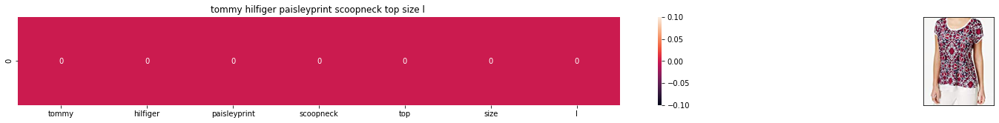

ASIN : B06WVPTCGF
Brand: Tommy Hilfiger
Title: tommy hilfiger paisleyprint scoopneck top size l 
Euclidean similarity with the query image : 4.358898943540674


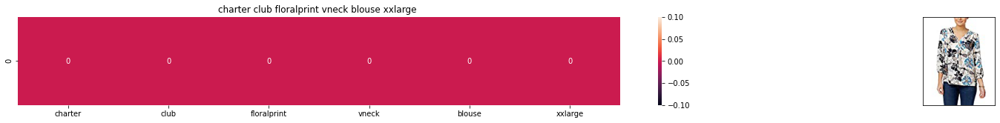

ASIN : B074YZKQ8C
Brand: Charter Club
Title: charter club floralprint vneck blouse xxlarge 
Euclidean similarity with the query image : 4.358898943540674


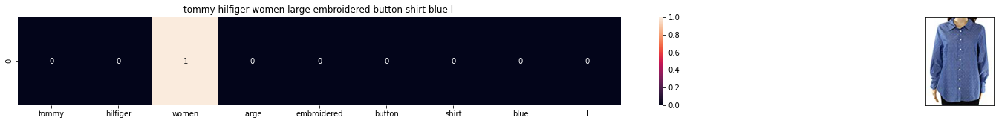

ASIN : B0759NH3ZR
Brand: Tommy Hilfiger
Title: tommy hilfiger women large embroidered button shirt blue l 
Euclidean similarity with the query image : 4.358898943540674


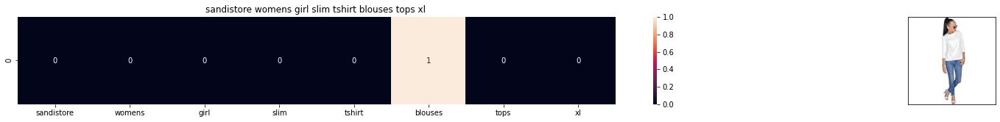

ASIN : B00ZKZBEOQ
Brand: Sandistore
Title: sandistore womens girl slim tshirt blouses tops xl 
Euclidean similarity with the query image : 4.358898943540674


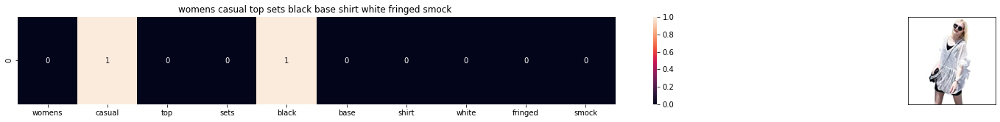

ASIN : B011TOPBRC
Brand: HP-LEISURE
Title: womens casual top sets black base shirt white fringed smock 
Euclidean similarity with the query image : 4.358898943540674


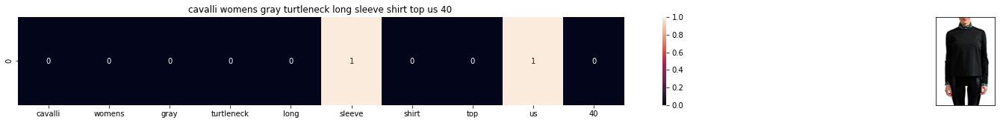

ASIN : B01C5UDSQU
Brand: Just Cavalli
Title: cavalli womens gray turtleneck long sleeve shirt top us 40 
Euclidean similarity with the query image : 4.358898943540674


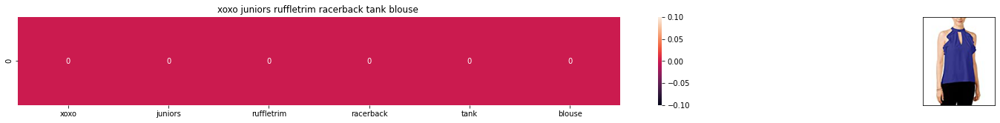

ASIN : B07257NZSM
Brand: XOXO
Title: xoxo juniors ruffletrim racerback tank blouse 
Euclidean similarity with the query image : 4.358898943540674


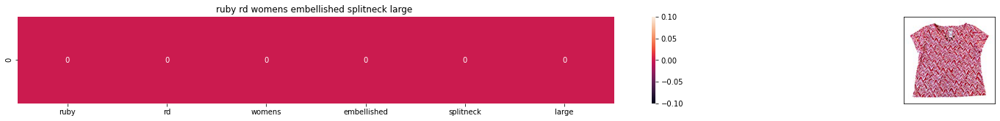

ASIN : B071LF1JYW
Brand: Ruby Rd.
Title: ruby rd womens embellished splitneck large 
Euclidean similarity with the query image : 4.358898943540674


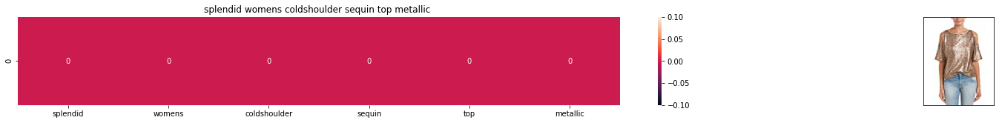

ASIN : B0721T56TS
Brand: Splendid
Title: splendid womens coldshoulder sequin top metallic 
Euclidean similarity with the query image : 4.358898943540674


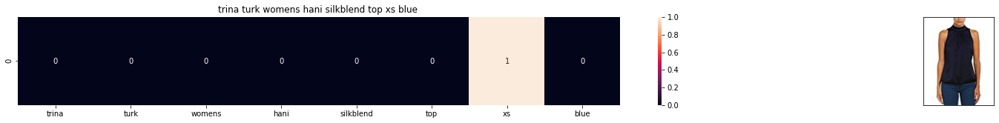

ASIN : B07575F1NR
Brand: Trina Turk
Title: trina turk womens hani silkblend top xs blue 
Euclidean similarity with the query image : 4.358898943540674


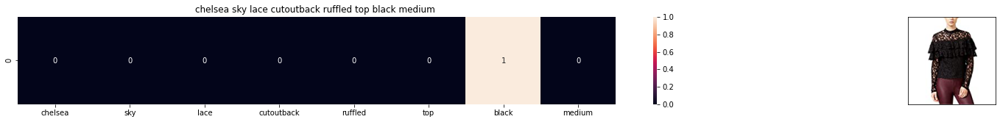

ASIN : B074KGKZG9
Brand: Chelsea Sky
Title: chelsea sky lace cutoutback ruffled top black medium 
Euclidean similarity with the query image : 4.358898943540674


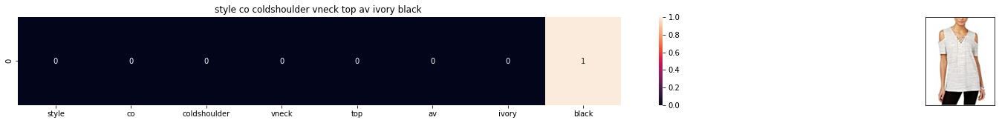

ASIN : B01N4UC11Z
Brand: Style & Co.
Title: style co coldshoulder vneck top av ivory black 
Euclidean similarity with the query image : 4.358898943540674


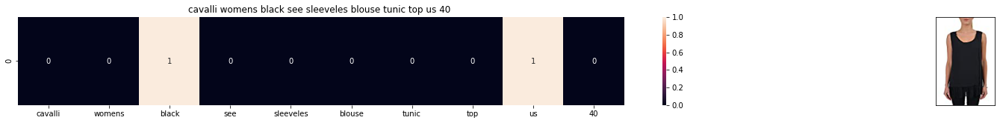

ASIN : B0175AYXG4
Brand: Just Cavalli
Title: cavalli womens black see sleeveles blouse tunic top us 40 
Euclidean similarity with the query image : 4.358898943540674


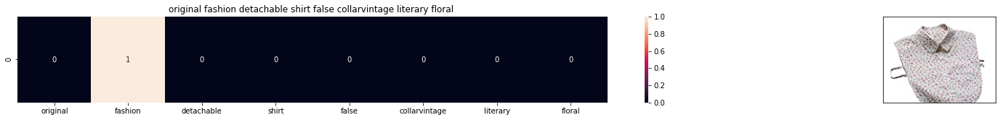

ASIN : B00WSIF0Y8
Brand: Black Temptation
Title: original fashion detachable shirt false collarvintage literary floral 
Euclidean similarity with the query image : 4.358898943540674


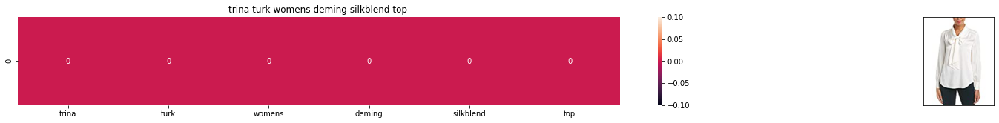

ASIN : B074TF25Q3
Brand: Trina Turk
Title: trina turk womens deming silkblend top 
Euclidean similarity with the query image : 4.358898943540674


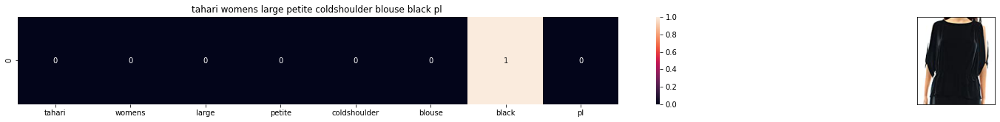

ASIN : B0714JZFLY
Brand: T Tahari
Title: tahari womens large petite coldshoulder blouse black pl 
Euclidean similarity with the query image : 4.358898943540674


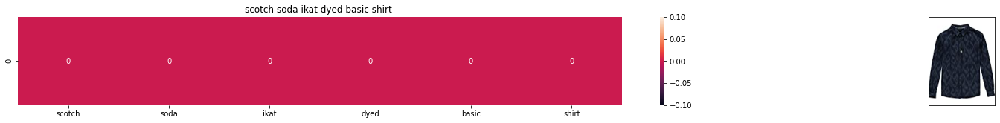

ASIN : B01H5K81JE
Brand: Scotch & Soda
Title: scotch soda ikat dyed basic shirt 
Euclidean similarity with the query image : 4.358898943540674


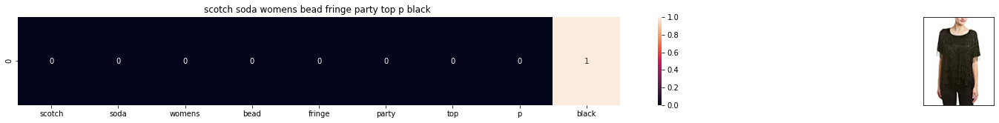

ASIN : B01N3S8EZN
Brand: Scotch & Soda
Title: scotch soda womens bead fringe party top p black 
Euclidean similarity with the query image : 4.358898943540674


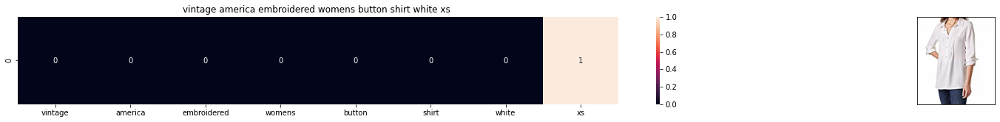

ASIN : B01LYEG8DN
Brand: Vintage America
Title: vintage america embroidered womens button shirt white xs 
Euclidean similarity with the query image : 4.358898943540674


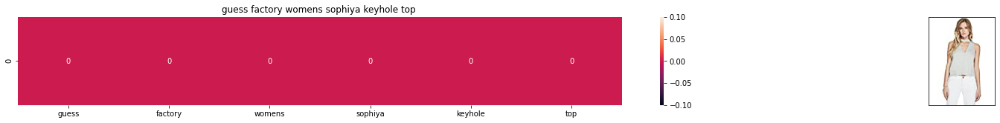

ASIN : B0714CXPTN
Brand: G by GUESS
Title: guess factory womens sophiya keyhole top 
Euclidean similarity with the query image : 4.358898943540674


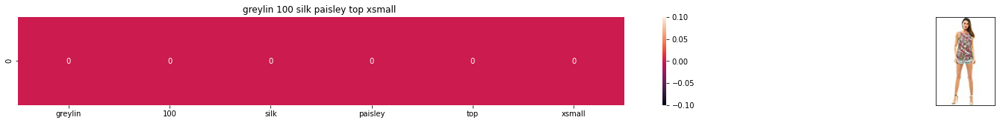

ASIN : B01FY8NM6G
Brand: Greylin
Title: greylin 100 silk paisley top xsmall 
Euclidean similarity with the query image : 4.358898943540674


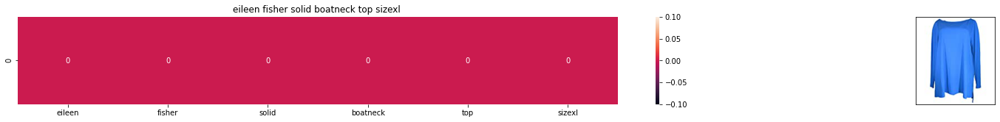

ASIN : B07175QZVB
Brand: Eileen Fisher
Title: eileen fisher solid boatneck top sizexl 
Euclidean similarity with the query image : 4.358898943540674


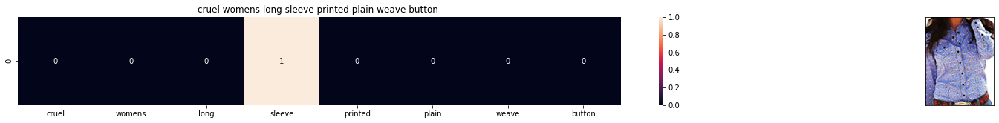

ASIN : B00TQ3XY8C
Brand: Cruel
Title: cruel womens long sleeve printed plain weave button 
Euclidean similarity with the query image : 4.358898943540674


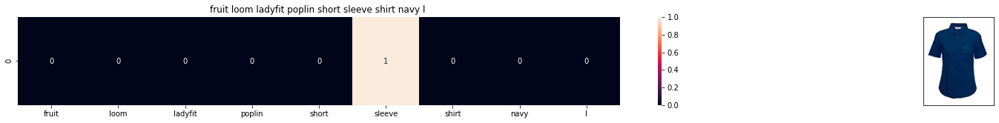

ASIN : B004X5EKFE
Brand: Fruit of the Loom
Title: fruit loom ladyfit poplin short sleeve shirt navy l 
Euclidean similarity with the query image : 4.358898943540674


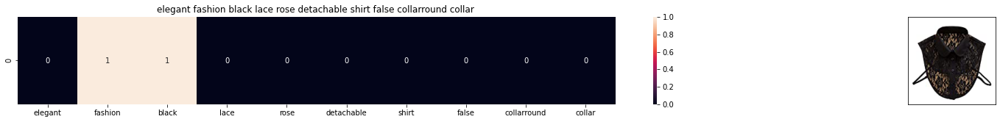

ASIN : B00WNVE1WC
Brand: Black Temptation
Title: elegant fashion black lace rose detachable shirt false collarround collar 
Euclidean similarity with the query image : 4.358898943540674


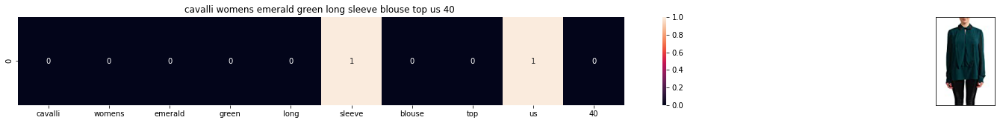

ASIN : B01C4TUONC
Brand: Just Cavalli
Title: cavalli womens emerald green long sleeve blouse top us 40 
Euclidean similarity with the query image : 4.358898943540674


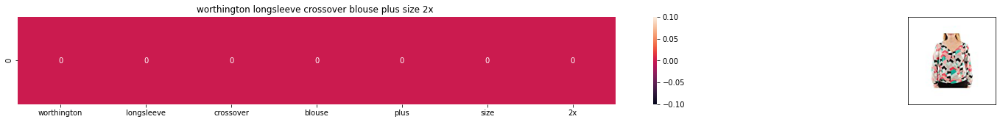

ASIN : B071FYY5JJ
Brand: Worthington
Title: worthington longsleeve crossover blouse plus size 2x 
Euclidean similarity with the query image : 4.47213595499958


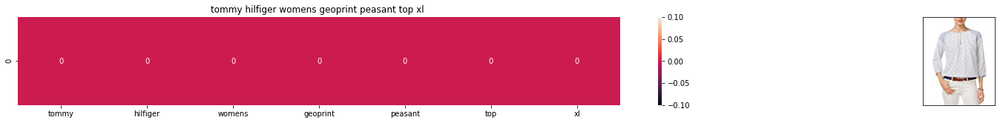

ASIN : B0727RMYTM
Brand: Tommy Hilfiger
Title: tommy hilfiger womens geoprint peasant top xl 
Euclidean similarity with the query image : 4.47213595499958


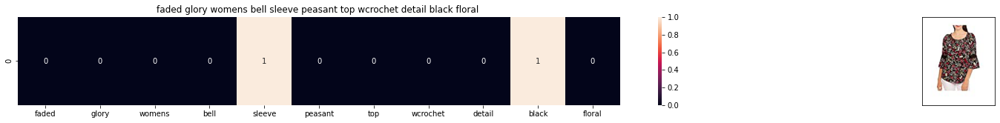

ASIN : B06WW8S6WL
Brand: Faded Glory
Title: faded glory womens bell sleeve peasant top wcrochet detail black floral 
Euclidean similarity with the query image : 4.47213595499958


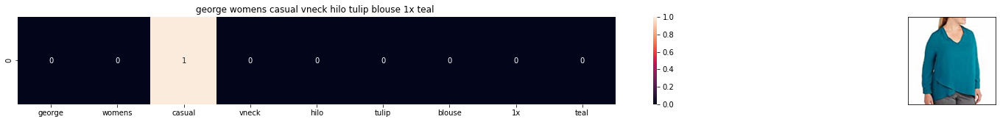

ASIN : B06ZZBQWTN
Brand: George
Title: george womens casual vneck hilo tulip blouse 1x teal 
Euclidean similarity with the query image : 4.47213595499958


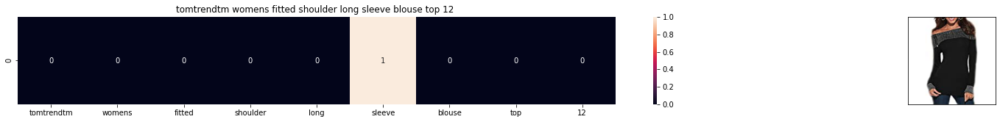

ASIN : B01A5MR31G
Brand: Tom_trend
Title: tomtrendtm womens fitted shoulder long sleeve blouse top 12 
Euclidean similarity with the query image : 4.47213595499958


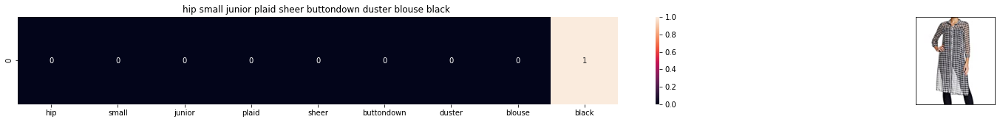

ASIN : B07582L1MH
Brand: Hip
Title: hip small junior plaid sheer buttondown duster blouse black 
Euclidean similarity with the query image : 4.47213595499958


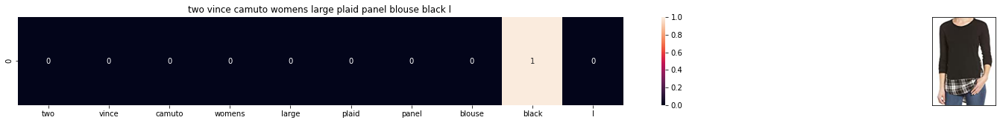

ASIN : B0757YRT74
Brand: Two by Vince Camuto
Title: two vince camuto womens large plaid panel blouse black l 
Euclidean similarity with the query image : 4.47213595499958


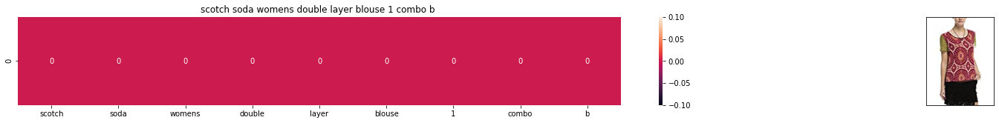

ASIN : B0154XUOEO
Brand: Scotch & Soda
Title: scotch soda womens double layer blouse 1 combo b 
Euclidean similarity with the query image : 4.47213595499958


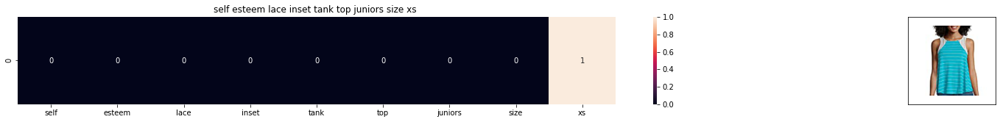

ASIN : B01N2MN3M7
Brand: Self Esteem
Title: self esteem lace inset tank top juniors size xs 
Euclidean similarity with the query image : 4.47213595499958


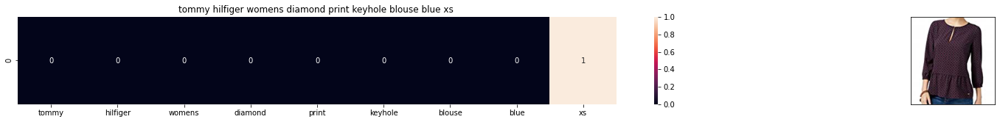

ASIN : B0759QV89G
Brand: Tommy Hilfiger
Title: tommy hilfiger womens diamond print keyhole blouse blue xs 
Euclidean similarity with the query image : 4.47213595499958


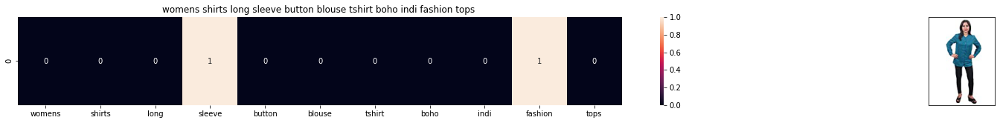

ASIN : B012WI5FES
Brand: Mogul Interior
Title: womens shirts long sleeve button blouse tshirt boho indi fashion tops 
Euclidean similarity with the query image : 4.47213595499958


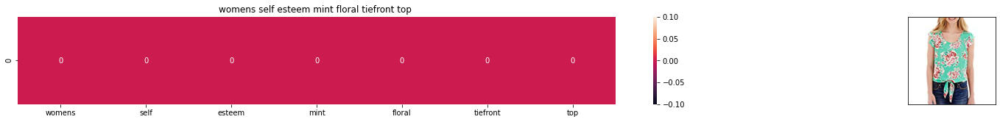

ASIN : B00XC0CJU4
Brand: Self Esteem
Title: womens self esteem mint floral tiefront top 
Euclidean similarity with the query image : 4.47213595499958


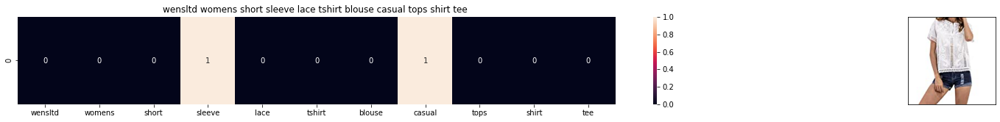

ASIN : B06W2LXT6G
Brand: WensLTD
Title: wensltd womens short sleeve lace tshirt blouse casual tops shirt tee 
Euclidean similarity with the query image : 4.47213595499958


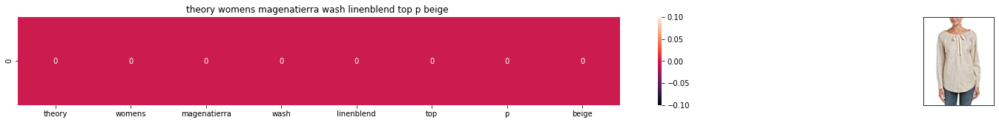

ASIN : B0743KSJV5
Brand: Theory
Title: theory womens magenatierra wash linenblend top p beige 
Euclidean similarity with the query image : 4.47213595499958


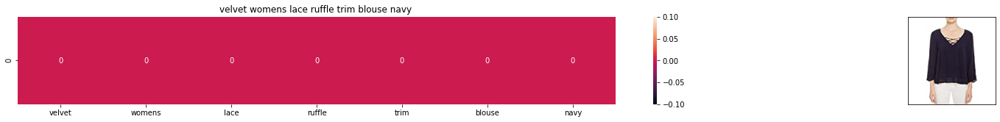

ASIN : B06XCZGQLP
Brand: Velvet by Graham & Spencer
Title: velvet womens lace ruffle trim blouse navy 
Euclidean similarity with the query image : 4.47213595499958


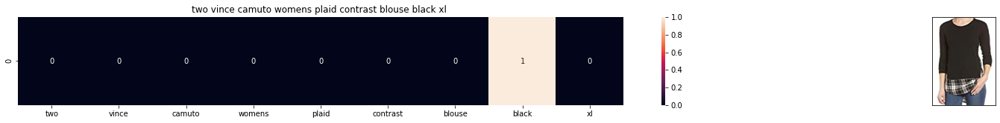

ASIN : B075834CRB
Brand: Two by Vince Camuto
Title: two vince camuto womens plaid contrast blouse black xl 
Euclidean similarity with the query image : 4.47213595499958


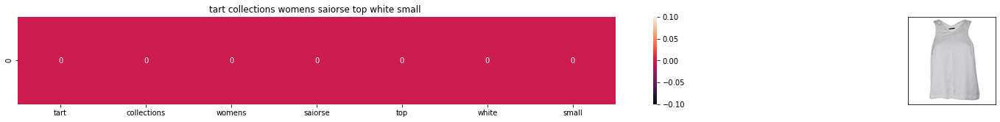

ASIN : B072BJJM47
Brand: Tart Collections
Title: tart collections womens saiorse top white small 
Euclidean similarity with the query image : 4.47213595499958


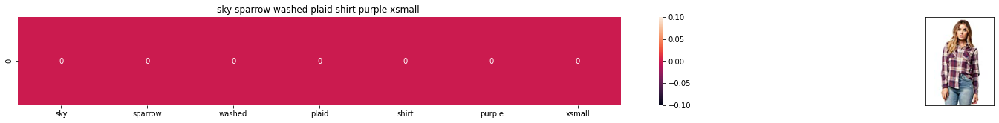

ASIN : B0745PVMTF
Brand: Sky and Sparrow
Title: sky sparrow washed plaid shirt purple xsmall 
Euclidean similarity with the query image : 4.47213595499958


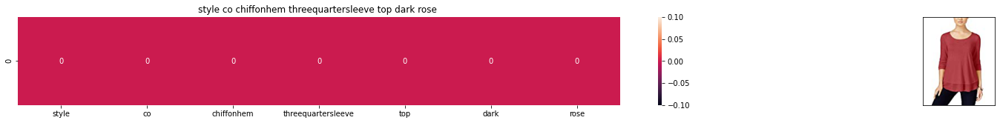

ASIN : B06Y1TQB81
Brand: Style & Co.
Title: style co chiffonhem threequartersleeve top dark rose 
Euclidean similarity with the query image : 4.47213595499958


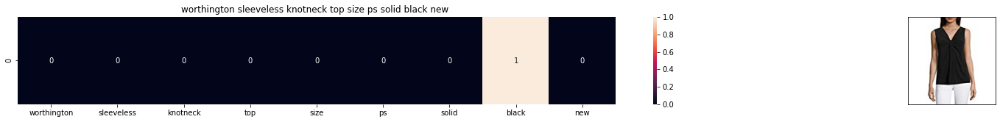

ASIN : B0756S7FMV
Brand: Worthington
Title: worthington sleeveless knotneck top size ps solid black new 
Euclidean similarity with the query image : 4.47213595499958


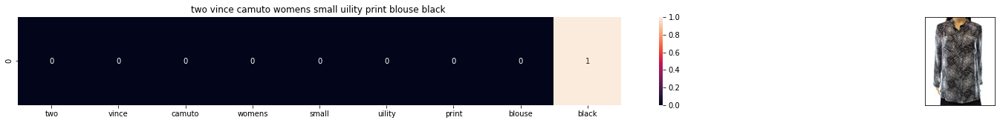

ASIN : B074VCCRYZ
Brand: Two by Vince Camuto
Title: two vince camuto womens small uility print blouse black 
Euclidean similarity with the query image : 4.47213595499958


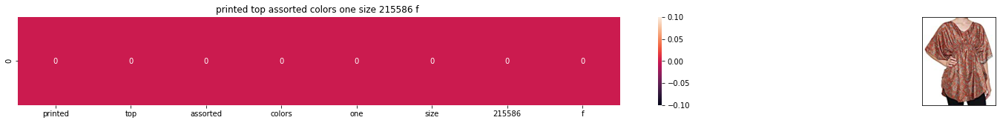

ASIN : B01AVN178O
Brand: Sacred Threads
Title: printed top assorted colors one size 215586 f 
Euclidean similarity with the query image : 4.47213595499958


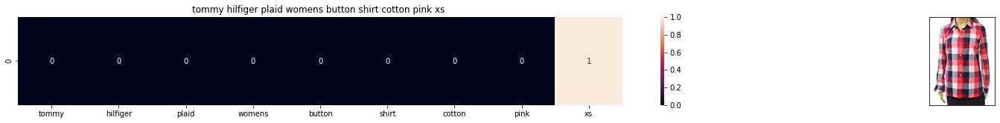

ASIN : B0759V9R3K
Brand: Tommy Hilfiger
Title: tommy hilfiger plaid womens button shirt cotton pink xs 
Euclidean similarity with the query image : 4.47213595499958


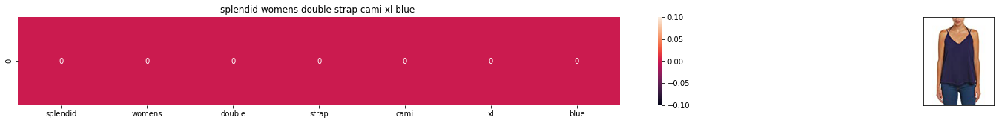

ASIN : B0746STR6M
Brand: Splendid
Title: splendid womens double strap cami xl blue 
Euclidean similarity with the query image : 4.47213595499958


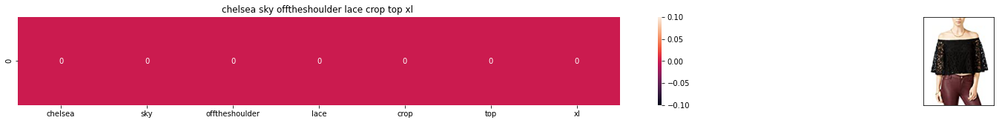

ASIN : B0722Y4FG9
Brand: chelsea sky
Title: chelsea sky offtheshoulder lace crop top xl 
Euclidean similarity with the query image : 4.47213595499958


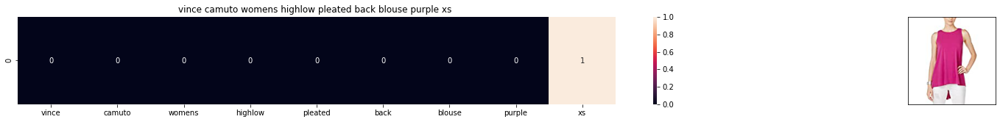

ASIN : B071KZ2PGN
Brand: Vince Camuto
Title: vince camuto womens highlow pleated back blouse purple xs 
Euclidean similarity with the query image : 4.47213595499958


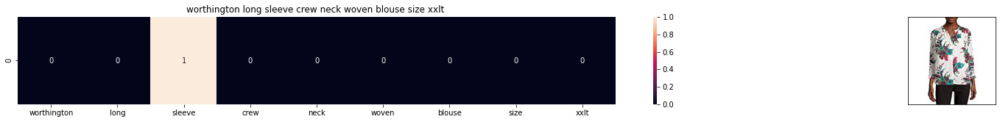

ASIN : B073MQDFVF
Brand: Worthington
Title: worthington long sleeve crew neck woven blouse size xxlt 
Euclidean similarity with the query image : 4.47213595499958


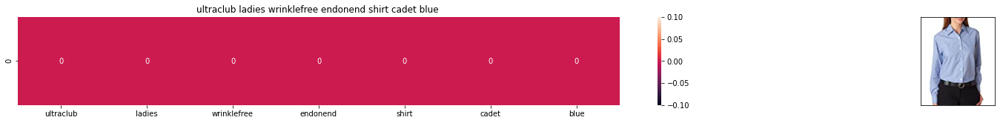

ASIN : B008LT18KS
Brand: UltraClub
Title: ultraclub ladies wrinklefree endonend shirt cadet blue 
Euclidean similarity with the query image : 4.47213595499958


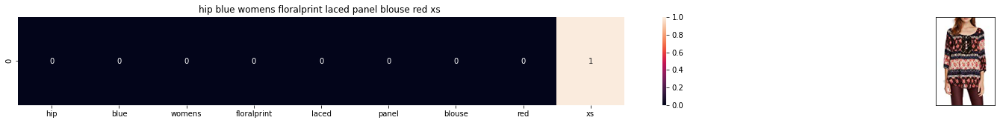

ASIN : B071P49P22
Brand: Hip
Title: hip blue womens floralprint laced panel blouse red xs 
Euclidean similarity with the query image : 4.47213595499958


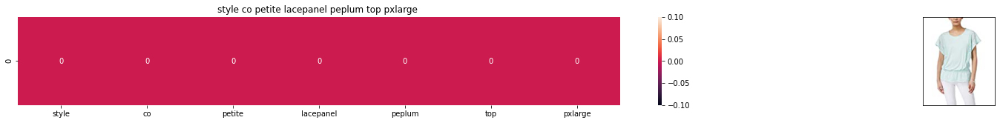

ASIN : B06XTZD1LK
Brand: Style & Co.
Title: style co petite lacepanel peplum top pxlarge 
Euclidean similarity with the query image : 4.47213595499958


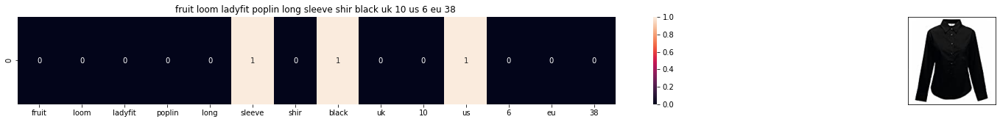

ASIN : B004X5E00E
Brand: Fruit of the Loom
Title: fruit loom ladyfit poplin long sleeve shir black uk 10 us 6 eu 38 
Euclidean similarity with the query image : 4.47213595499958


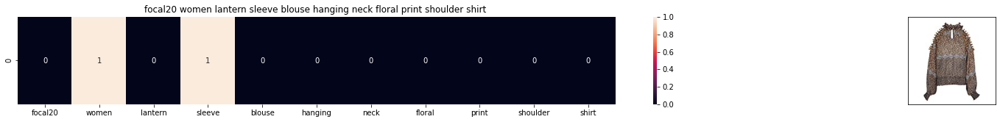

ASIN : B06XT7X1LK
Brand: Focal20
Title: focal20 women lantern sleeve blouse hanging neck floral print shoulder shirt 
Euclidean similarity with the query image : 4.47213595499958


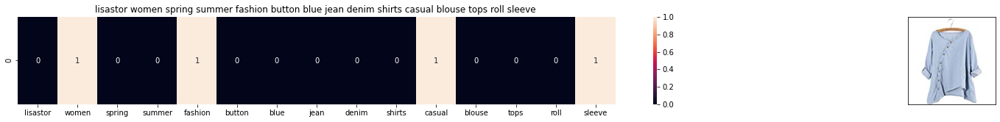

ASIN : B01KV2H7D4
Brand: LISASTOR
Title: lisastor women spring summer fashion button blue jean denim shirts casual blouse tops roll sleeve 
Euclidean similarity with the query image : 4.47213595499958


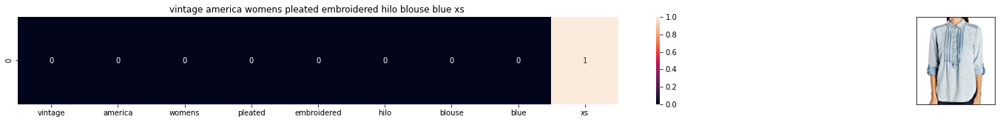

ASIN : B01L703YC2
Brand: Vintage America
Title: vintage america womens pleated embroidered hilo blouse blue xs 
Euclidean similarity with the query image : 4.47213595499958


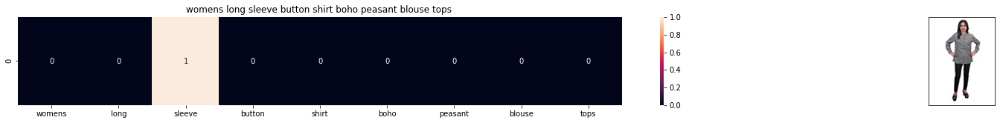

ASIN : B012WG9V2C
Brand: Mogul Interior
Title: womens long sleeve button shirt boho peasant blouse tops 
Euclidean similarity with the query image : 4.47213595499958


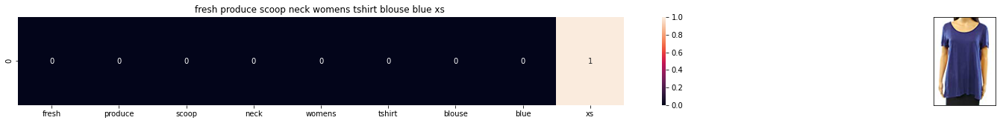

ASIN : B073VSBT6R
Brand: Fresh Produce
Title: fresh produce scoop neck womens tshirt blouse blue xs 
Euclidean similarity with the query image : 4.47213595499958


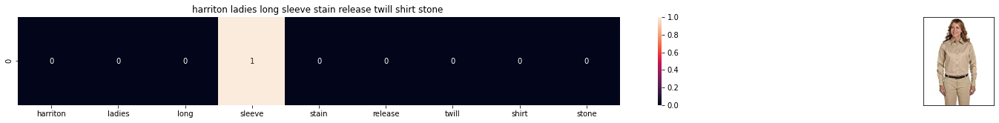

ASIN : B00WDDA534
Brand: Harriton
Title: harriton ladies long sleeve stain release twill shirt stone 
Euclidean similarity with the query image : 4.47213595499958


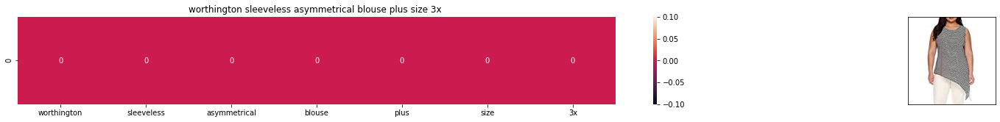

ASIN : B06Y3KWYHD
Brand: Worthington
Title: worthington sleeveless asymmetrical blouse plus size 3x 
Euclidean similarity with the query image : 4.47213595499958


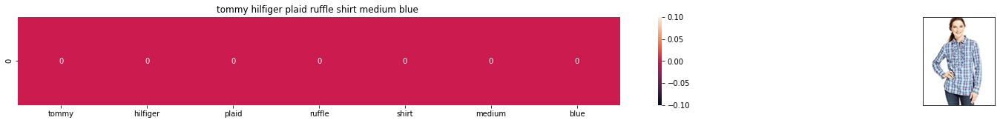

ASIN : B000HKAWWO
Brand: Tommy Hilfiger
Title: tommy hilfiger plaid ruffle shirt medium blue 
Euclidean similarity with the query image : 4.47213595499958


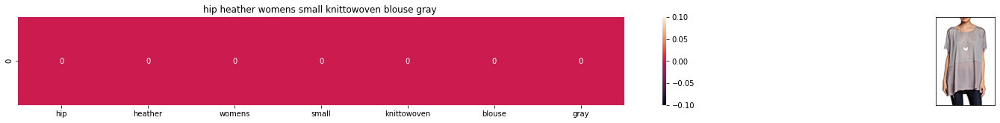

ASIN : B01N5VZQBP
Brand: Hip
Title: hip heather womens small knittowoven blouse gray 
Euclidean similarity with the query image : 4.47213595499958


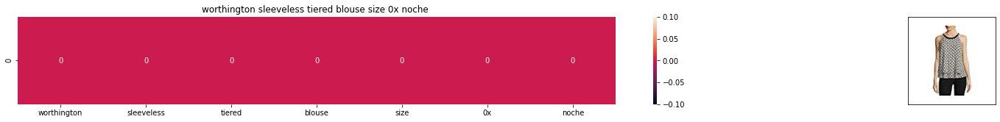

ASIN : B06Y3TKK57
Brand: Worthington
Title: worthington sleeveless tiered blouse size 0x noche 
Euclidean similarity with the query image : 4.47213595499958


In [98]:
def bag_of_words_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity

    pairwise_dist = pairwise_distances(title_features,title_features[doc_id])
    
    # np.argsort will return indices of the smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0,len(indices)):
        # we will pass 1. doc_id, 2. title1, 3. title2, url, model
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'bag_of_words')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print ('Brand:', data['brand'].loc[df_indices[i]])
        print ('Title:', data['title'].loc[df_indices[i]])
        print ('Euclidean similarity with the query image :', pdists[i])
        print('='*60)

#call the bag-of-words model for a product to get similar products.
bag_of_words_model(125, 200) 
# change the index if you want to.
# In the output heat map each value represents the count value 
# of the label word, the color represents the intersection 
# with inputs title.

#try 12566
#try 931

## [8.5] TF-IDF based product similarity

In [0]:
tfidf_title_vectorizer = TfidfVectorizer(min_df = 0)
tfidf_title_features = tfidf_title_vectorizer.fit_transform(data['title'])
# tfidf_title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(courpus) returns the a sparase matrix of dimensions #data_points * #words_in_corpus
# tfidf_title_features[doc_id, index_of_word_in_corpus] = tfidf values of the word in given doc

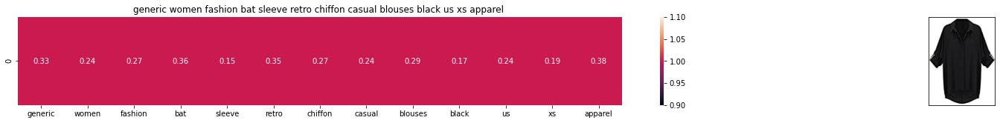

ASIN : B019MDNF8Y
BRAND : Absolutely
Eucliden distance from the given image : 0.0


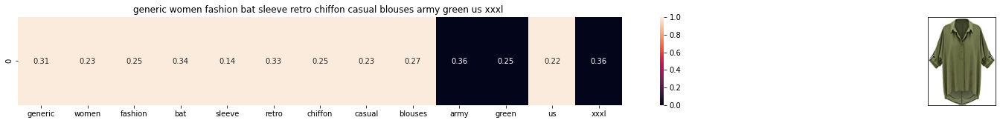

ASIN : B019MDNNHC
BRAND : Absolutely
Eucliden distance from the given image : 0.7277762803800907


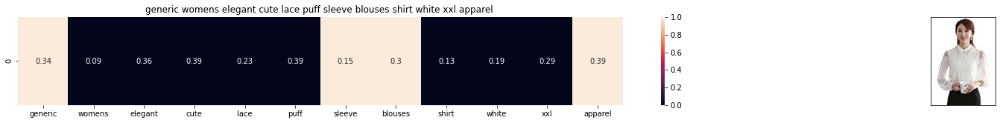

ASIN : B014CF1PC0
BRAND : Absolutely
Eucliden distance from the given image : 1.1249198612606544


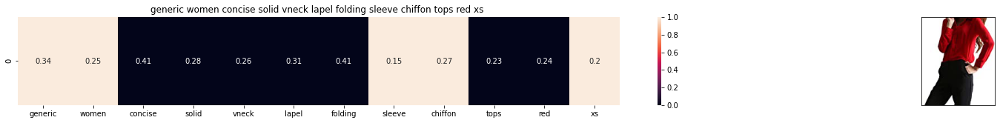

ASIN : B013JPTCV0
BRAND : Absolutely
Eucliden distance from the given image : 1.1799762447646636


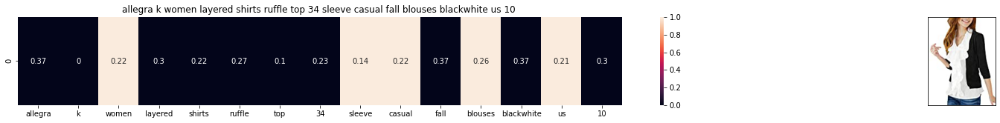

ASIN : B008X1FTI6
BRAND : Allegra K
Eucliden distance from the given image : 1.2216271281345998


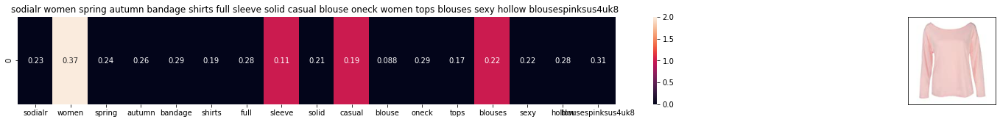

ASIN : B07336178W
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.2516211739890444


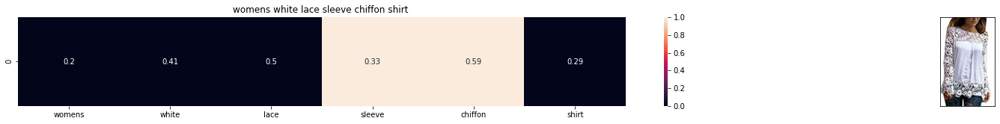

ASIN : B073JWSM1V
BRAND : Fuming
Eucliden distance from the given image : 1.2592678813736211


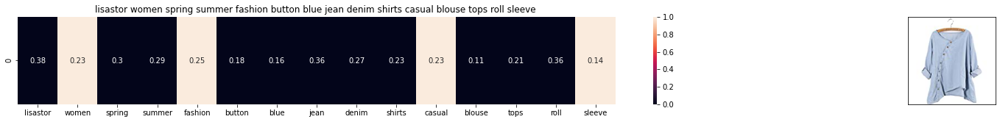

ASIN : B01KV2H7D4
BRAND : LISASTOR
Eucliden distance from the given image : 1.2649460208377143


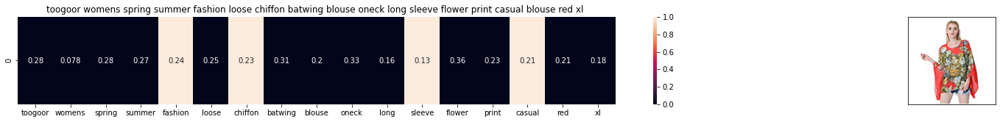

ASIN : B01NCZ9CMF
BRAND : TOOGOO(R)
Eucliden distance from the given image : 1.2664642444712189


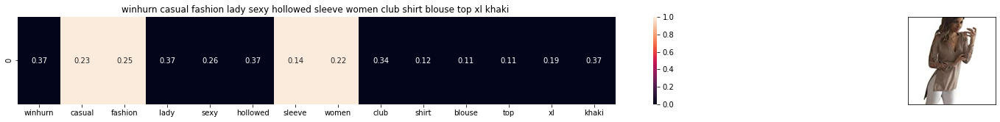

ASIN : B01NAFTMGN
BRAND : Winhurn
Eucliden distance from the given image : 1.2674635172837132


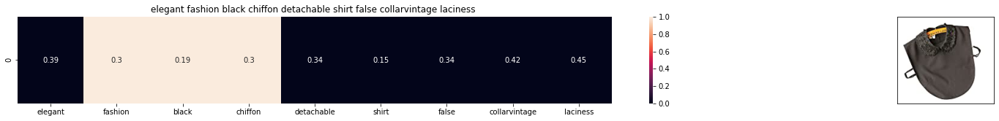

ASIN : B00WQWR9PE
BRAND : Black Temptation
Eucliden distance from the given image : 1.2703500399456742


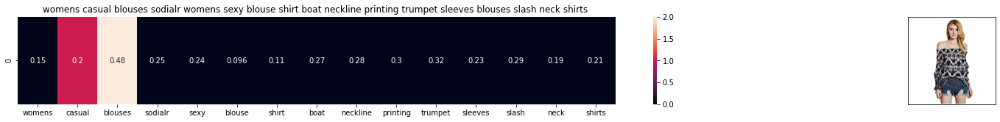

ASIN : B01MZBB7RR
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.2726631127678898


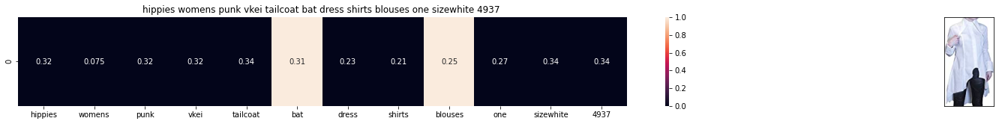

ASIN : B00I2LM57K
BRAND : Hippies
Eucliden distance from the given image : 1.2775125688021123


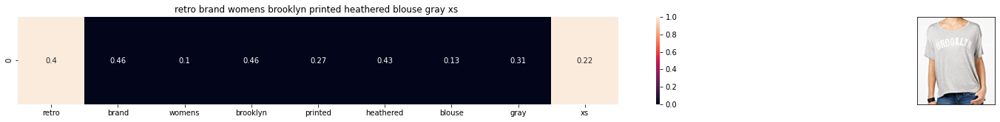

ASIN : B07574CKFL
BRAND : Retro
Eucliden distance from the given image : 1.2800440214072397


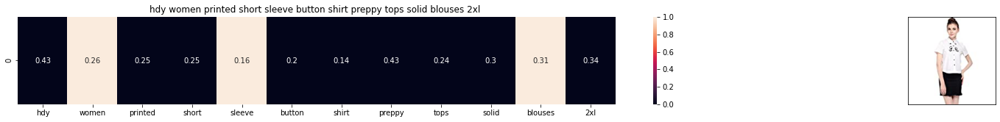

ASIN : B01M9C24GM
BRAND : WeHeart
Eucliden distance from the given image : 1.2844345046223056


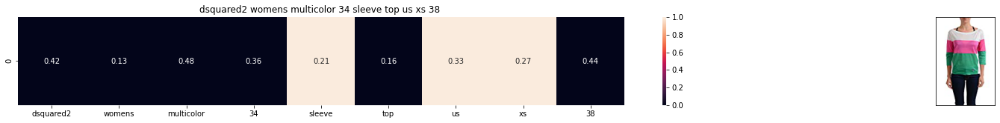

ASIN : B01LXSV2E3
BRAND : DSQUARED2
Eucliden distance from the given image : 1.293484969284609


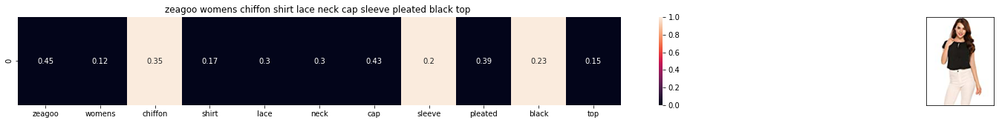

ASIN : B072MYLMVY
BRAND : Zeagoo
Eucliden distance from the given image : 1.2935574389031685


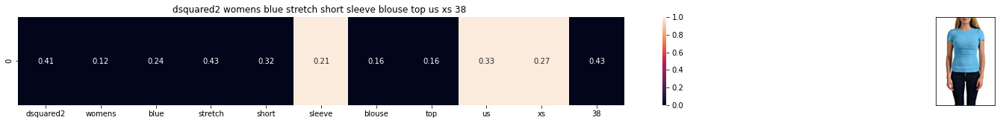

ASIN : B01L61XJ1I
BRAND : DSQUARED2
Eucliden distance from the given image : 1.2949850136899832


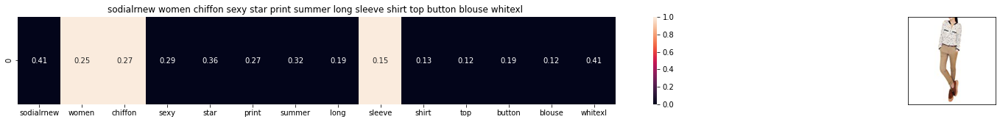

ASIN : B013OD2T26
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.300107129244194


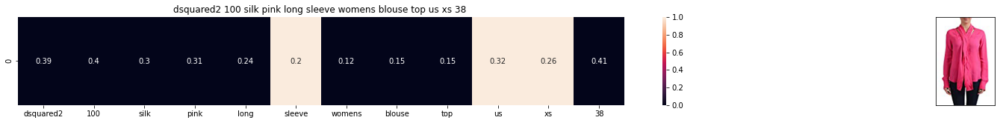

ASIN : B01M087PQ5
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3006895260712221


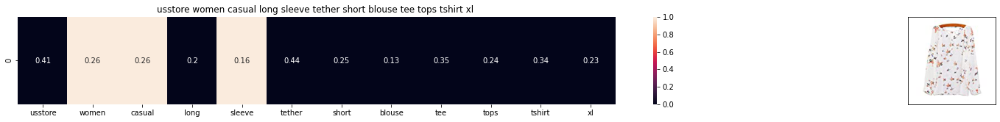

ASIN : B01F0X7ZUE
BRAND : Usstore
Eucliden distance from the given image : 1.3021343822721685


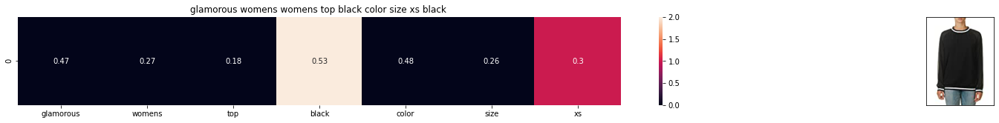

ASIN : B01LWXT1BI
BRAND : Glamorous
Eucliden distance from the given image : 1.3042604129136115


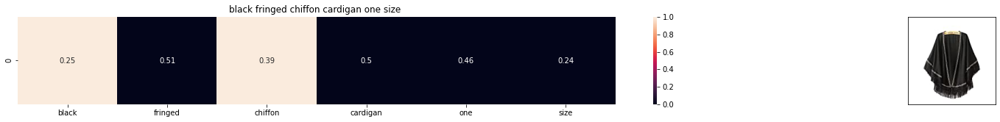

ASIN : B010AMAMLY
BRAND : HP-LEISURE
Eucliden distance from the given image : 1.3054902164027649


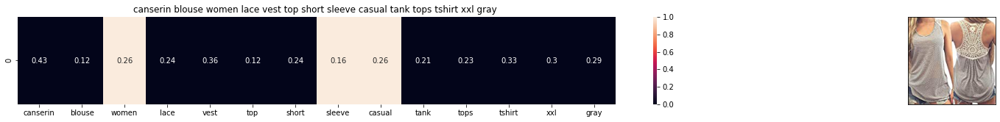

ASIN : B01GNNWE5G
BRAND : Canserin
Eucliden distance from the given image : 1.3054949304588253


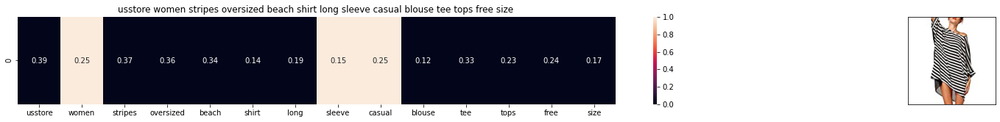

ASIN : B01DNNI1RO
BRAND : Usstore
Eucliden distance from the given image : 1.3086570260332246


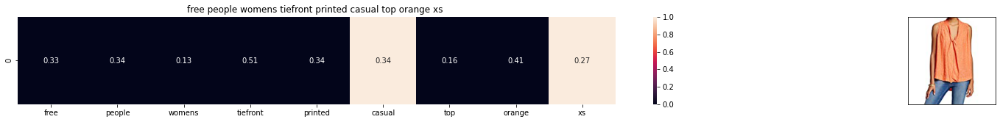

ASIN : B06X6H77F5
BRAND : Free People
Eucliden distance from the given image : 1.3144467375629993


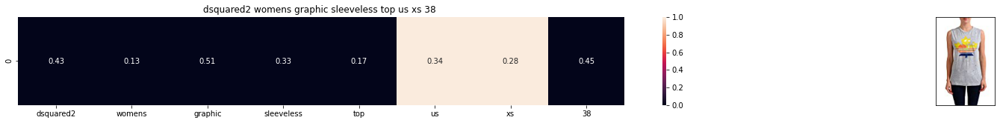

ASIN : B01LBADRWA
BRAND : DSQUARED2
Eucliden distance from the given image : 1.314558292578135


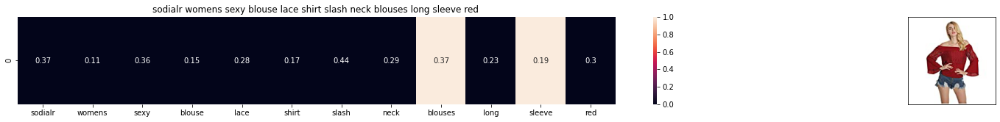

ASIN : B01MY9VNBW
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.3155275635934087


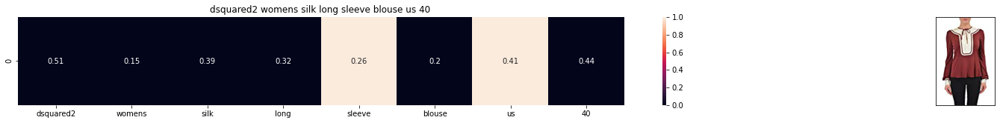

ASIN : B01759GD18
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3157201990708616


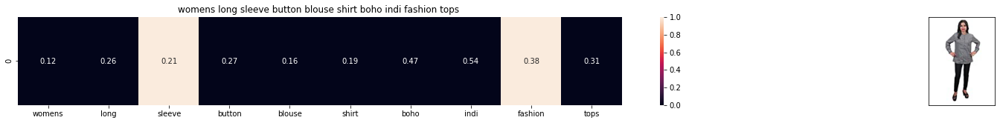

ASIN : B012WGJT6A
BRAND : Mogul Interior
Eucliden distance from the given image : 1.316624831972114


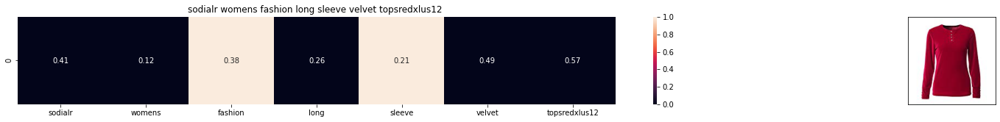

ASIN : B06XC25J1T
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.3169859350395197


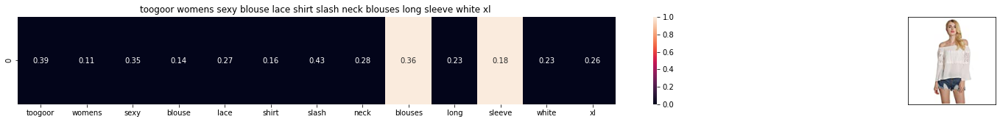

ASIN : B01MSALTPD
BRAND : TOOGOO(R)
Eucliden distance from the given image : 1.3183307446920651


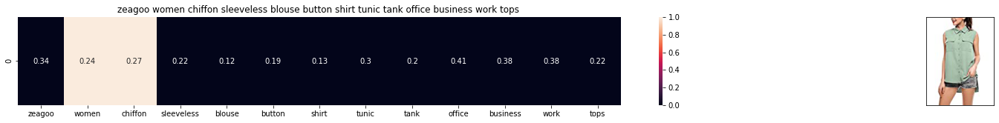

ASIN : B0753CLRTS
BRAND : Zeagoo
Eucliden distance from the given image : 1.3191508021745162


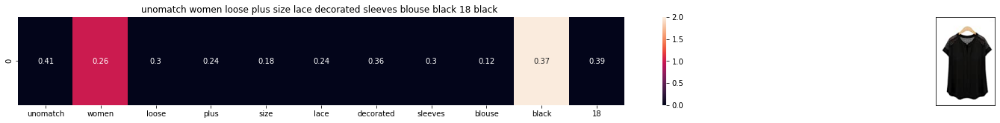

ASIN : B01MZFZOFD
BRAND : Unomatch
Eucliden distance from the given image : 1.3207071920419966


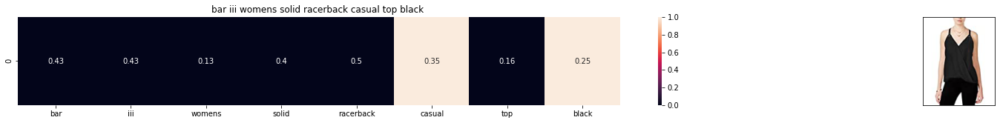

ASIN : B0724ZCX9F
BRAND : Bar III
Eucliden distance from the given image : 1.3208390870587694


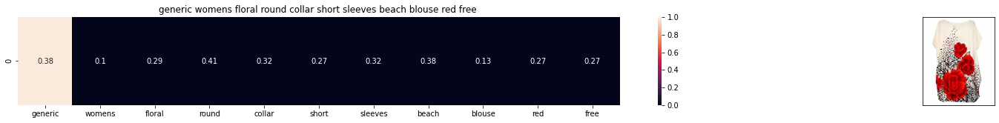

ASIN : B01EHQCHOY
BRAND : Generic
Eucliden distance from the given image : 1.3212150745792535


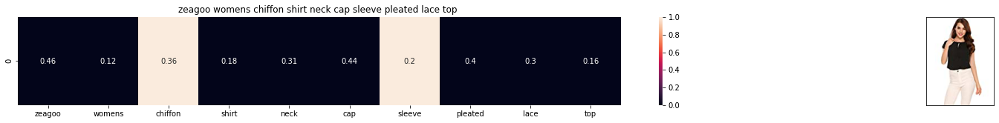

ASIN : B072KCRTKK
BRAND : Zeagoo
Eucliden distance from the given image : 1.3214664103074891


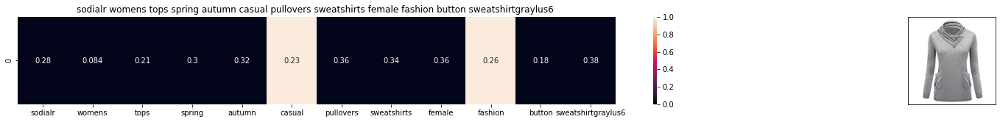

ASIN : B01MZBBU27
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.3229282851862654


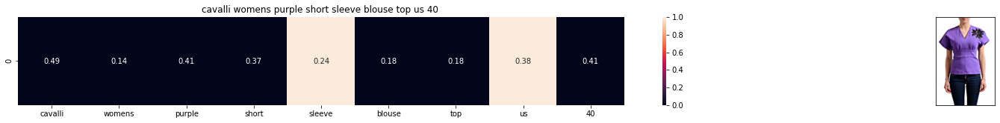

ASIN : B01CAU74LK
BRAND : Just Cavalli
Eucliden distance from the given image : 1.3234370624430458


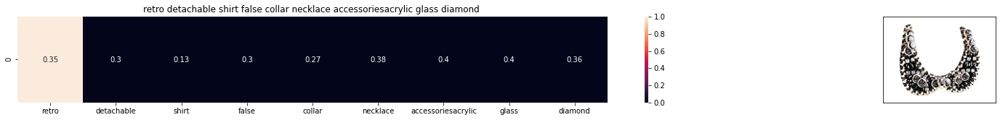

ASIN : B00NTXI4US
BRAND : Black Temptation
Eucliden distance from the given image : 1.324723365526899


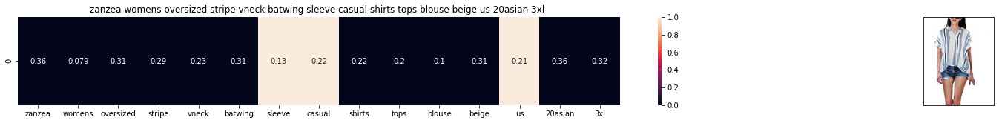

ASIN : B01KJZUDAM
BRAND : ZANZEA
Eucliden distance from the given image : 1.3249754547378587


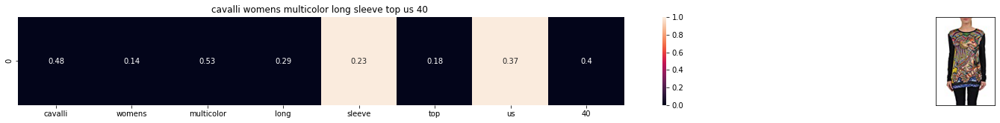

ASIN : B0175BBXY8
BRAND : Just Cavalli
Eucliden distance from the given image : 1.325231219325943


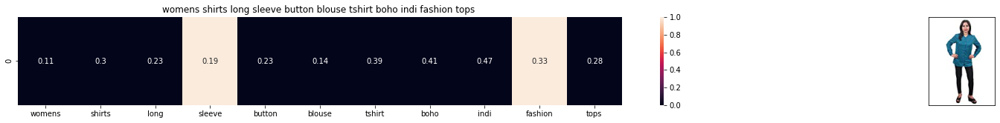

ASIN : B012WI5FES
BRAND : Mogul Interior
Eucliden distance from the given image : 1.328401505557517


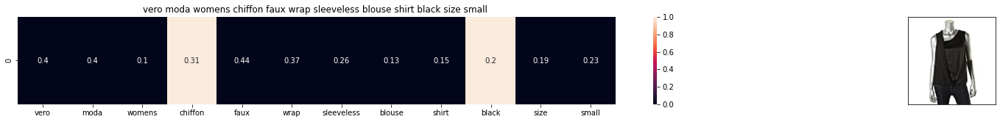

ASIN : B0719JZ1N3
BRAND : VERO MODA
Eucliden distance from the given image : 1.3293479647714834


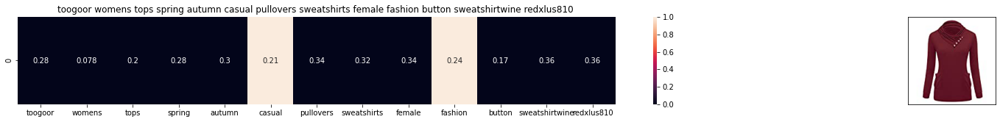

ASIN : B01N144I9J
BRAND : TOOGOO(R)
Eucliden distance from the given image : 1.3296244598547449


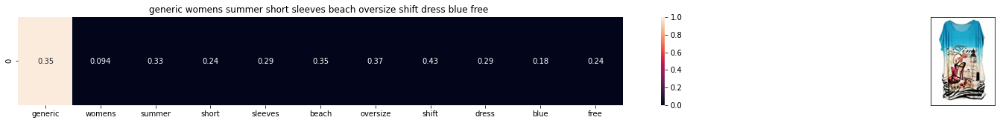

ASIN : B01EHQCNSE
BRAND : Generic
Eucliden distance from the given image : 1.3299353004713848


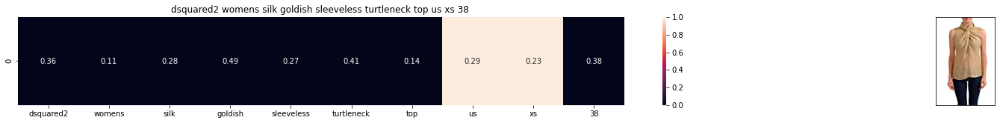

ASIN : B01LBAY4KE
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3317510155673855


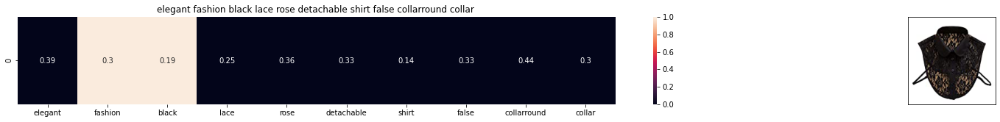

ASIN : B00WNVE1WC
BRAND : Black Temptation
Eucliden distance from the given image : 1.332040975207903


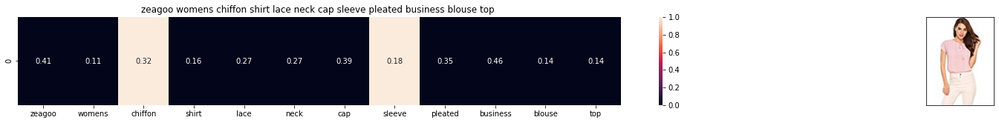

ASIN : B072KCRW58
BRAND : Zeagoo
Eucliden distance from the given image : 1.3329772274361733


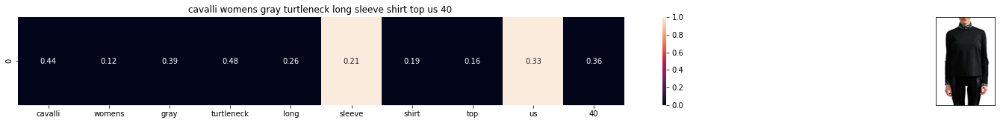

ASIN : B01C5UDSQU
BRAND : Just Cavalli
Eucliden distance from the given image : 1.3341288899426627


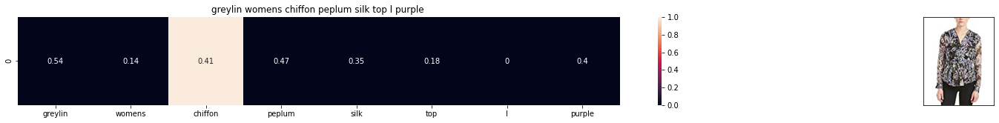

ASIN : B06XSG711M
BRAND : Greylin
Eucliden distance from the given image : 1.3351552287953385


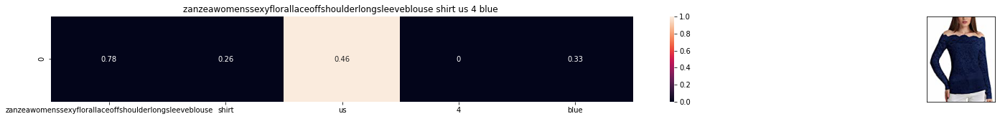

ASIN : B01192N6GC
BRAND : ZANZEA
Eucliden distance from the given image : 1.3354240312254653


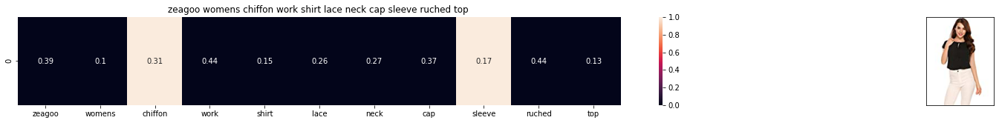

ASIN : B071GK7CNP
BRAND : Zeagoo
Eucliden distance from the given image : 1.3355428097919682


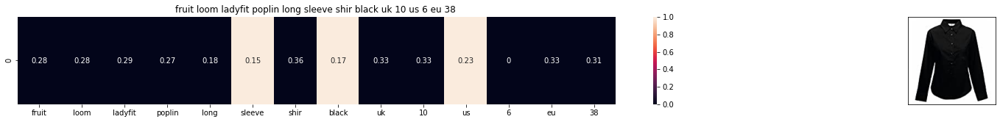

ASIN : B004X5E00E
BRAND : Fruit of the Loom
Eucliden distance from the given image : 1.3360353486731316


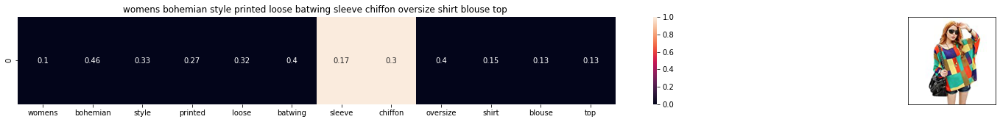

ASIN : B010CO8JQA
BRAND : Sunshine
Eucliden distance from the given image : 1.3371118710753445


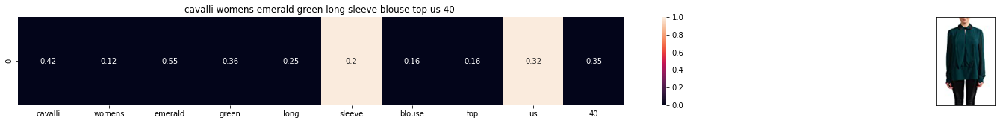

ASIN : B01C4TUONC
BRAND : Just Cavalli
Eucliden distance from the given image : 1.337135807167709


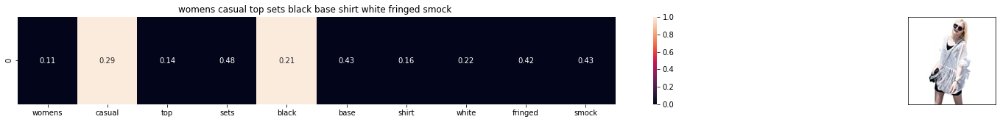

ASIN : B011TOPBRC
BRAND : HP-LEISURE
Eucliden distance from the given image : 1.3372728473521815


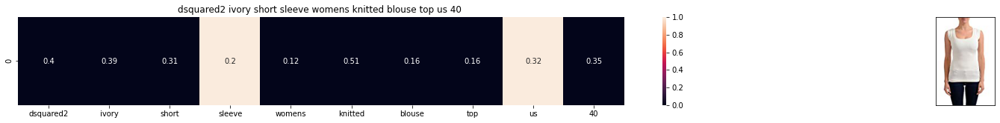

ASIN : B01LZX5EQB
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3373409833364902


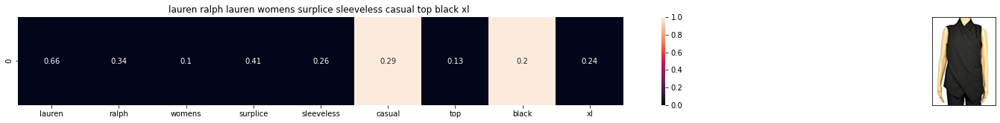

ASIN : B01N6RZPQW
BRAND : Lauren by Ralph Lauren
Eucliden distance from the given image : 1.3380175326010448


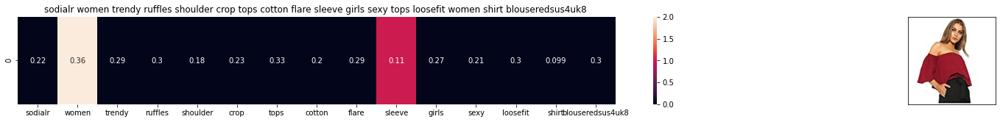

ASIN : B07335PSXG
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.338197817755878


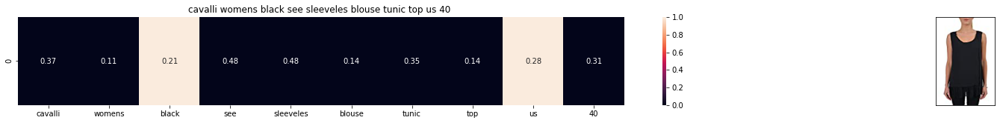

ASIN : B0175AYXG4
BRAND : Just Cavalli
Eucliden distance from the given image : 1.339408024778636


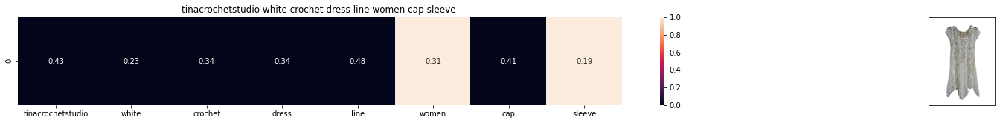

ASIN : B015Y4IX1O
BRAND : tinacrochetstudio
Eucliden distance from the given image : 1.3400993174518097


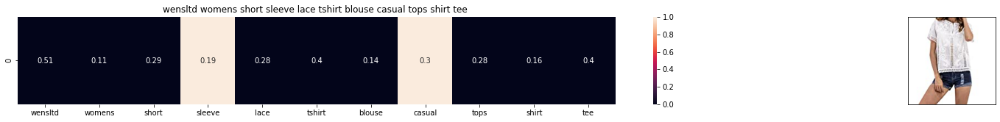

ASIN : B06W2LXT6G
BRAND : WensLTD
Eucliden distance from the given image : 1.3401723432310784


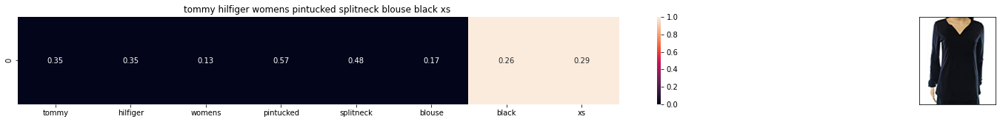

ASIN : B0759NHBZK
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.340493355927734


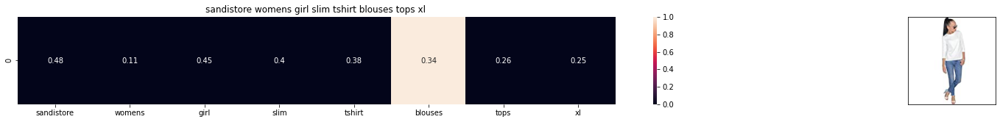

ASIN : B00ZKZBEOQ
BRAND : Sandistore
Eucliden distance from the given image : 1.341621908102592


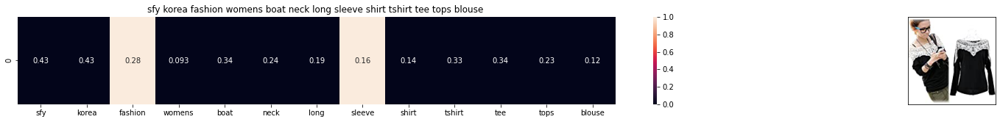

ASIN : B01MCTNYL2
BRAND : SoForYou
Eucliden distance from the given image : 1.3418731871237397


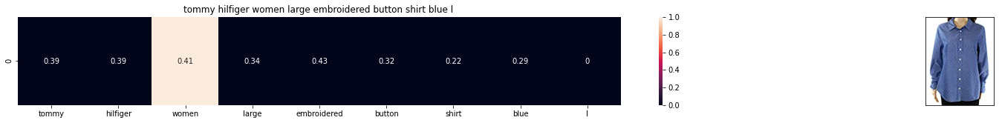

ASIN : B0759NH3ZR
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.3430083187193975


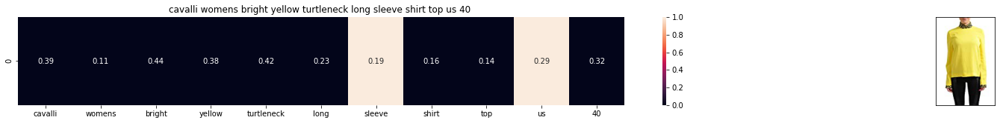

ASIN : B01C5UJI5U
BRAND : Just Cavalli
Eucliden distance from the given image : 1.3435827340044944


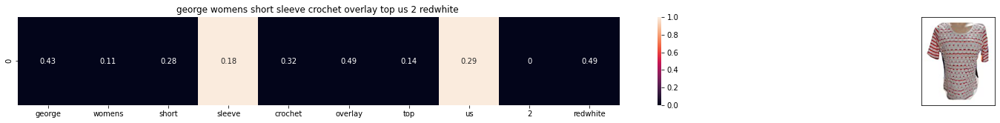

ASIN : B06XFLT65Y
BRAND : George
Eucliden distance from the given image : 1.3451881877125347


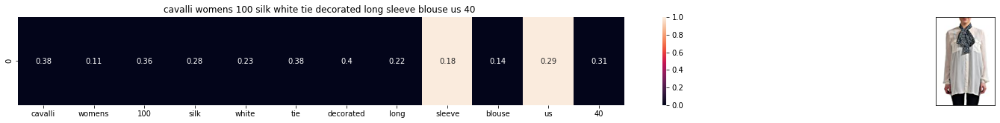

ASIN : B01BLKPXCM
BRAND : Just Cavalli
Eucliden distance from the given image : 1.3453517587057306


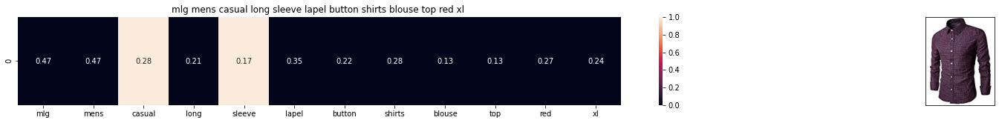

ASIN : B01N44J962
BRAND : MLG
Eucliden distance from the given image : 1.346199370821924


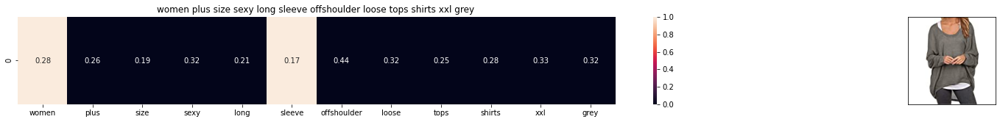

ASIN : B01EQUG5AS
BRAND : Cutecc
Eucliden distance from the given image : 1.347369512149693


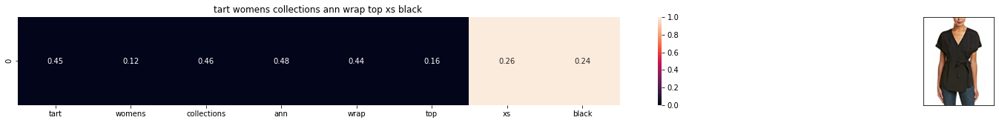

ASIN : B07167SCNH
BRAND : Tart Collections
Eucliden distance from the given image : 1.3477981120790339


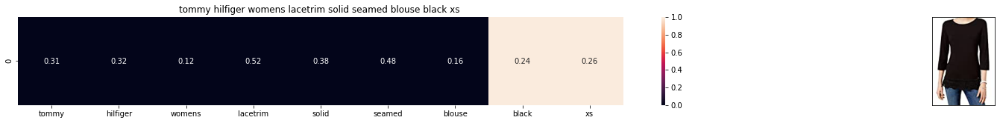

ASIN : B0759M7JYM
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.3478723003105504


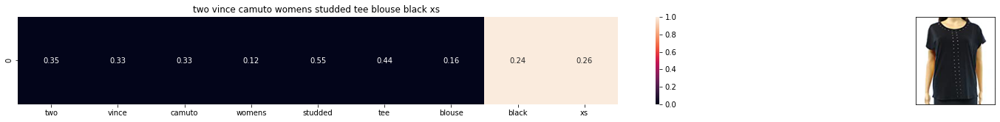

ASIN : B071GZJ5C8
BRAND : Two by Vince Camuto
Eucliden distance from the given image : 1.3479806695379426


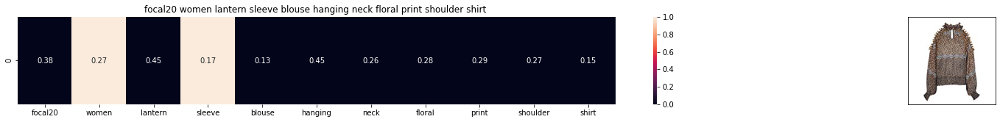

ASIN : B06XT7X1LK
BRAND : Focal20
Eucliden distance from the given image : 1.3487832875503614


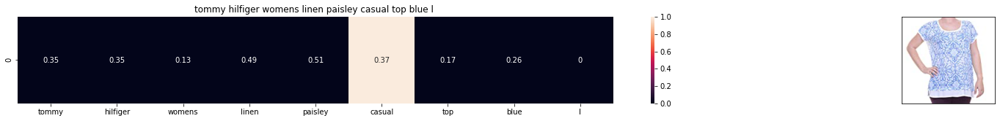

ASIN : B06WLHTS8S
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.3493457333055503


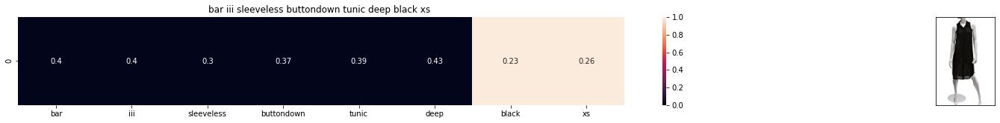

ASIN : B072364BLG
BRAND : Bar III
Eucliden distance from the given image : 1.3493881951630495


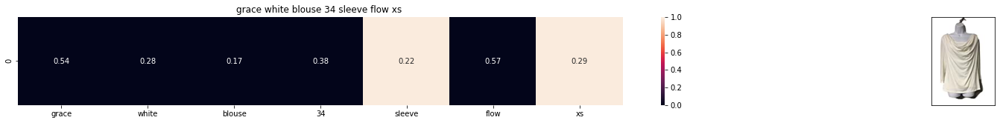

ASIN : B0721CW9F3
BRAND : Grace
Eucliden distance from the given image : 1.3498025069945112


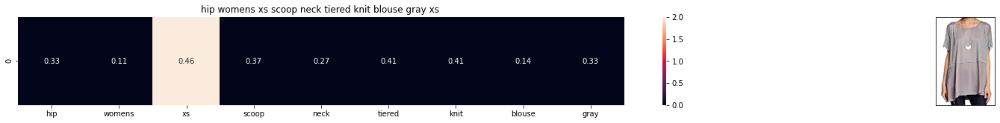

ASIN : B01N3B50EU
BRAND : Hip
Eucliden distance from the given image : 1.349803901701922


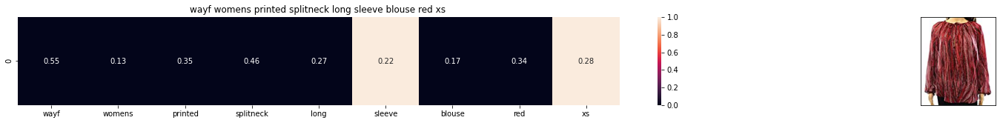

ASIN : B01GRY940Y
BRAND : WAYF
Eucliden distance from the given image : 1.351366519507022


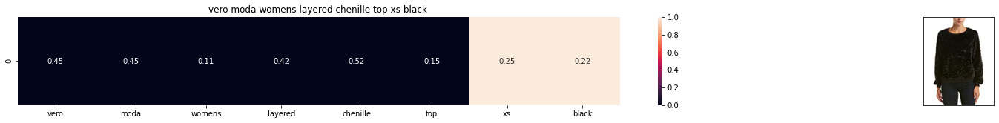

ASIN : B01N8UZQ8L
BRAND : VERO MODA
Eucliden distance from the given image : 1.3516310147586892


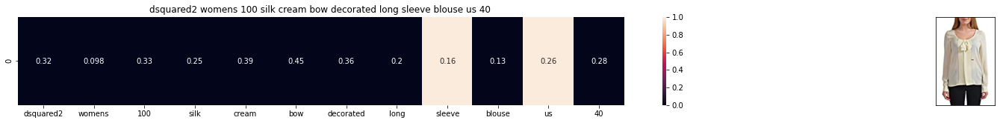

ASIN : B01APYXPD4
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3519301714769414


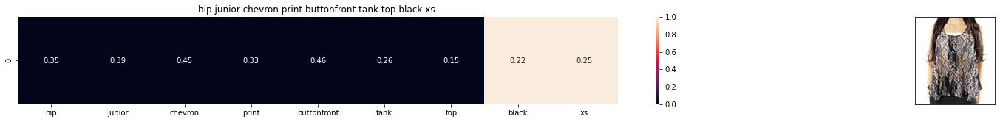

ASIN : B0716TC3YF
BRAND : Hip
Eucliden distance from the given image : 1.352209664165598


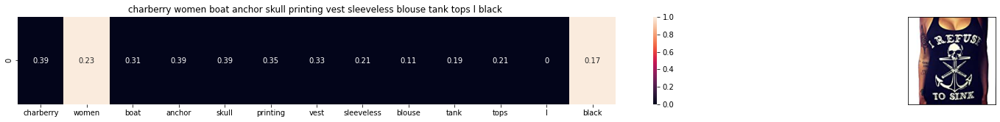

ASIN : B06XZZXJR3
BRAND : Charberry
Eucliden distance from the given image : 1.3527762683114573


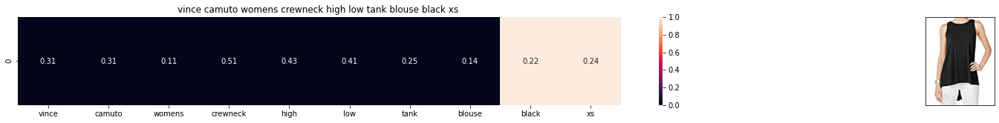

ASIN : B071LMW7K8
BRAND : Vince Camuto
Eucliden distance from the given image : 1.3531994186197112


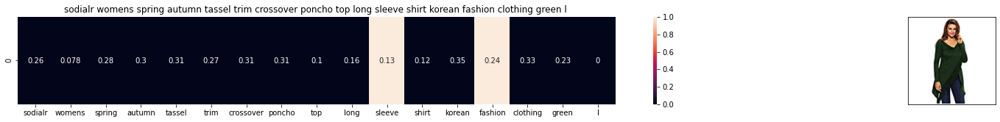

ASIN : B01N12FS86
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.3543894849374496


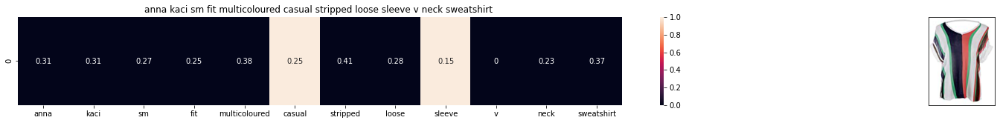

ASIN : B011WFB4BK
BRAND : Anna-Kaci
Eucliden distance from the given image : 1.3546018858204156


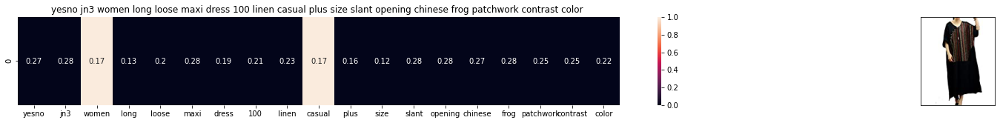

ASIN : B073ZYCCCQ
BRAND : YESNO
Eucliden distance from the given image : 1.3546896321239825


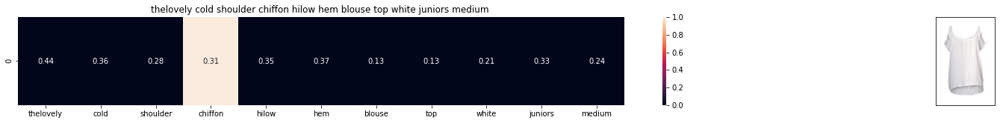

ASIN : B01JB3YCJG
BRAND : The Lovely
Eucliden distance from the given image : 1.3552750624972876


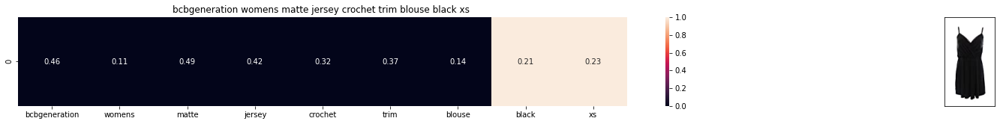

ASIN : B01EV7Q6UA
BRAND : BCBGeneration
Eucliden distance from the given image : 1.3552923925248503


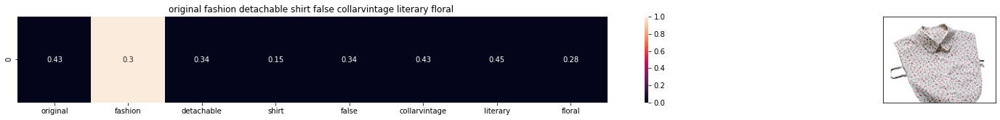

ASIN : B00WSIF0Y8
BRAND : Black Temptation
Eucliden distance from the given image : 1.3553989021665904


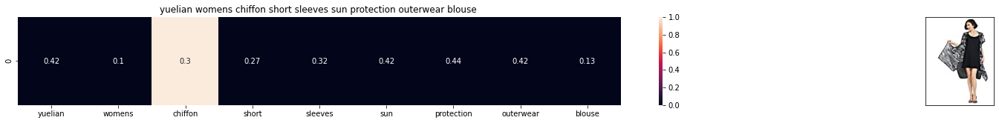

ASIN : B01MRV2IFS
BRAND : YueLian
Eucliden distance from the given image : 1.3555855296297235


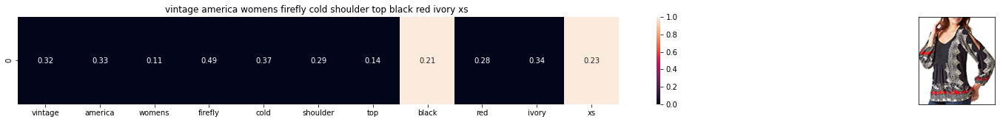

ASIN : B01MQ3W3JJ
BRAND : Vintage America
Eucliden distance from the given image : 1.3556313220491127


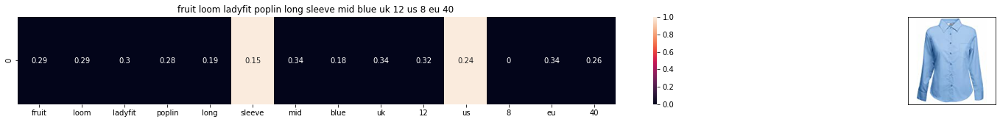

ASIN : B004X5E2EI
BRAND : Fruit of the Loom
Eucliden distance from the given image : 1.3563857234769217


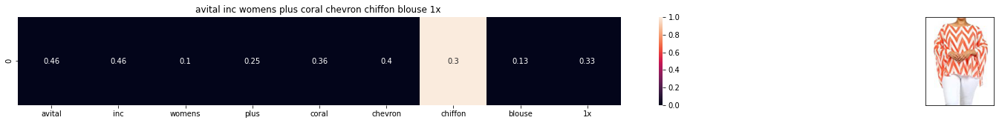

ASIN : B072FJZBKD
BRAND : Avital Inc.
Eucliden distance from the given image : 1.3563866749191904


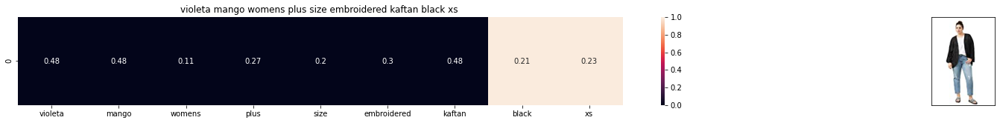

ASIN : B06Y2JPHRS
BRAND : Violeta by MANGO
Eucliden distance from the given image : 1.356389417841294


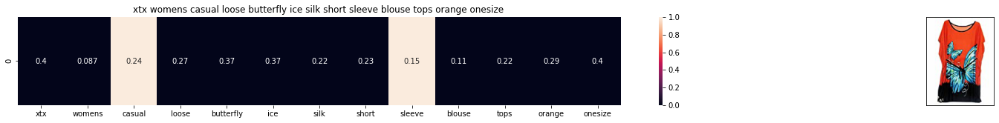

ASIN : B01FGUMS44
BRAND : XiaoTianXin-women clothes
Eucliden distance from the given image : 1.3564088536989827


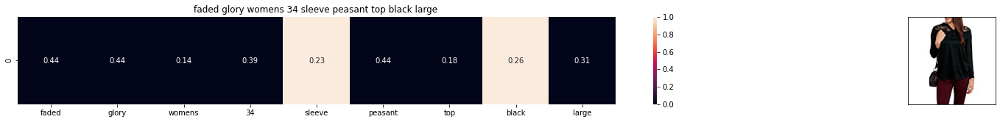

ASIN : B06XXHYBL6
BRAND : Faded Glory
Eucliden distance from the given image : 1.356576509230234


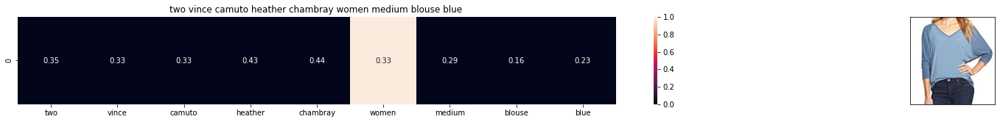

ASIN : B0758K7Q3C
BRAND : Two by Vince Camuto
Eucliden distance from the given image : 1.3567075839425924


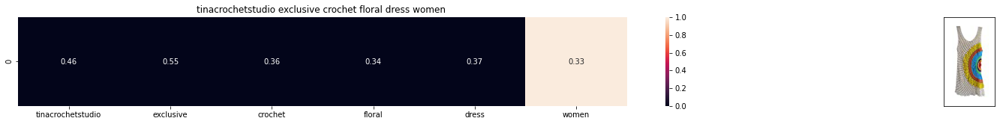

ASIN : B0161FG9D4
BRAND : tinacrochetstudio
Eucliden distance from the given image : 1.3571944713597415


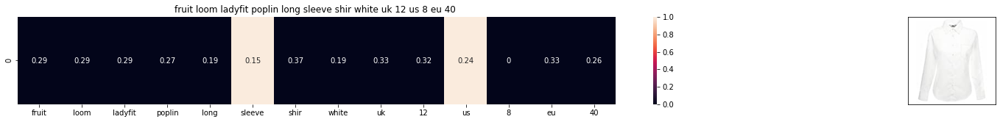

ASIN : B004X5E9KU
BRAND : Fruit of the Loom
Eucliden distance from the given image : 1.3572389271663334


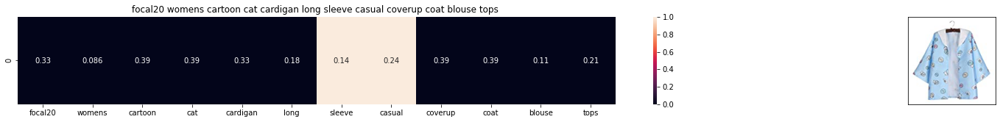

ASIN : B06XW47599
BRAND : Focal20
Eucliden distance from the given image : 1.3573117803068135


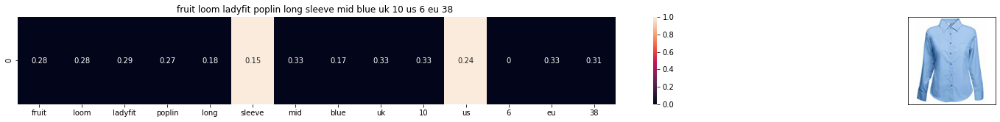

ASIN : B00GSBRC1U
BRAND : Fruit of the Loom
Eucliden distance from the given image : 1.3575515811685572


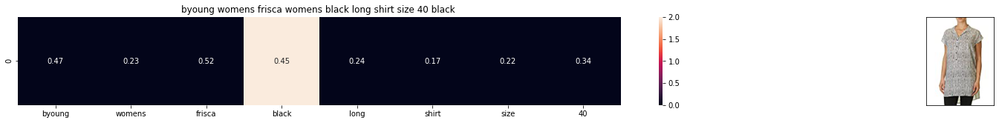

ASIN : B01LXPGQAU
BRAND : Byoung
Eucliden distance from the given image : 1.357785841694168


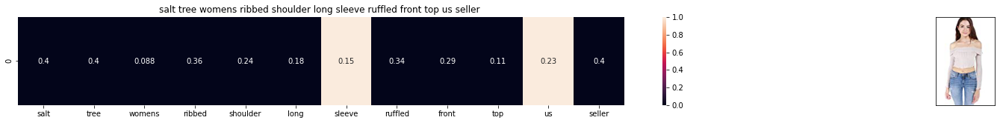

ASIN : B07566FQHN
BRAND : Salt Tree
Eucliden distance from the given image : 1.3582343829297112


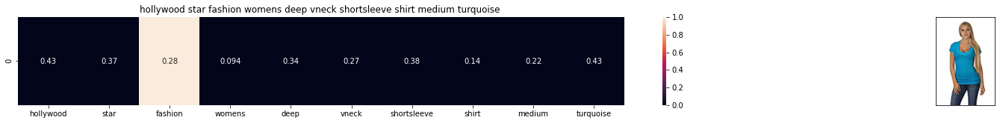

ASIN : B00LYTA1ZA
BRAND : Hollywood Star Fashion
Eucliden distance from the given image : 1.358916090907678


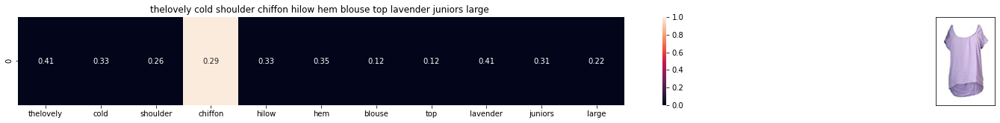

ASIN : B01JB3Y9XA
BRAND : The Lovely
Eucliden distance from the given image : 1.3591174775904966


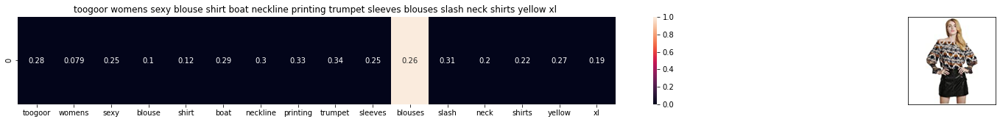

ASIN : B01MZCZC8O
BRAND : TOOGOO(R)
Eucliden distance from the given image : 1.3598525293643946


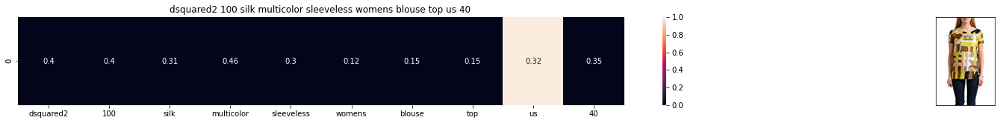

ASIN : B01D6DN99Q
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3599144693410647


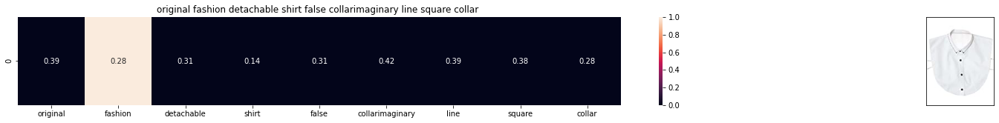

ASIN : B00WQWR9D6
BRAND : Black Temptation
Eucliden distance from the given image : 1.3602320415311049


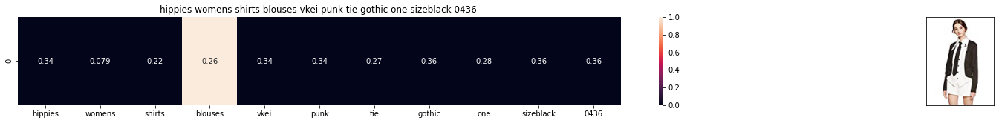

ASIN : B00QNCAN1U
BRAND : Hippies
Eucliden distance from the given image : 1.3604465581310432


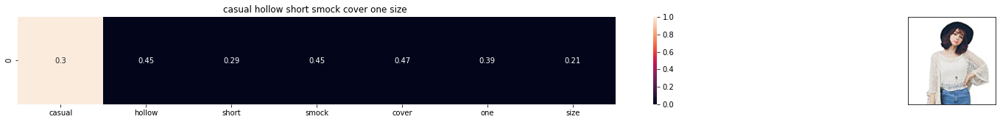

ASIN : B011KLNJSM
BRAND : HP-LEISURE
Eucliden distance from the given image : 1.3612300741447372


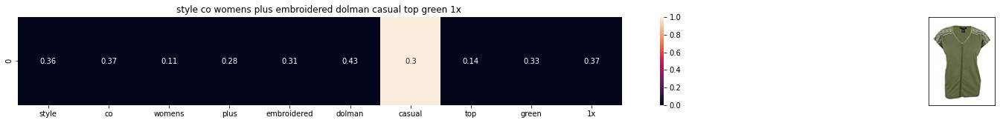

ASIN : B01N8VCW0T
BRAND : Style & Co.
Eucliden distance from the given image : 1.3612337912317203


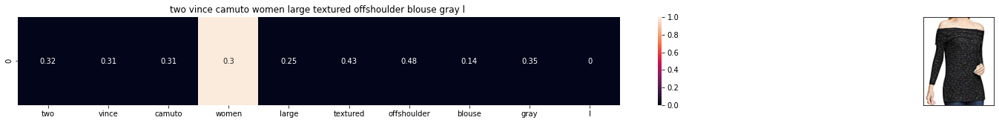

ASIN : B0751HF6MQ
BRAND : Two by Vince Camuto
Eucliden distance from the given image : 1.3614677567634788


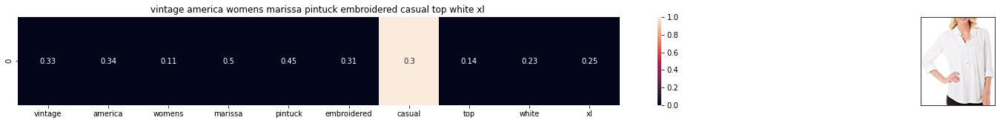

ASIN : B01M0CTZL5
BRAND : Vintage America Blues
Eucliden distance from the given image : 1.3618458013605246


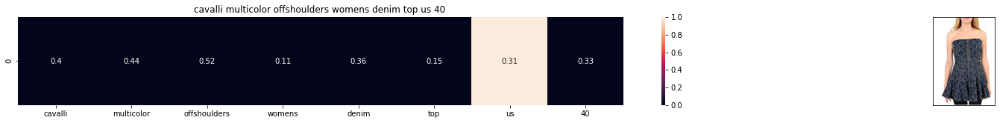

ASIN : B011SMFVVQ
BRAND : Just Cavalli
Eucliden distance from the given image : 1.3622054165953807


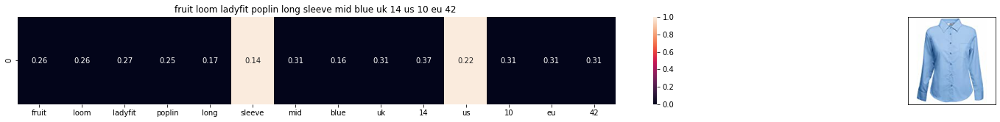

ASIN : B004X5E1VC
BRAND : Fruit of the Loom
Eucliden distance from the given image : 1.3622428540932725


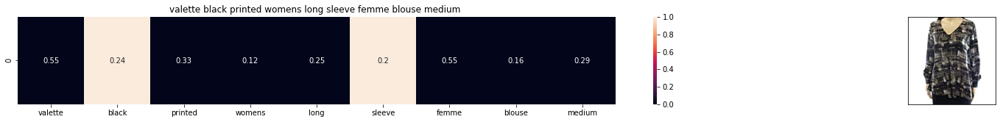

ASIN : B075817HX9
BRAND : Valette
Eucliden distance from the given image : 1.3625985233960975


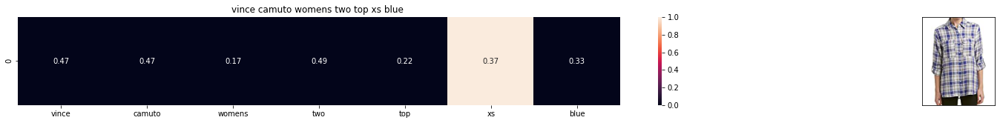

ASIN : B01N7BNEV4
BRAND : Two by Vince Camuto
Eucliden distance from the given image : 1.362943126302343


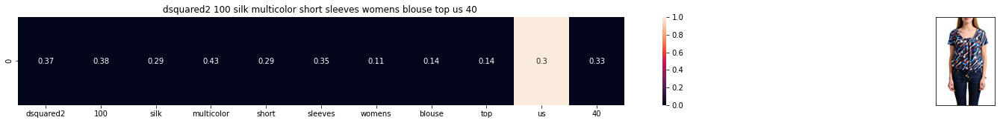

ASIN : B01D6F5CDK
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3635351894180205


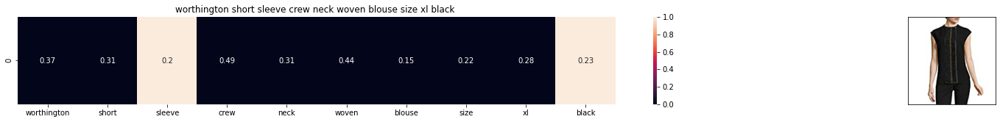

ASIN : B073MPS3TQ
BRAND : Worthington
Eucliden distance from the given image : 1.36376224277474


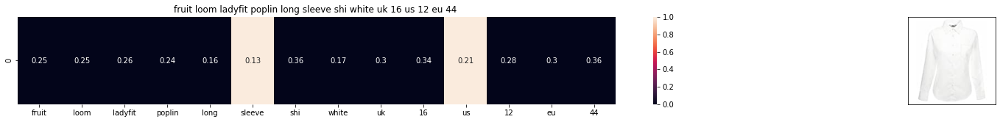

ASIN : B004X5EANQ
BRAND : Fruit of the Loom
Eucliden distance from the given image : 1.3639416643077362


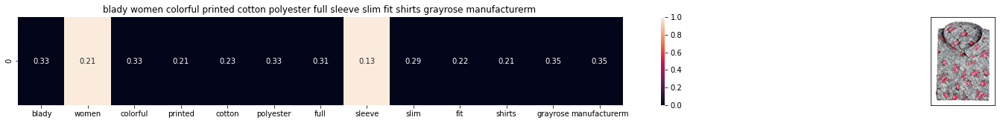

ASIN : B073VMYP7Z
BRAND : BLady
Eucliden distance from the given image : 1.3640115641337935


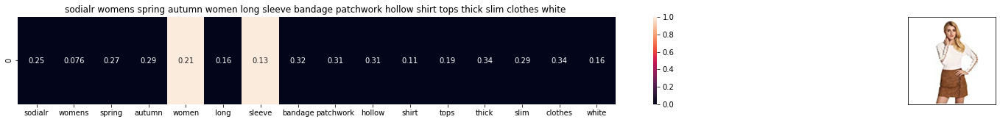

ASIN : B01MY9TTKR
BRAND : SODIAL(R)
Eucliden distance from the given image : 1.3647338546859882


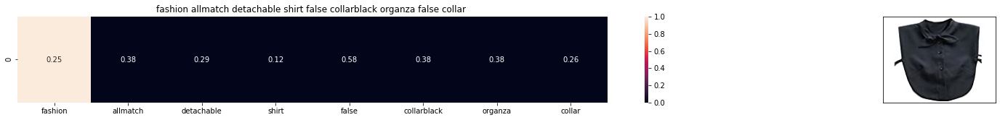

ASIN : B00WQWRS9G
BRAND : Black Temptation
Eucliden distance from the given image : 1.3649227366856471


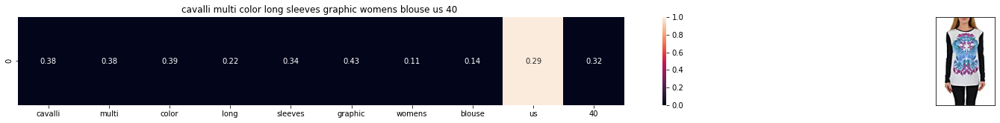

ASIN : B0177ZROQI
BRAND : Just Cavalli
Eucliden distance from the given image : 1.3650414850145176


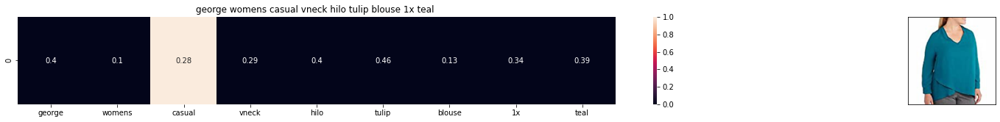

ASIN : B06ZZBQWTN
BRAND : George
Eucliden distance from the given image : 1.3651701074943738


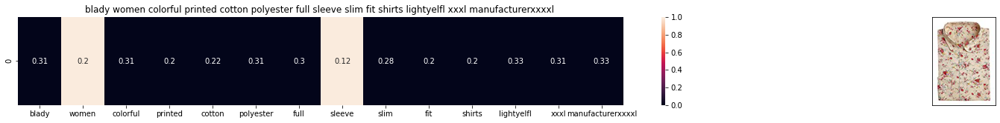

ASIN : B073VMY73L
BRAND : BLady
Eucliden distance from the given image : 1.3665689899939324


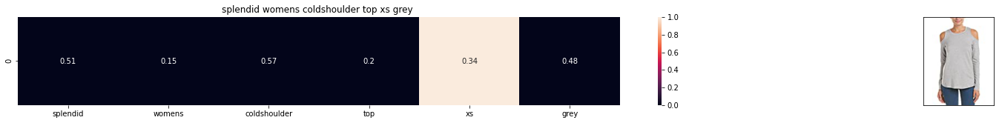

ASIN : B071KFX9ZN
BRAND : Splendid
Eucliden distance from the given image : 1.3676637498930484


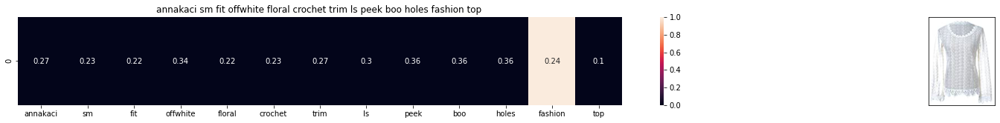

ASIN : B0094M3KW0
BRAND : Anna-Kaci
Eucliden distance from the given image : 1.3683433574892248


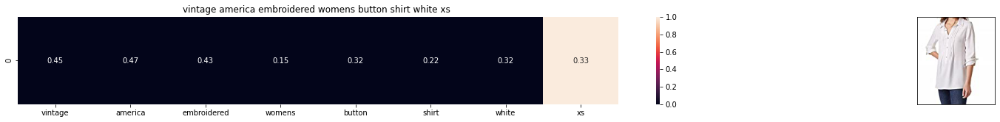

ASIN : B01LYEG8DN
BRAND : Vintage America
Eucliden distance from the given image : 1.3684624182004206


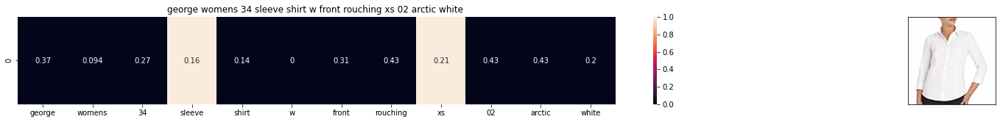

ASIN : B01MSHGL5V
BRAND : George
Eucliden distance from the given image : 1.3685588577481103


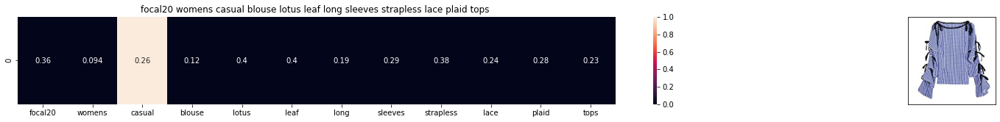

ASIN : B06XX46TJ3
BRAND : Focal20
Eucliden distance from the given image : 1.3692103647027296


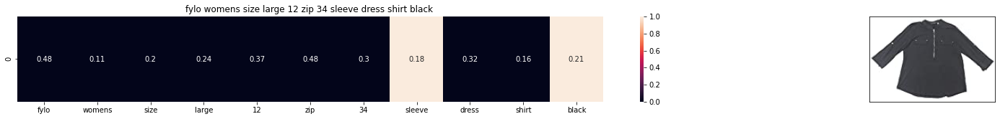

ASIN : B0718Y9J4M
BRAND : f
Eucliden distance from the given image : 1.3695541423242172


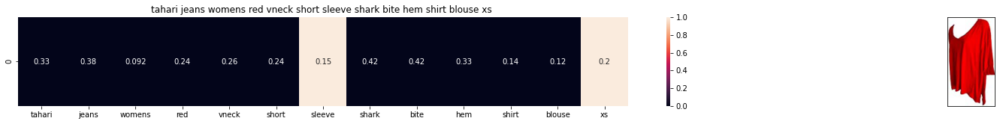

ASIN : B06XJNMHY5
BRAND : Tahari
Eucliden distance from the given image : 1.3699014972413763


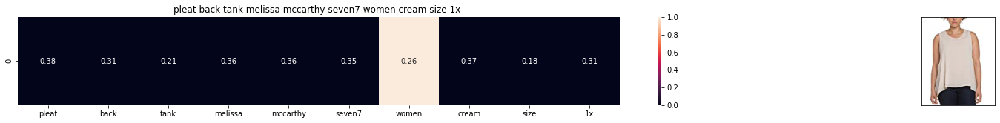

ASIN : B01N27YR6F
BRAND : Seven7
Eucliden distance from the given image : 1.3699157512186118


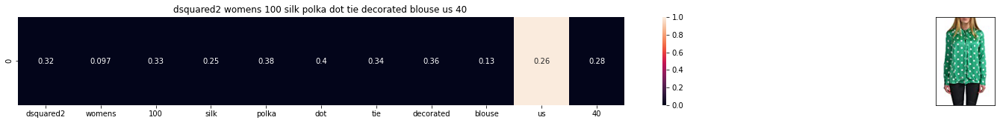

ASIN : B01AYBH28M
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3702351766768641


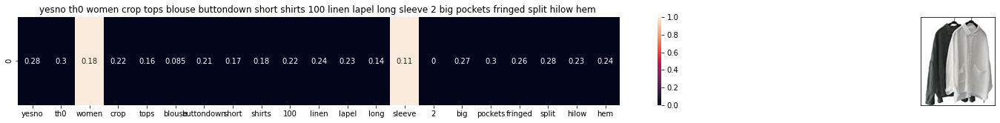

ASIN : B06Y6MT3CB
BRAND : YESNO
Eucliden distance from the given image : 1.3712116269676642


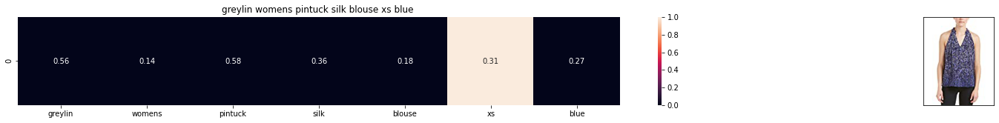

ASIN : B071XQWGSP
BRAND : Greylin
Eucliden distance from the given image : 1.3715404348719409


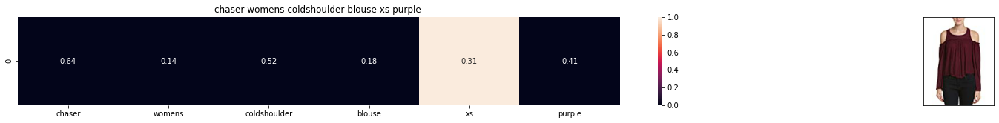

ASIN : B01N0YGSX2
BRAND : CHASER
Eucliden distance from the given image : 1.3717528369845684


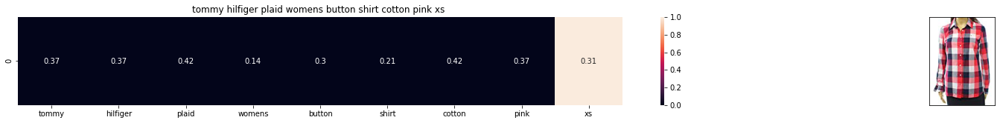

ASIN : B0759V9R3K
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.371816682322019


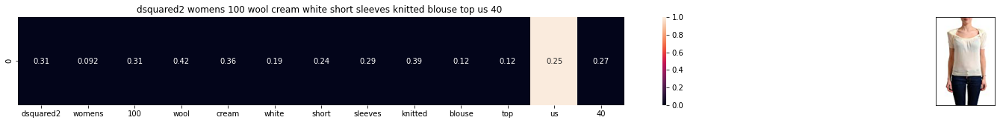

ASIN : B01D3W4WR8
BRAND : DSQUARED2
Eucliden distance from the given image : 1.3726106397170084


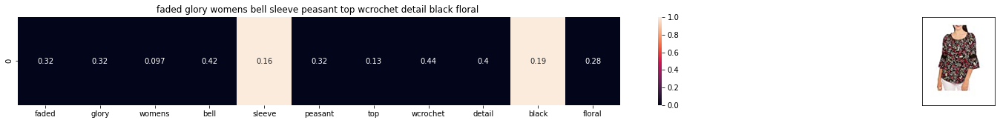

ASIN : B06WW8S6WL
BRAND : Faded Glory
Eucliden distance from the given image : 1.3729111844514328


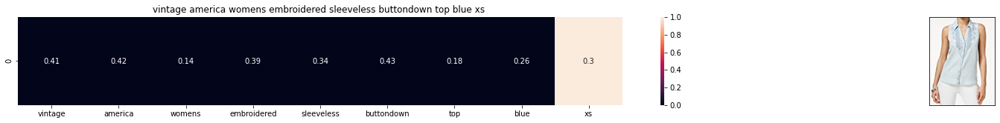

ASIN : B01E6WS9L4
BRAND : Vintage America Blues
Eucliden distance from the given image : 1.3732882085131295


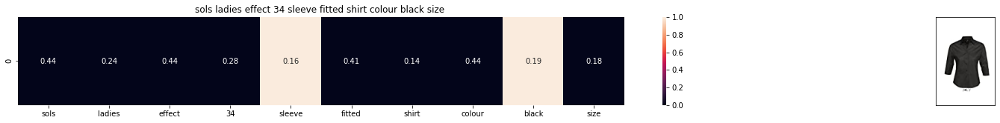

ASIN : B00D5VPZ1K
BRAND : SOL'S
Eucliden distance from the given image : 1.3733205412082143


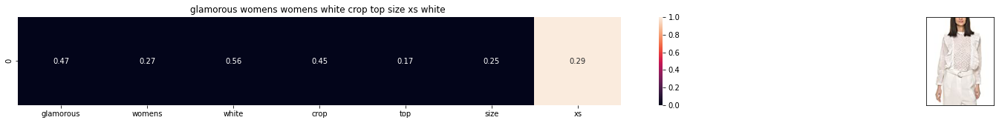

ASIN : B06XRM66GP
BRAND : Glamorous
Eucliden distance from the given image : 1.3735304746943866


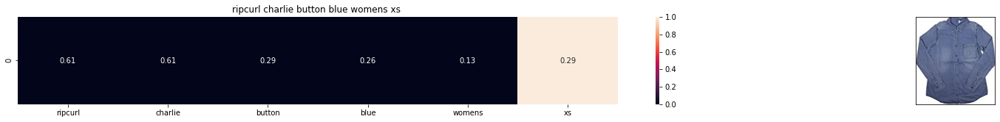

ASIN : B06XYNR9RZ
BRAND : Rip Curl
Eucliden distance from the given image : 1.3737076929897158


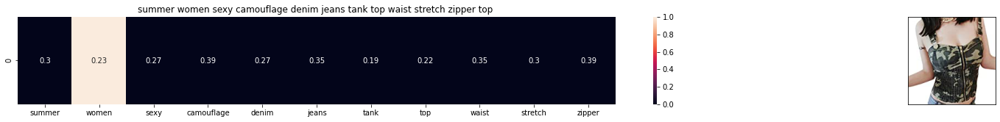

ASIN : B00XXPUKGS
BRAND : Ai.Moichien
Eucliden distance from the given image : 1.374204554692928


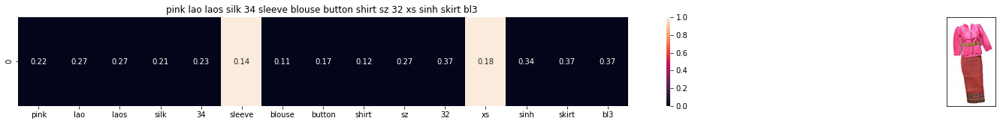

ASIN : B01JLNCC7A
BRAND : Nanon
Eucliden distance from the given image : 1.3747427530639782


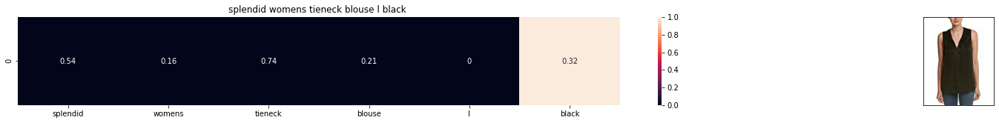

ASIN : B0716F4X2L
BRAND : Splendid
Eucliden distance from the given image : 1.3748714222550324


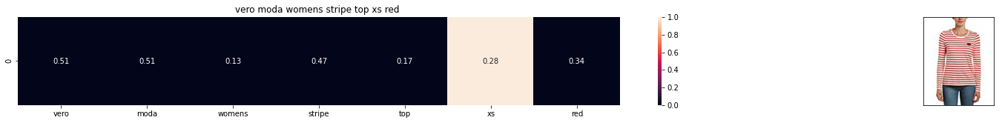

ASIN : B071GTYW32
BRAND : VERO MODA
Eucliden distance from the given image : 1.3749078201786464


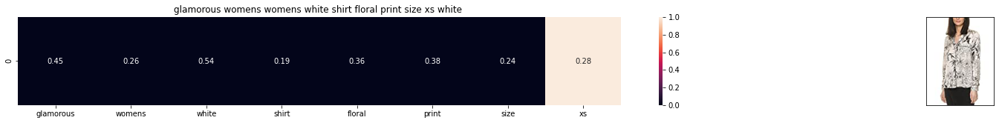

ASIN : B06XRT9ZQJ
BRAND : Glamorous
Eucliden distance from the given image : 1.3755627269661674


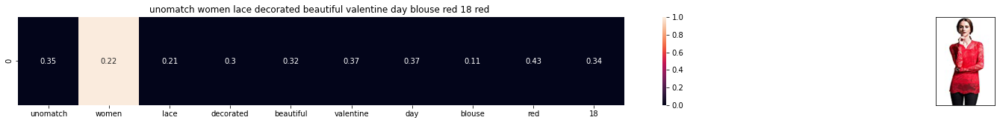

ASIN : B01MZFZ0QS
BRAND : Unomatch
Eucliden distance from the given image : 1.3756620990682755


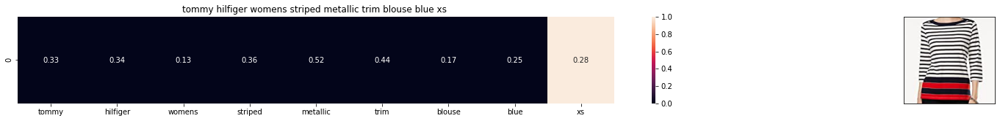

ASIN : B0759S9HNR
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.3757420854882834


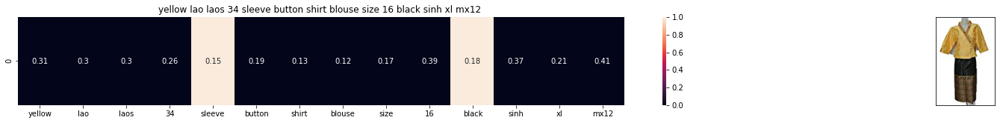

ASIN : B074KZFGLK
BRAND : Nanon
Eucliden distance from the given image : 1.375757750657432


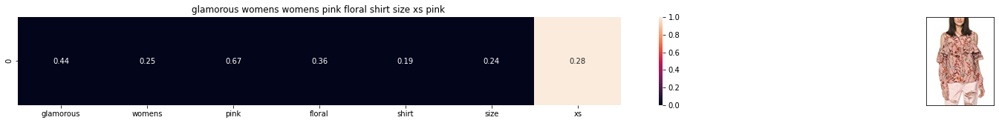

ASIN : B06XRSH45D
BRAND : Glamorous
Eucliden distance from the given image : 1.3760173190779266


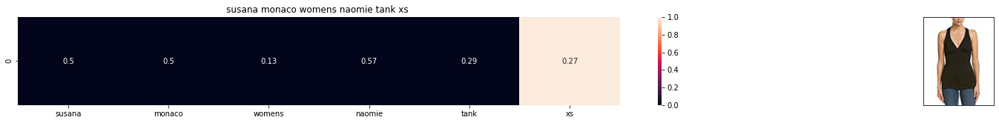

ASIN : B072R518Q1
BRAND : susana monaco
Eucliden distance from the given image : 1.3762015842308413


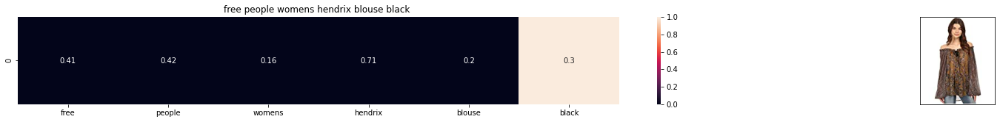

ASIN : B01DBEHXNI
BRAND : Free People
Eucliden distance from the given image : 1.3763438258354486


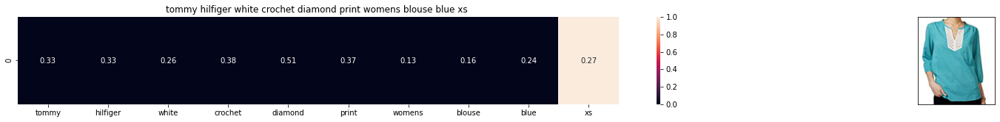

ASIN : B072126WLJ
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.3764343796756535


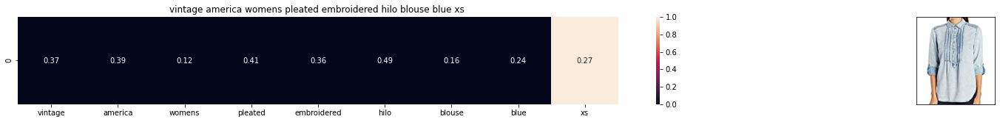

ASIN : B01L703YC2
BRAND : Vintage America
Eucliden distance from the given image : 1.3767023754078505


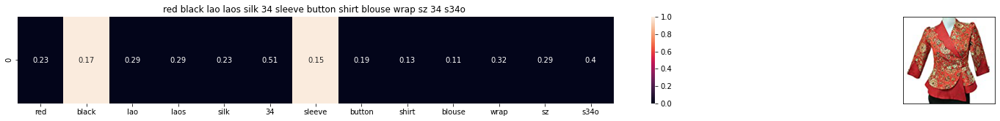

ASIN : B06XG6HCZJ
BRAND : Nanon
Eucliden distance from the given image : 1.3767464382474808


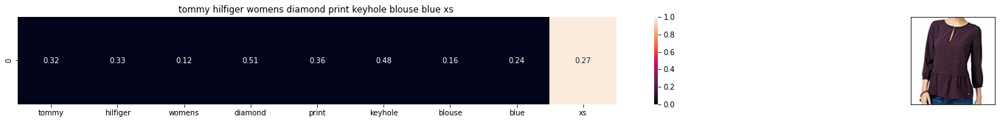

ASIN : B0759QV89G
BRAND : Tommy Hilfiger
Eucliden distance from the given image : 1.3768145354576822


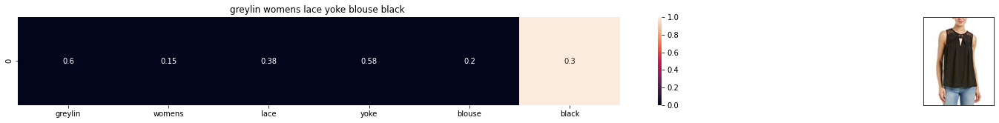

ASIN : B071XD23M5
BRAND : Greylin
Eucliden distance from the given image : 1.3771629213279672


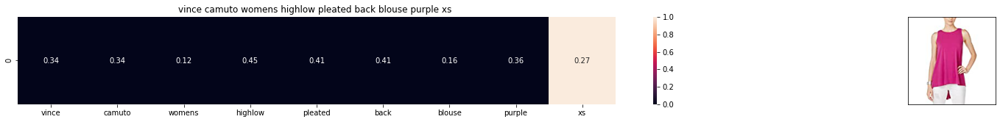

ASIN : B071KZ2PGN
BRAND : Vince Camuto
Eucliden distance from the given image : 1.377253211296665


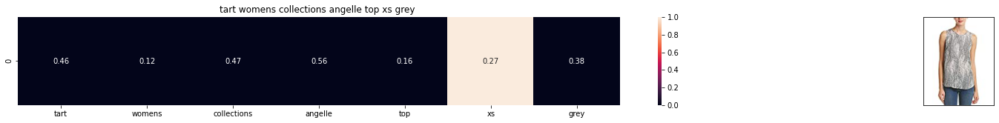

ASIN : B06ZZV4XXV
BRAND : Tart Collections
Eucliden distance from the given image : 1.3772934175918714


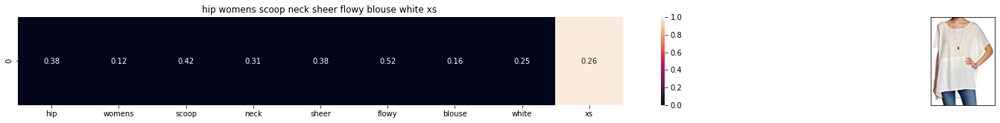

ASIN : B01MUROKWF
BRAND : Hip
Eucliden distance from the given image : 1.3779455134290564


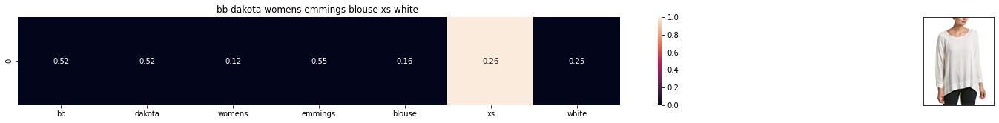

ASIN : B01MZ5CCUV
BRAND : BB Dakota
Eucliden distance from the given image : 1.378036082690921


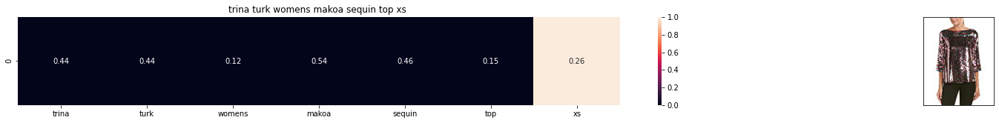

ASIN : B074F58H9Z
BRAND : Trina Turk
Eucliden distance from the given image : 1.3783762670738529


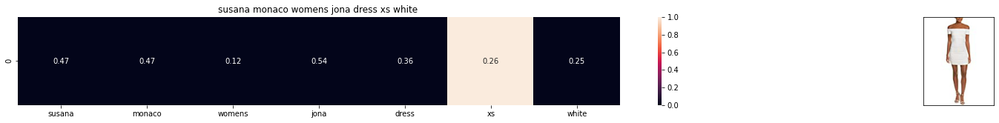

ASIN : B0753KQJ2H
BRAND : susana monaco
Eucliden distance from the given image : 1.3785950395310733


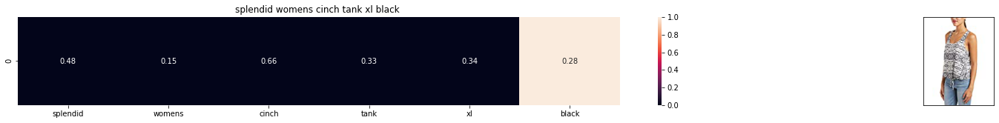

ASIN : B01N809GBN
BRAND : Splendid
Eucliden distance from the given image : 1.3788551977584624


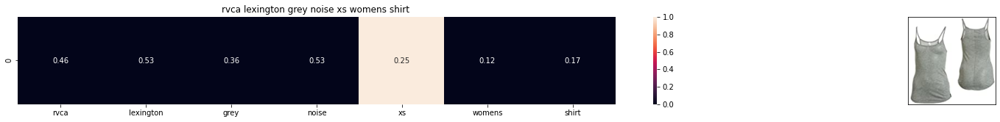

ASIN : B004TKDJBY
BRAND : RVCA
Eucliden distance from the given image : 1.3794323560774646


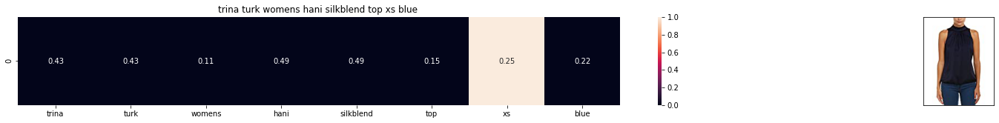

ASIN : B07575F1NR
BRAND : Trina Turk
Eucliden distance from the given image : 1.3796082626411559


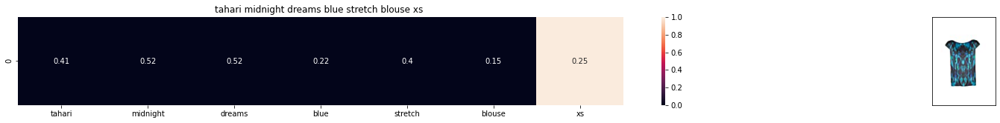

ASIN : B074VBVJ32
BRAND : T Tahari
Eucliden distance from the given image : 1.3797987729726706


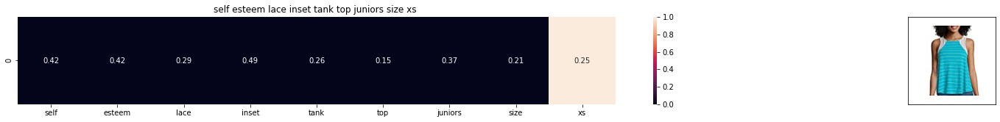

ASIN : B01N2MN3M7
BRAND : Self Esteem
Eucliden distance from the given image : 1.379838593071704


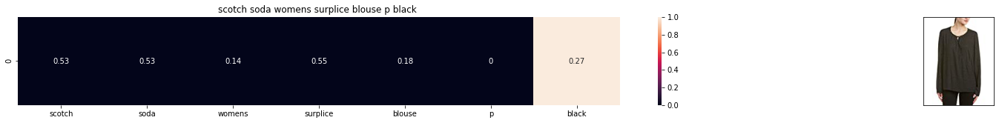

ASIN : B00VTPHIH8
BRAND : Scotch & Soda
Eucliden distance from the given image : 1.3803444972060828


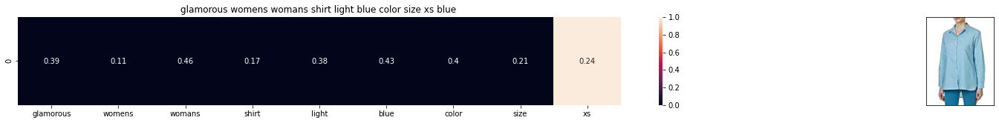

ASIN : B019DL6HJ4
BRAND : Glamorous
Eucliden distance from the given image : 1.3805014821764514


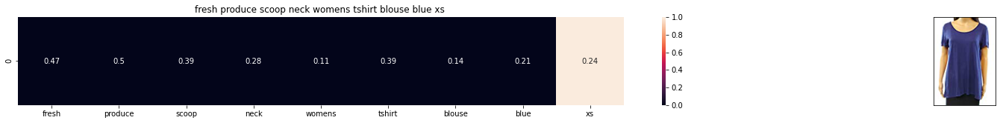

ASIN : B073VSBT6R
BRAND : Fresh Produce
Eucliden distance from the given image : 1.3809370370735898


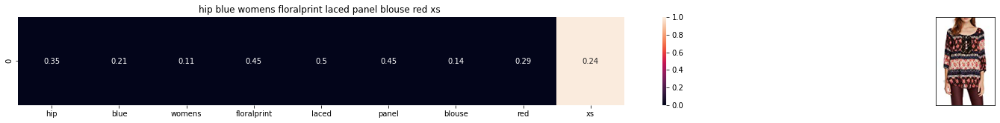

ASIN : B071P49P22
BRAND : Hip
Eucliden distance from the given image : 1.3810493943943258


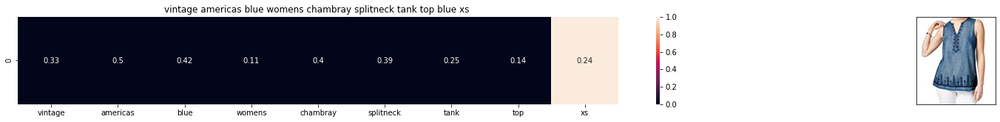

ASIN : B0721XZZNJ
BRAND : Vintage America Blues
Eucliden distance from the given image : 1.3812057878283475


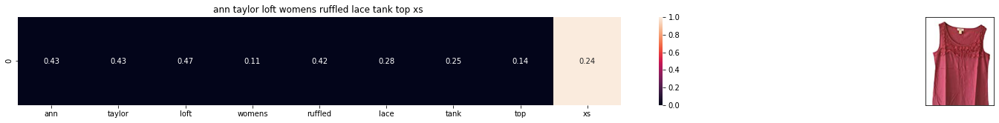

ASIN : B072WMN2PR
BRAND : Ann Taylor LOFT
Eucliden distance from the given image : 1.3812194253120031


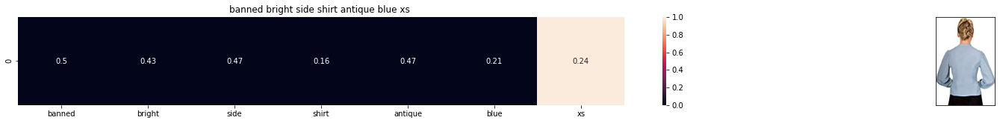

ASIN : B017NU1G6G
BRAND : Banned
Eucliden distance from the given image : 1.3813439554226266


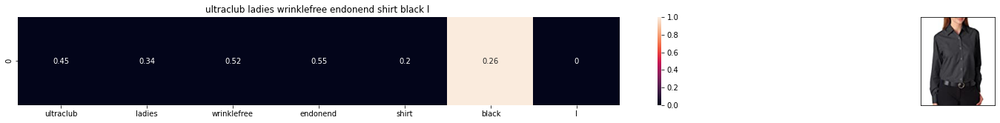

ASIN : B008LT16KU
BRAND : UltraClub
Eucliden distance from the given image : 1.3813921106867755


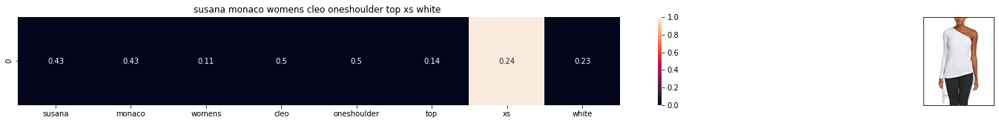

ASIN : B0753K3549
BRAND : susana monaco
Eucliden distance from the given image : 1.381488996167514


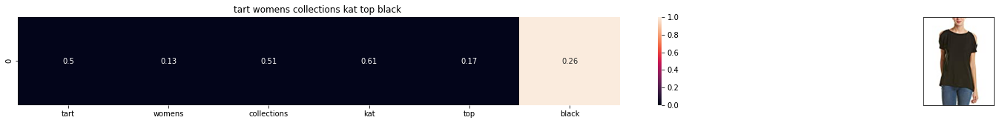

ASIN : B071QZQ29M
BRAND : Tart Collections
Eucliden distance from the given image : 1.3817178157140133


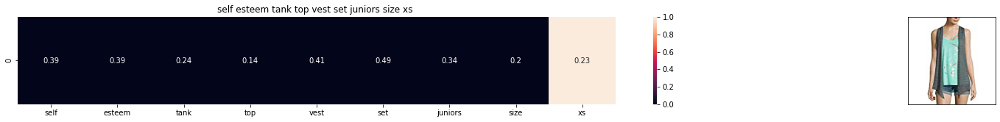

ASIN : B06XV5L5J8
BRAND : Self Esteem
Eucliden distance from the given image : 1.3820423516040492


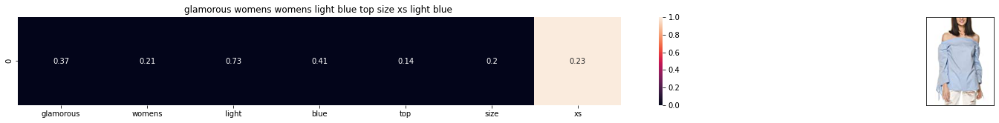

ASIN : B06XRSMGM7
BRAND : Glamorous
Eucliden distance from the given image : 1.3821429078975846


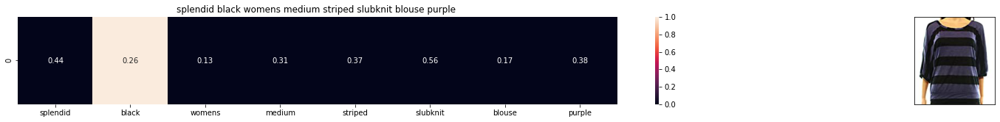

ASIN : B074T32Q3N
BRAND : Splendid
Eucliden distance from the given image : 1.382359525640133


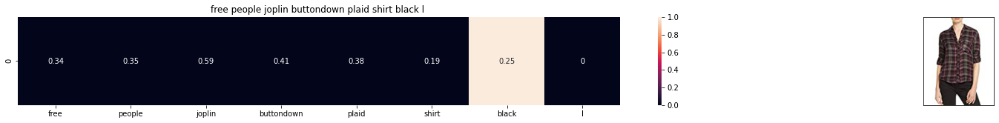

ASIN : B01MXHPJH4
BRAND : Free People
Eucliden distance from the given image : 1.3828111073363545


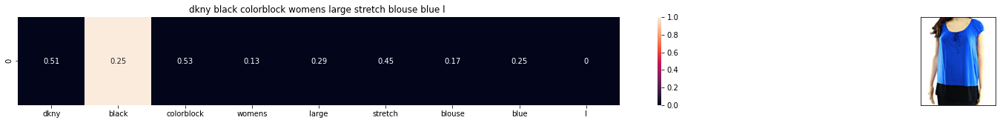

ASIN : B01MRCQ30S
BRAND : DKNY
Eucliden distance from the given image : 1.3828734373445235


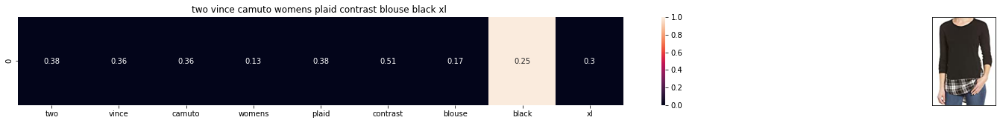

ASIN : B075834CRB
BRAND : Two by Vince Camuto
Eucliden distance from the given image : 1.3829308412352197


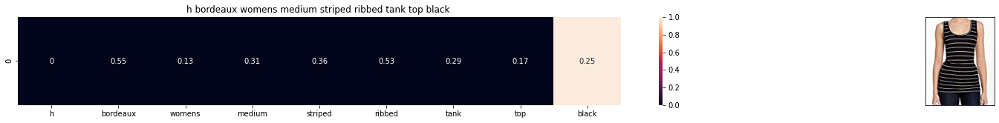

ASIN : B07574D8KQ
BRAND : H By Bordeaux
Eucliden distance from the given image : 1.3830236014986934


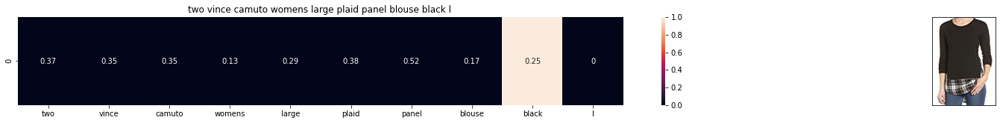

ASIN : B0757YRT74
BRAND : Two by Vince Camuto
Eucliden distance from the given image : 1.3831601969863458


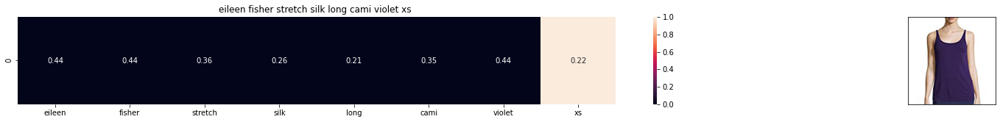

ASIN : B01LY34YPS
BRAND : VERO MODA
Eucliden distance from the given image : 1.3832494928179402


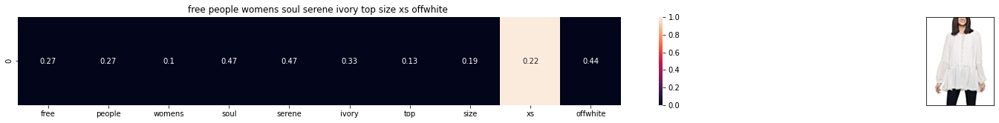

ASIN : B06X9L74YC
BRAND : Free People
Eucliden distance from the given image : 1.3834061414311052


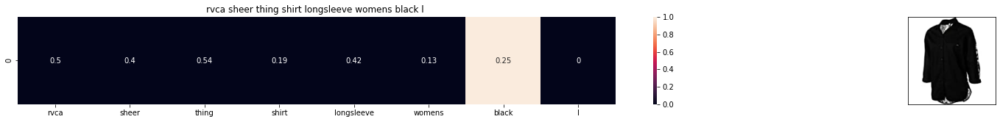

ASIN : B009WWL966
BRAND : RVCA
Eucliden distance from the given image : 1.3834350595520744


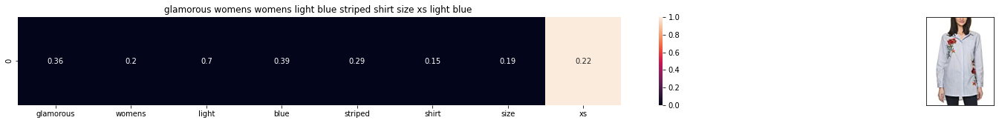

ASIN : B06XRT9WKP
BRAND : Glamorous
Eucliden distance from the given image : 1.3836146098866786


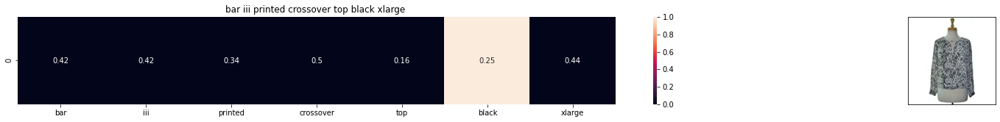

ASIN : B0751TJM3P
BRAND : Bar III
Eucliden distance from the given image : 1.3837007829697026


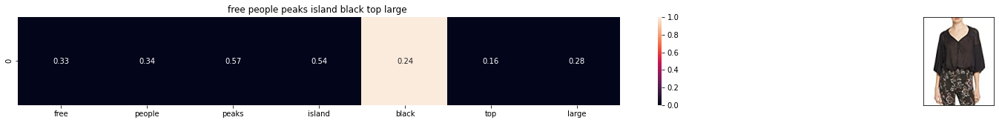

ASIN : B01M1OC0NX
BRAND : Free People
Eucliden distance from the given image : 1.3838459865835466


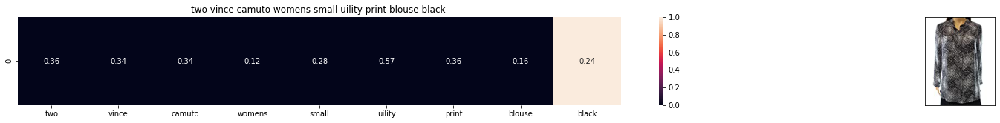

ASIN : B074VCCRYZ
BRAND : Two by Vince Camuto
Eucliden distance from the given image : 1.3841149306872738


In [101]:
def tfidf_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(tfidf_title_features,tfidf_title_features[doc_id])

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])

    for i in range(0,len(indices)):
        # we will pass 1. doc_id, 2. title1, 3. title2, url, model
        get_result(indices[i], data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'tfidf')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('BRAND :',data['brand'].loc[df_indices[i]])
        print ('Eucliden distance from the given image :', pdists[i])
        print('='*125)
tfidf_model(125, 200)
# in the output heat map each value represents the tfidf values of the label word, the color represents the intersection with inputs title

## [8.5] IDF based product similarity

In [0]:
idf_title_vectorizer = CountVectorizer()
idf_title_features = idf_title_vectorizer.fit_transform(data['title'])

# idf_title_features.shape = #data_points * #words_in_corpus
# CountVectorizer().fit_transform(courpus) returns the a sparase matrix of dimensions #data_points * #words_in_corpus
# idf_title_features[doc_id, index_of_word_in_corpus] = number of times the word occured in that doc

In [0]:
def n_containing(word):
    # return the number of documents which had the given word
    return sum(1 for blob in data['title'] if word in blob.split())

def idf(word):
    # idf = log(#number of docs / #number of docs which had the given word)
    return math.log(data.shape[0] / (n_containing(word)))

In [0]:
# we need to convert the values into float
idf_title_features  = idf_title_features.astype(np.float)

for i in idf_title_vectorizer.vocabulary_.keys():
    # for every word in whole corpus we will find its idf value
    idf_val = idf(i)
    
    # to calculate idf_title_features we need to replace the count values with the idf values of the word
    # idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0] will return all documents in which the word i present
    for j in idf_title_features[:, idf_title_vectorizer.vocabulary_[i]].nonzero()[0]:
        
        # we replace the count values of word i in document j with  idf_value of word i 
        # idf_title_features[doc_id, index_of_word_in_courpus] = idf value of word
        idf_title_features[j,idf_title_vectorizer.vocabulary_[i]] = idf_val
        

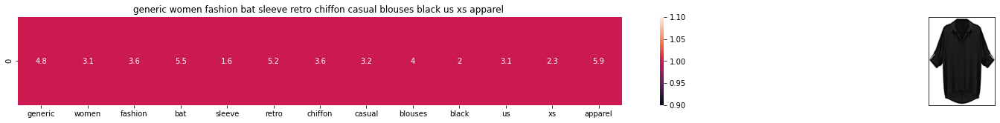

ASIN : B019MDNF8Y
Brand : Absolutely
euclidean distance from the given image : 0.0


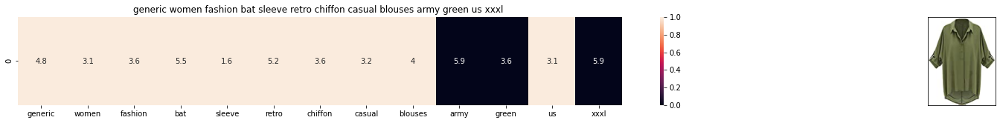

ASIN : B019MDNNHC
Brand : Absolutely
euclidean distance from the given image : 11.225453084813646


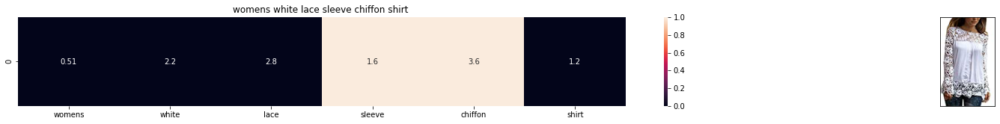

ASIN : B073JWSM1V
Brand : Fuming
euclidean distance from the given image : 14.035054515358887


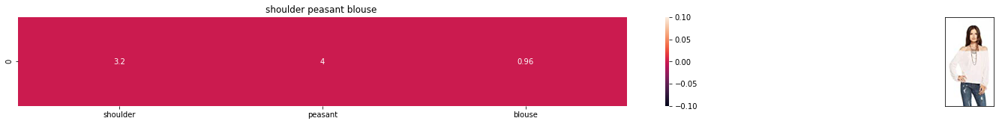

ASIN : B01E1QD5PK
Brand : CHASER
euclidean distance from the given image : 14.996642161307195


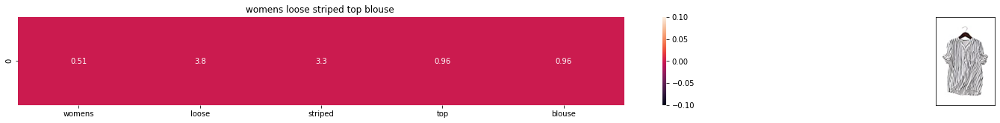

ASIN : B00ZZMYBRG
Brand : HP-LEISURE
euclidean distance from the given image : 15.012981695005534


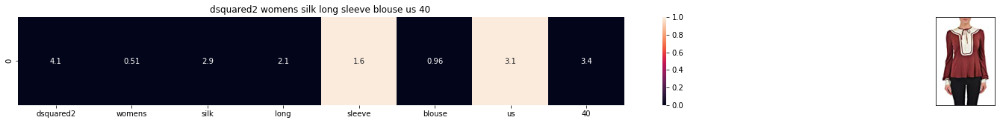

ASIN : B01759GD18
Brand : DSQUARED2
euclidean distance from the given image : 15.125230486749636


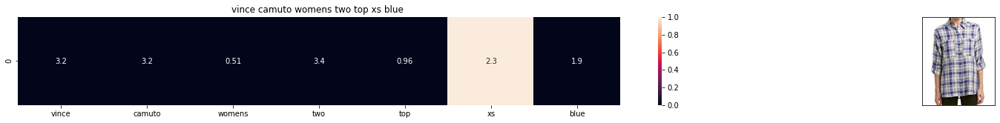

ASIN : B01N7BNEV4
Brand : Two by Vince Camuto
euclidean distance from the given image : 15.15963597306466


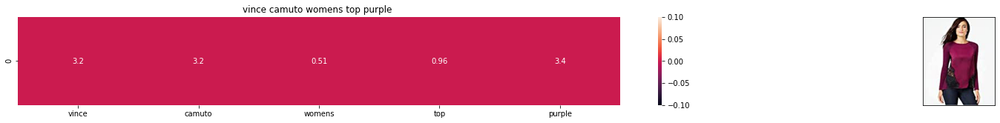

ASIN : B01LFVWUDC
Brand : Two by Vince Camuto
euclidean distance from the given image : 15.213388790772589


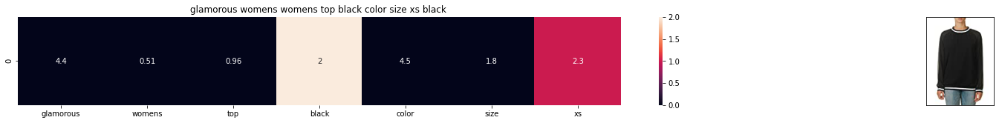

ASIN : B01LWXT1BI
Brand : Glamorous
euclidean distance from the given image : 15.252296020160575


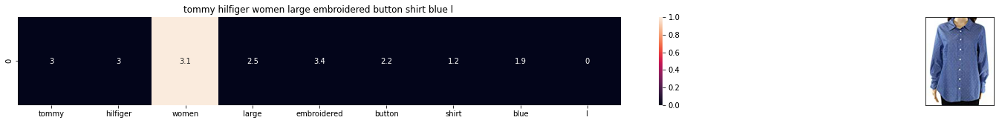

ASIN : B0759NH3ZR
Brand : Tommy Hilfiger
euclidean distance from the given image : 15.269025014648884


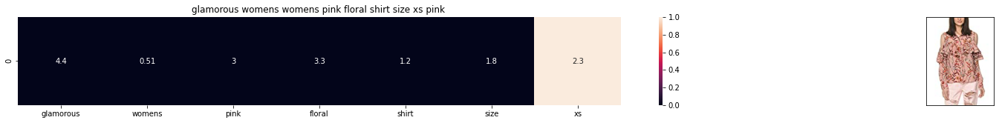

ASIN : B06XRSH45D
Brand : Glamorous
euclidean distance from the given image : 15.391305467575465


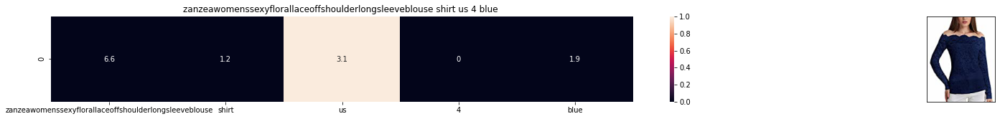

ASIN : B01192N6GC
Brand : ZANZEA
euclidean distance from the given image : 15.393237446776995


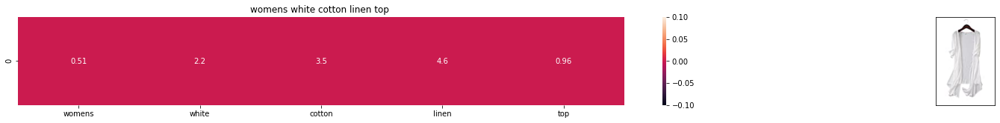

ASIN : B00ZZPR4Y0
Brand : HP-LEISURE
euclidean distance from the given image : 15.415504738555374


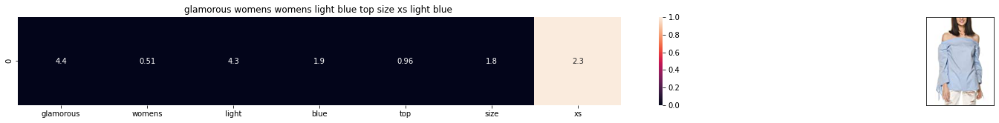

ASIN : B06XRSMGM7
Brand : Glamorous
euclidean distance from the given image : 15.434131655219595


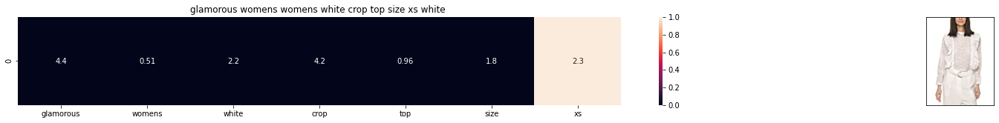

ASIN : B06XRM66GP
Brand : Glamorous
euclidean distance from the given image : 15.442030030516175


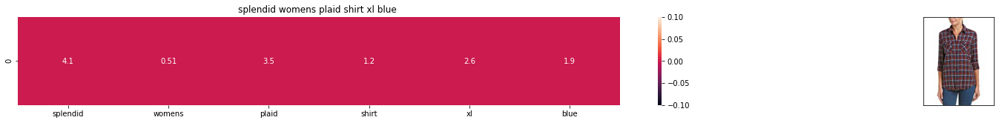

ASIN : B072KNKP98
Brand : Splendid
euclidean distance from the given image : 15.461130879009755


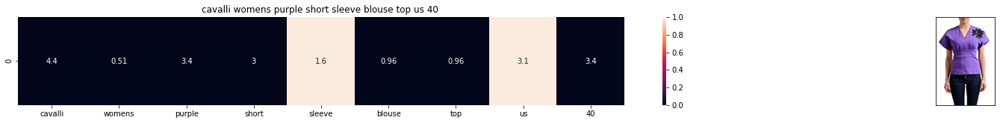

ASIN : B01CAU74LK
Brand : Just Cavalli
euclidean distance from the given image : 15.488349003309034


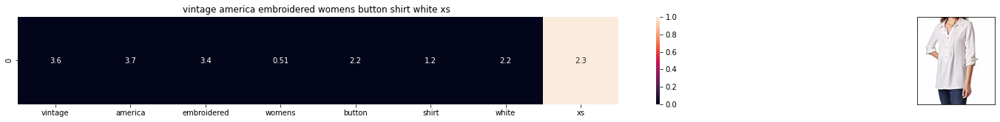

ASIN : B01LYEG8DN
Brand : Vintage America
euclidean distance from the given image : 15.56026940986466


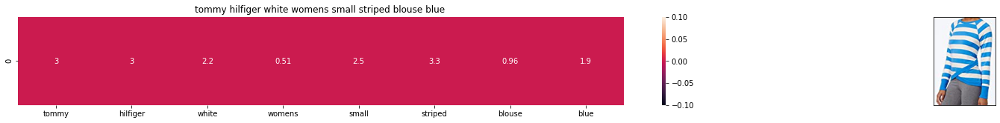

ASIN : B0759NSBV6
Brand : Tommy Hilfiger
euclidean distance from the given image : 15.567643749743507


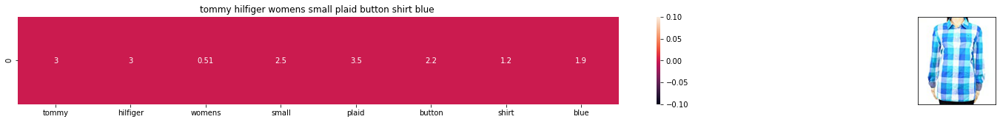

ASIN : B0759NSBCL
Brand : Tommy Hilfiger
euclidean distance from the given image : 15.641980369918548


In [106]:
def idf_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(idf_title_features,idf_title_features[doc_id])

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])

    for i in range(0,len(indices)):
        get_result(indices[i],data['title'].loc[df_indices[0]], data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], 'idf')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print ('euclidean distance from the given image :', pdists[i])
        print('='*125)

        
        
idf_model(125,20)
# in the output heat map each value represents the idf values of the label word, the color represents the intersection with inputs title

# [9] Text Semantics based product similarity

In [107]:

# credits: https://www.kaggle.com/c/word2vec-nlp-tutorial#part-2-word-vectors
# Custom Word2Vec using your own text data.
# Do NOT RUN this code.
# It is meant as a reference to build your own Word2Vec when you have 
# lots of data.

'''
# Set values for various parameters
num_features = 300    # Word vector dimensionality                      
min_word_count = 1    # Minimum word count                        
num_workers = 4       # Number of threads to run in parallel
context = 10          # Context window size                                                                                    
downsampling = 1e-3   # Downsample setting for frequent words

# Initialize and train the model (this will take some time)
from gensim.models import word2vec
print ("Training model...")
model = word2vec.Word2Vec(sen_corpus, workers=num_workers, \
            size=num_features, min_count = min_word_count, \
            window = context)
    
'''

'\n# Set values for various parameters\nnum_features = 300    # Word vector dimensionality                      \nmin_word_count = 1    # Minimum word count                        \nnum_workers = 4       # Number of threads to run in parallel\ncontext = 10          # Context window size                                                                                    \ndownsampling = 1e-3   # Downsample setting for frequent words\n\n# Initialize and train the model (this will take some time)\nfrom gensim.models import word2vec\nprint ("Training model...")\nmodel = word2vec.Word2Vec(sen_corpus, workers=num_workers,             size=num_features, min_count = min_word_count,             window = context)\n    \n'

In [109]:
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
import pickle

# in this project we are using a pretrained model by google
# its 3.3G file, once you load this into your memory 
# it occupies ~9Gb, so please do this step only if you have >12G of ram
# we will provide a pickle file wich contains a dict , 
# and it contains all our courpus words as keys and  model[word] as values
# To use this code-snippet, download "GoogleNews-vectors-negative300.bin" 
# from https://drive.google.com/file/d/0B7XkCwpI5KDYNlNUTTlSS21pQmM/edit
# it's 1.9GB in size.

'''
model = KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)

'''

#if you do NOT have RAM >= 12GB, use the code below.
#with open('word2vec_model', 'rb') as handle:
#    model = pickle.load(handle)


"\nmodel = KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)\n"

In [112]:
ls


 16k_data_cnn_feature_asins.npy  'Installing Python'
 16k_data_cnn_features.npy        pickels/
 16k_images/                      Python_Optional/
 AppliedAIWorkshop.ipynb          tops_fashion.json
 dedupe/                          word2vec_model
 image_similarity_cnn.ipynb


In [0]:
with open('word2vec_model', 'rb') as handle:
    model = pickle.load(handle)

In [0]:
# Utility functions

def get_word_vec(sentence, doc_id, m_name):
    # sentence : title of the apparel
    # doc_id: document id in our corpus
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)
    vec = []
    for i in sentence.split():
        if i in vocab:
            if m_name == 'weighted' and i in  idf_title_vectorizer.vocabulary_:
                vec.append(idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[i]] * model[i])
            elif m_name == 'avg':
                vec.append(model[i])
        else:
            # if the word in our courpus is not there in the google word2vec corpus, we are just ignoring it
            vec.append(np.zeros(shape=(300,)))
    # we will return a numpy array of shape (#number of words in title * 300 ) 300 = len(w2v_model[word])
    # each row represents the word2vec representation of each word (weighted/avg) in given sentance 
    return  np.array(vec)

def get_distance(vec1, vec2):
    # vec1 = np.array(#number_of_words_title1 * 300), each row is a vector of length 300 corresponds to each word in give title
    # vec2 = np.array(#number_of_words_title2 * 300), each row is a vector of length 300 corresponds to each word in give title
    
    final_dist = []
    # for each vector in vec1 we caluclate the distance(euclidean) to all vectors in vec2
    for i in vec1:
        dist = []
        for j in vec2:
            # np.linalg.norm(i-j) will result the euclidean distance between vectors i, j
            dist.append(np.linalg.norm(i-j))
        final_dist.append(np.array(dist))
    # final_dist = np.array(#number of words in title1 * #number of words in title2)
    # final_dist[i,j] = euclidean distance between vectors i, j
    return np.array(final_dist)


def heat_map_w2v(sentence1, sentence2, url, doc_id1, doc_id2, model):
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentence1, doc_id1, model)
    #s2_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentence2, doc_id2, model)

    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)

    
    
    # devide whole figure into 2 parts 1st part displays heatmap 2nd part displays image of apparel
    gs = gridspec.GridSpec(2, 2, width_ratios=[4,1],height_ratios=[2,1]) 
    fig = plt.figure(figsize=(15,15))
    
    ax = plt.subplot(gs[0])
    # ploting the heap map based on the pairwise distances
    ax = sns.heatmap(np.round(s1_s2_dist,4), annot=True)
    # set the x axis labels as recommended apparels title
    ax.set_xticklabels(sentence2.split())
    # set the y axis labels as input apparels title
    ax.set_yticklabels(sentence1.split())
    # set title as recommended apparels title
    ax.set_title(sentence2)
    
    ax = plt.subplot(gs[1])
    # we remove all grids and axis labels for image
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    display_img(url, ax, fig)
    
    plt.show()

In [0]:
# vocab = stores all the words that are there in google w2v model
# vocab = model.wv.vocab.keys() # if you are using Google word2Vec

vocab = model.keys()
# this function will add the vectors of each word and returns the avg vector of given sentance
def build_avg_vec(sentence, num_features, doc_id, m_name):
    # sentace: its title of the apparel
    # num_features: the lenght of word2vec vector, its values = 300
    # m_name: model information it will take two values
        # if  m_name == 'avg', we will append the model[i], w2v representation of word i
        # if m_name == 'weighted', we will multiply each w2v[word] with the idf(word)

    featureVec = np.zeros((num_features,), dtype="float32")
    # we will intialize a vector of size 300 with all zeros
    # we add each word2vec(wordi) to this fetureVec
    nwords = 0
    
    for word in sentence.split():
        nwords += 1
        if word in vocab:
            if m_name == 'weighted' and word in  idf_title_vectorizer.vocabulary_:
                featureVec = np.add(featureVec, idf_title_features[doc_id, idf_title_vectorizer.vocabulary_[word]] * model[word])
            elif m_name == 'avg':
                featureVec = np.add(featureVec, model[word])
    if(nwords>0):
        featureVec = np.divide(featureVec, nwords)
    # returns the avg vector of given sentance, its of shape (1, 300)
    return featureVec

### [9.2] Average Word2Vec product similarity.

In [0]:
doc_id = 0
w2v_title = []
# for every title we build a avg vector representation
for i in data['title']:
    w2v_title.append(build_avg_vec(i, 300, doc_id,'avg'))
    doc_id += 1

# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
w2v_title = np.array(w2v_title)


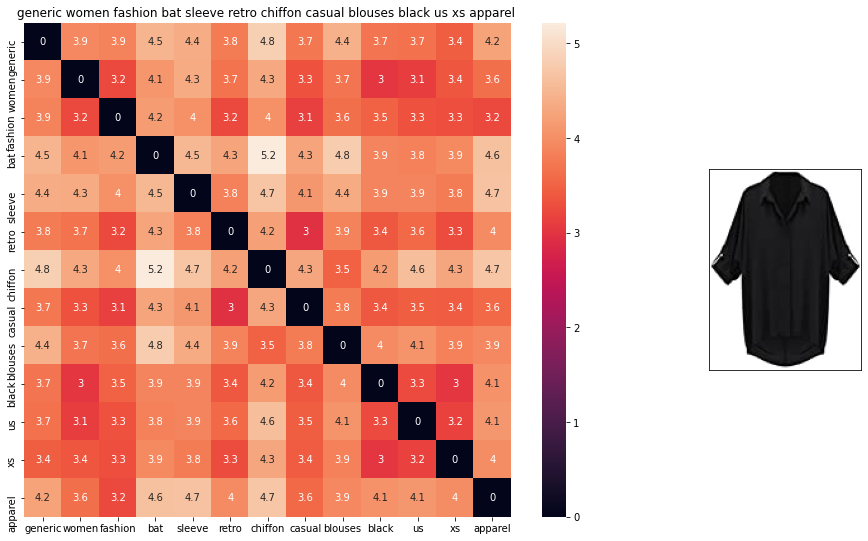

ASIN : B019MDNF8Y
BRAND : Absolutely
euclidean distance from given input image : 2.9802322e-08


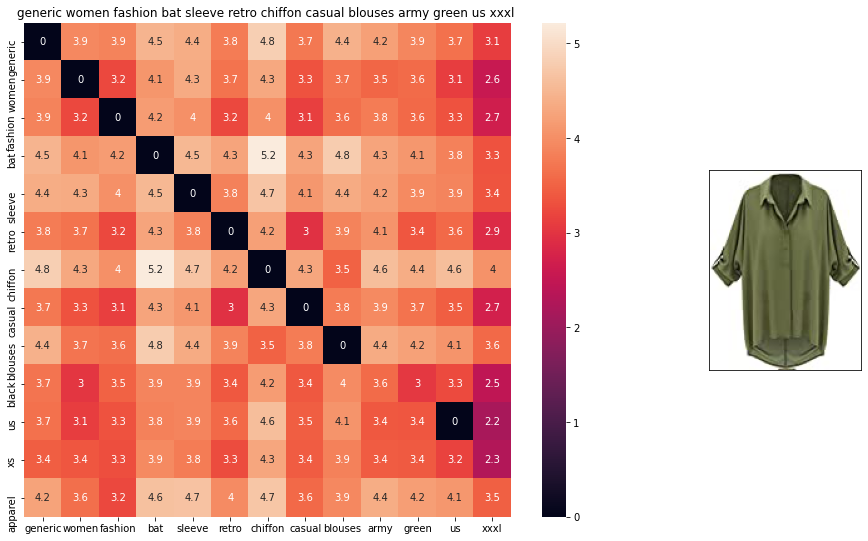

ASIN : B019MDNNHC
BRAND : Absolutely
euclidean distance from given input image : 0.45133635


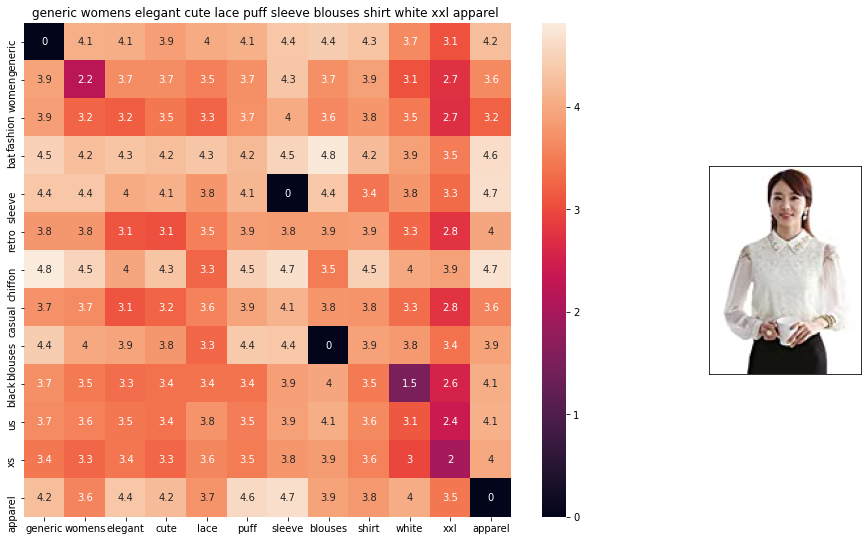

ASIN : B014CF1PC0
BRAND : Absolutely
euclidean distance from given input image : 0.6660588


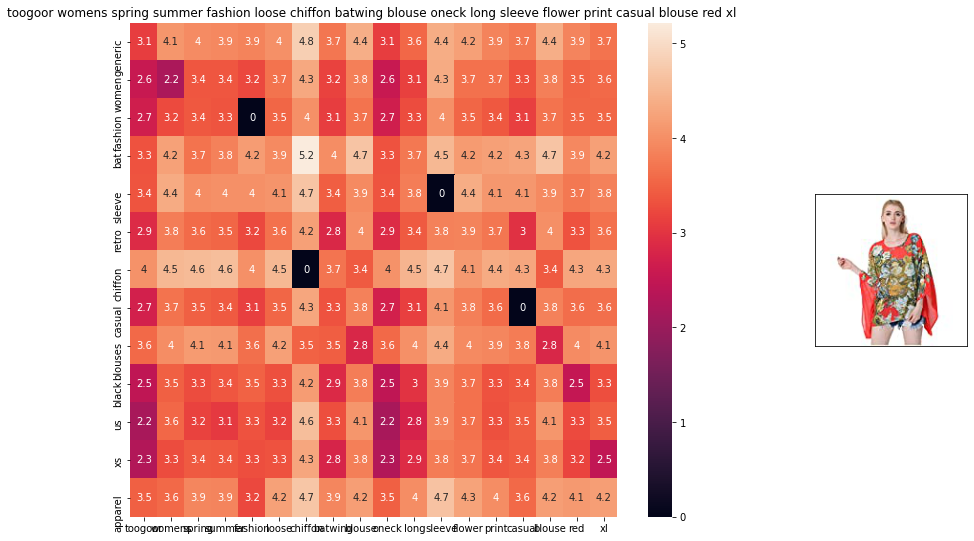

ASIN : B01NCZ9CMF
BRAND : TOOGOO(R)
euclidean distance from given input image : 0.7725227


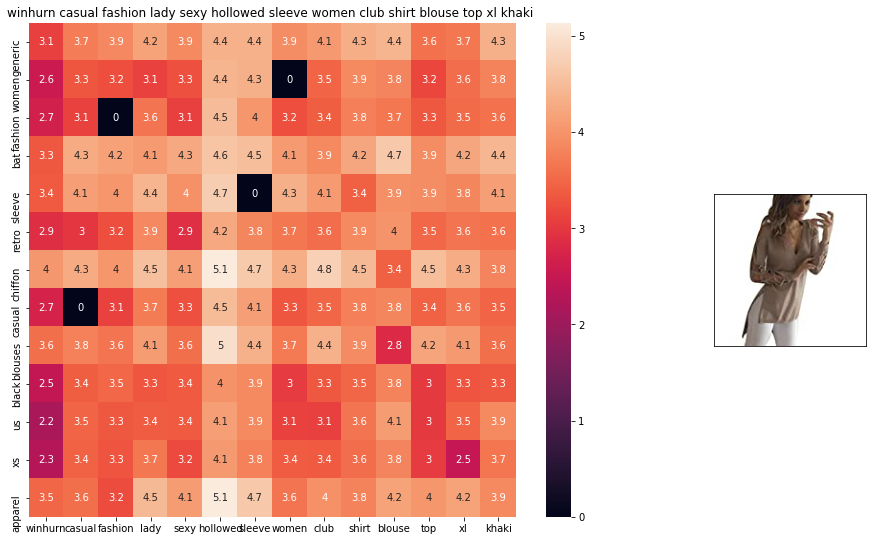

ASIN : B01NAFTMGN
BRAND : Winhurn
euclidean distance from given input image : 0.79831916


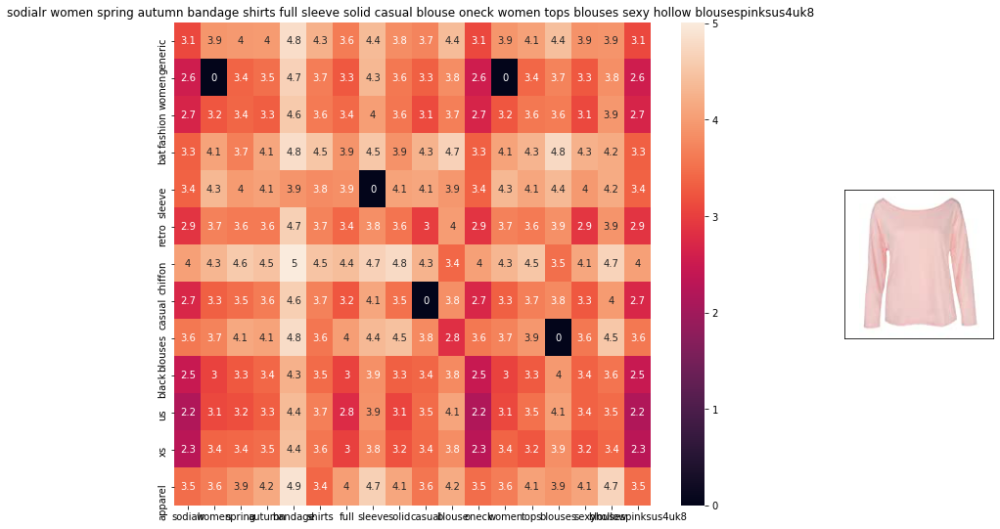

ASIN : B07336178W
BRAND : SODIAL(R)
euclidean distance from given input image : 0.8138817


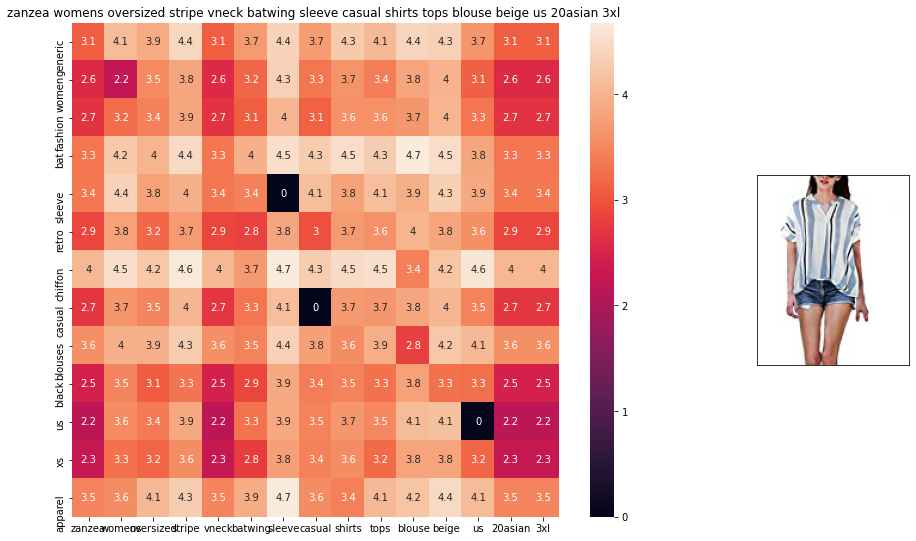

ASIN : B01KJZUDAM
BRAND : ZANZEA
euclidean distance from given input image : 0.8312273


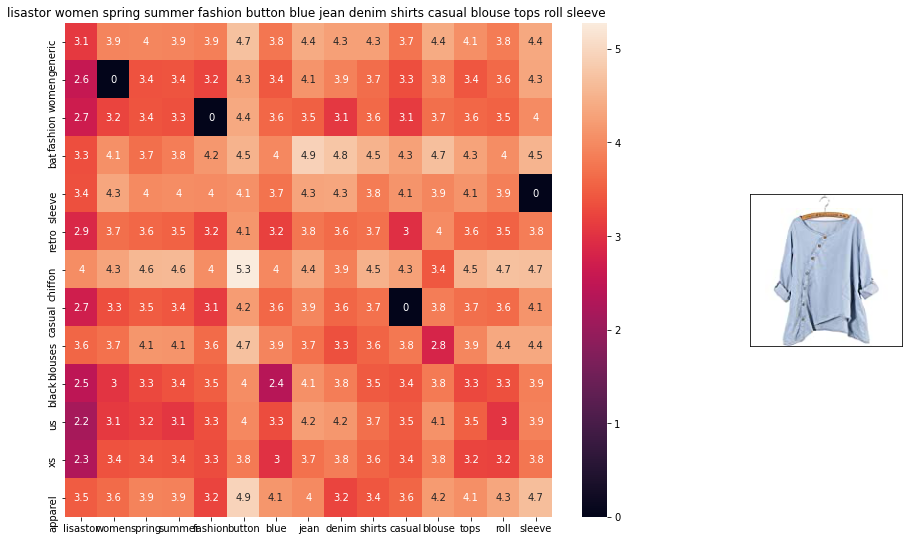

ASIN : B01KV2H7D4
BRAND : LISASTOR
euclidean distance from given input image : 0.839155


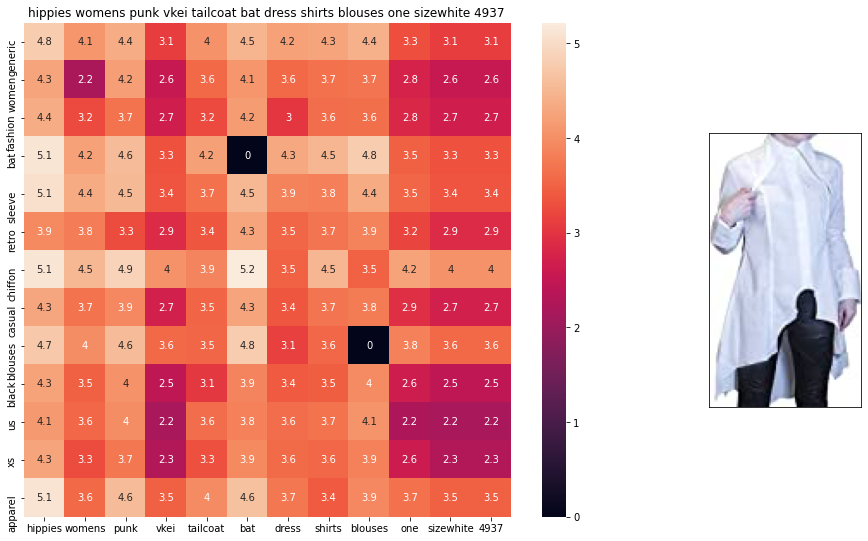

ASIN : B00I2LM57K
BRAND : Hippies
euclidean distance from given input image : 0.8586285


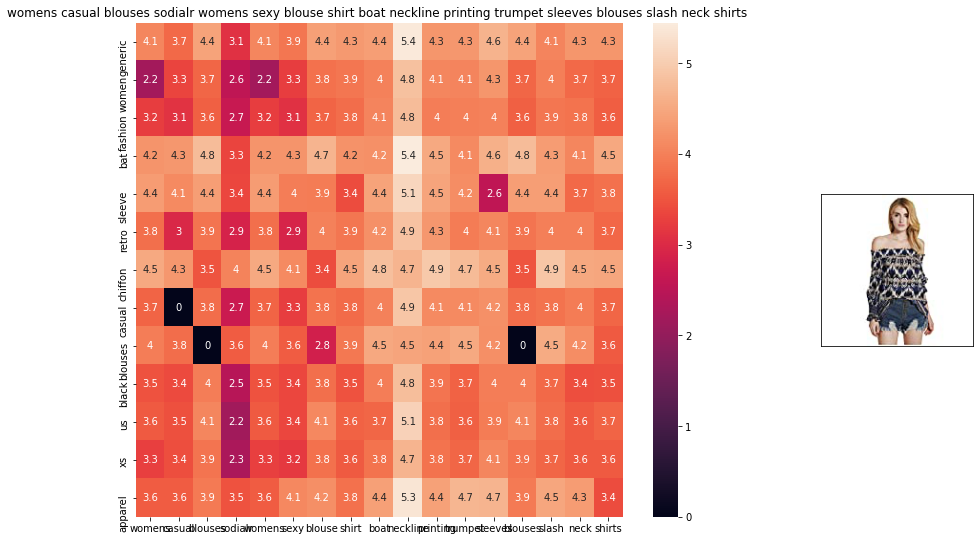

ASIN : B01MZBB7RR
BRAND : SODIAL(R)
euclidean distance from given input image : 0.86487013


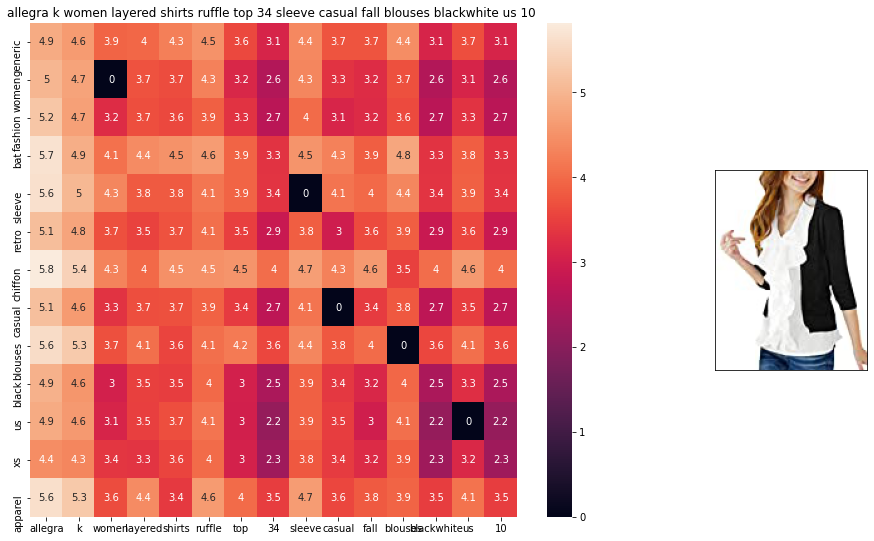

ASIN : B008X1FTI6
BRAND : Allegra K
euclidean distance from given input image : 0.86665064


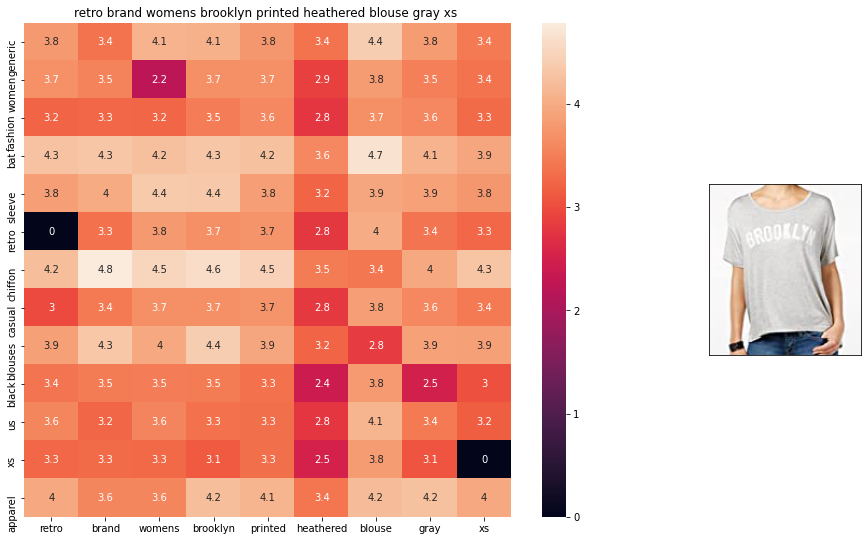

ASIN : B07574CKFL
BRAND : Retro
euclidean distance from given input image : 0.87205476


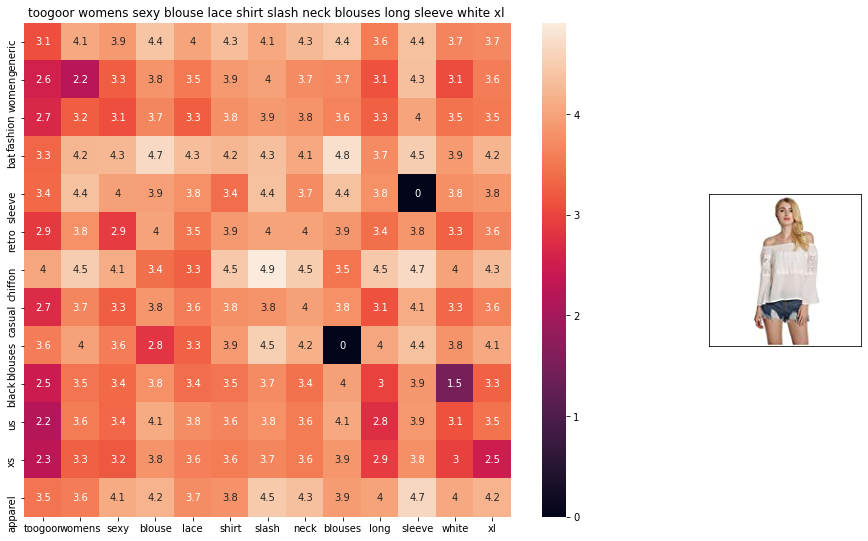

ASIN : B01MSALTPD
BRAND : TOOGOO(R)
euclidean distance from given input image : 0.8739373


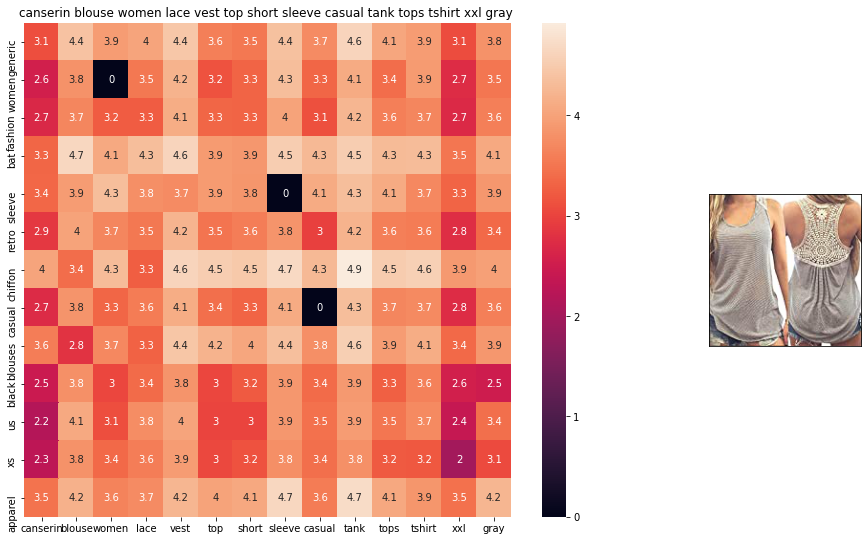

ASIN : B01GNNWE5G
BRAND : Canserin
euclidean distance from given input image : 0.8834457


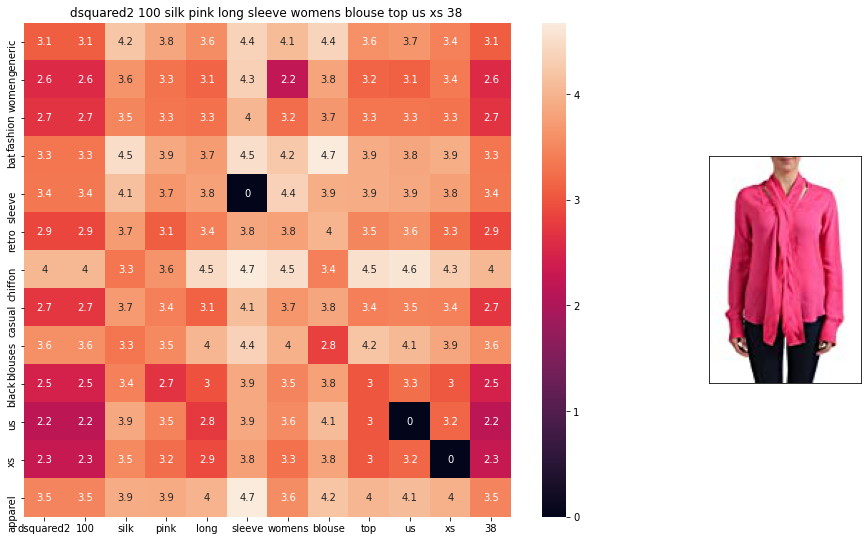

ASIN : B01M087PQ5
BRAND : DSQUARED2
euclidean distance from given input image : 0.8841851


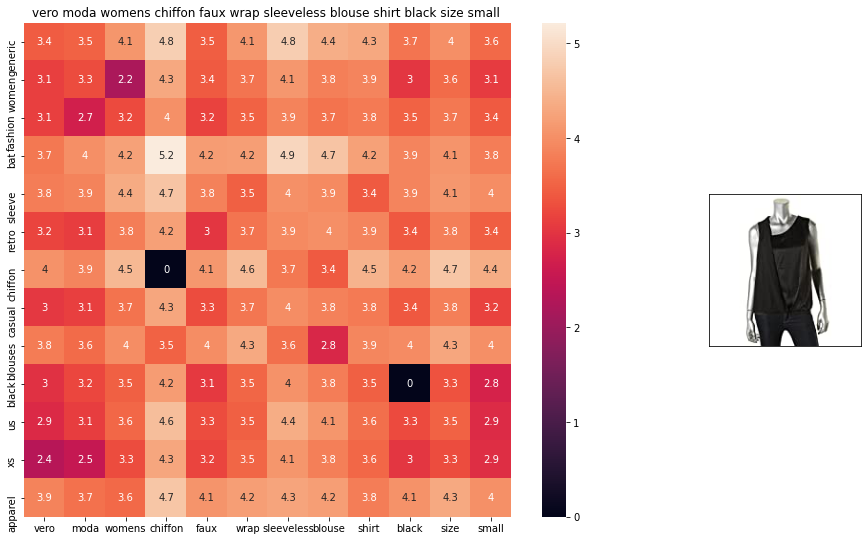

ASIN : B0719JZ1N3
BRAND : VERO MODA
euclidean distance from given input image : 0.8860215


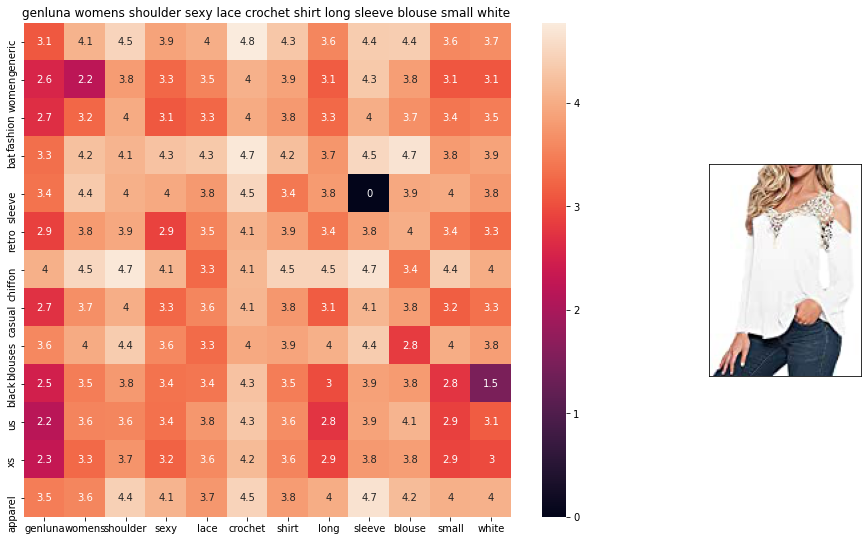

ASIN : B01LZRBG03
BRAND : Genluna
euclidean distance from given input image : 0.8896501


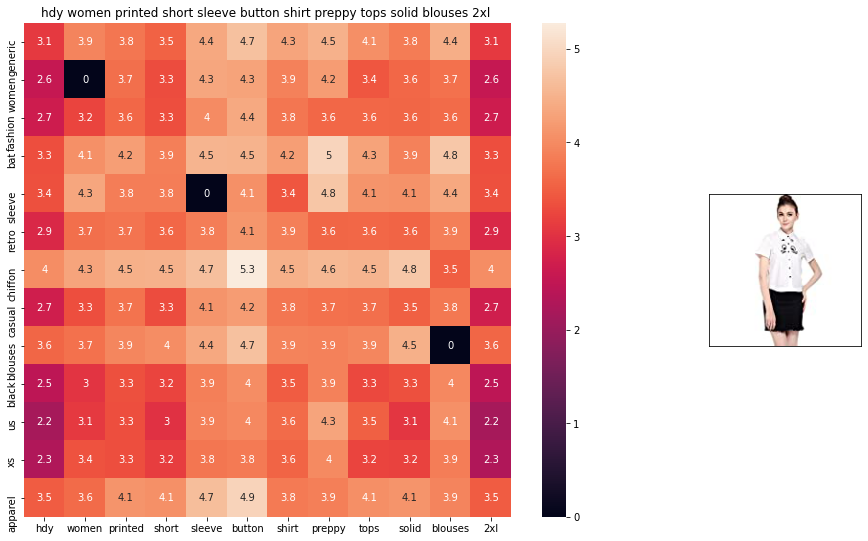

ASIN : B01M9C24GM
BRAND : WeHeart
euclidean distance from given input image : 0.8978197


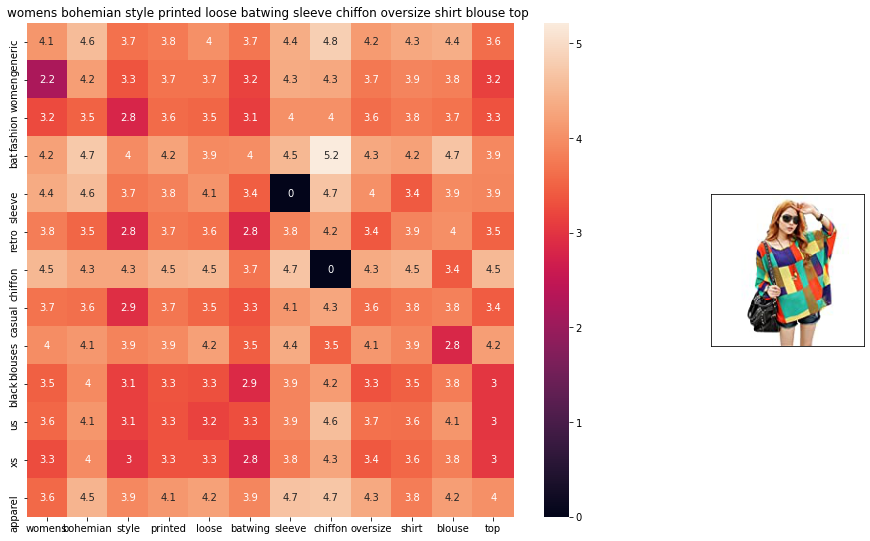

ASIN : B010CO8JQA
BRAND : Sunshine
euclidean distance from given input image : 0.89803106


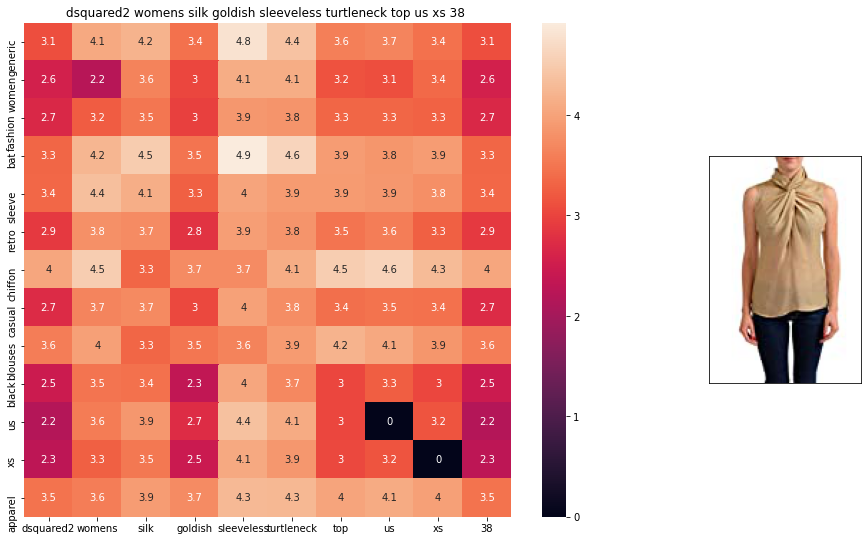

ASIN : B01LBAY4KE
BRAND : DSQUARED2
euclidean distance from given input image : 0.89848036


In [119]:
def avg_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # dist(x, y) = sqrt(dot(x, x) - 2 * dot(x, y) + dot(y, y))
    pairwise_dist = pairwise_distances(w2v_title, w2v_title[doc_id].reshape(1,-1))

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0, len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'avg')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('BRAND :',data['brand'].loc[df_indices[i]])
        print ('euclidean distance from given input image :', pdists[i])
        print('='*125)

        
avg_w2v_model(125, 20)
# in the give heat map, each cell contains the euclidean distance between words i, j

### [9.4]  IDF weighted Word2Vec for product similarity

In [0]:
doc_id = 0
w2v_title_weight = []
# for every title we build a weighted vector representation
for i in data['title']:
    w2v_title_weight.append(build_avg_vec(i, 300, doc_id,'weighted'))
    doc_id += 1
# w2v_title = np.array(# number of doc in courpus * 300), each row corresponds to a doc 
w2v_title_weight = np.array(w2v_title_weight)

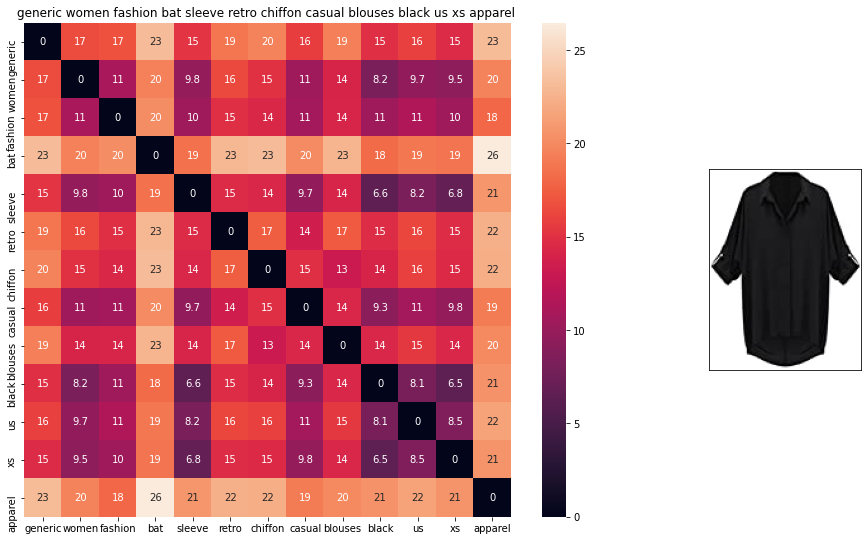

ASIN : B019MDNF8Y
Brand : Absolutely
euclidean distance from input : 0.0


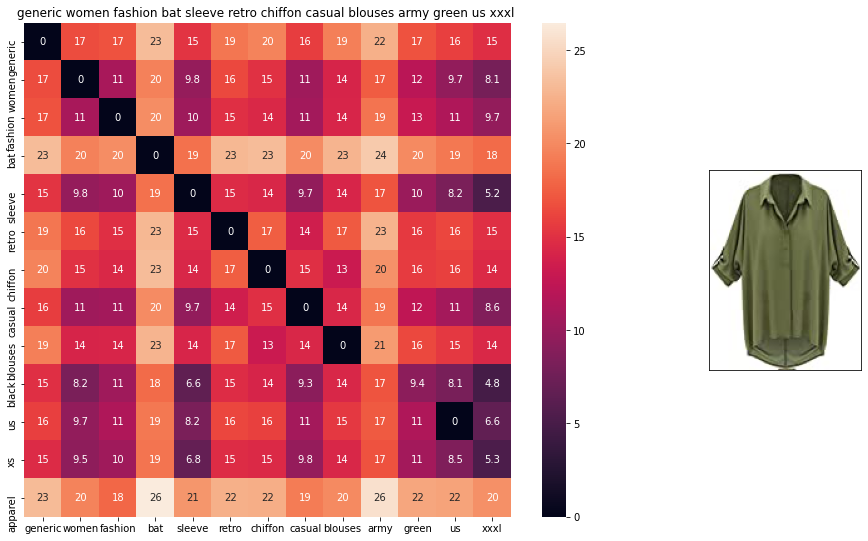

ASIN : B019MDNNHC
Brand : Absolutely
euclidean distance from input : 2.1253362


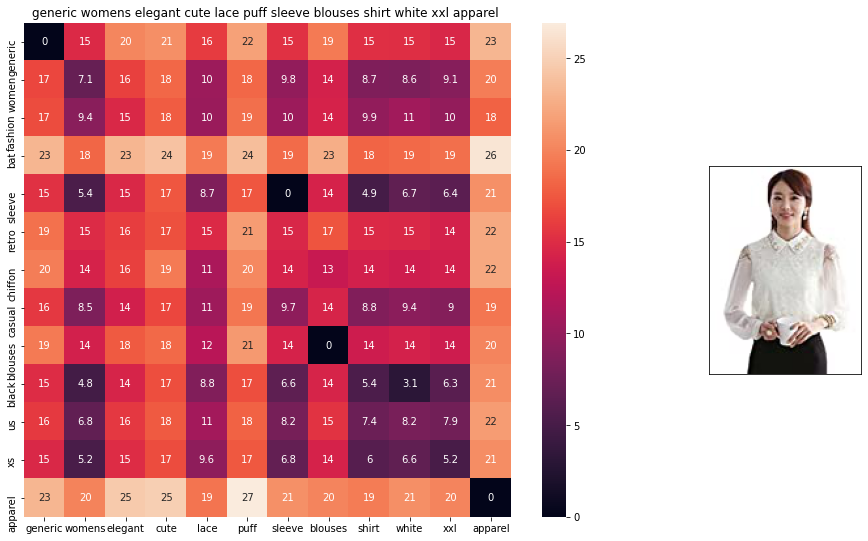

ASIN : B014CF1PC0
Brand : Absolutely
euclidean distance from input : 2.9112022


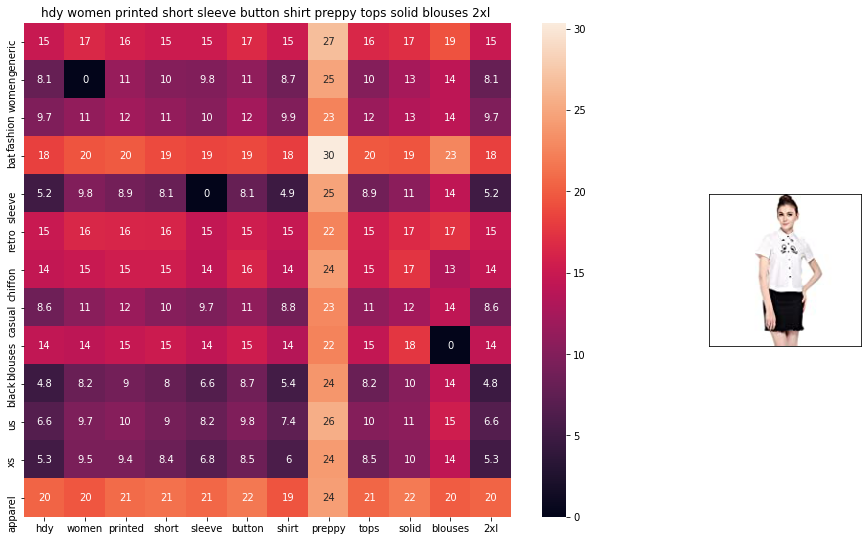

ASIN : B01M9C24GM
Brand : WeHeart
euclidean distance from input : 3.5826116


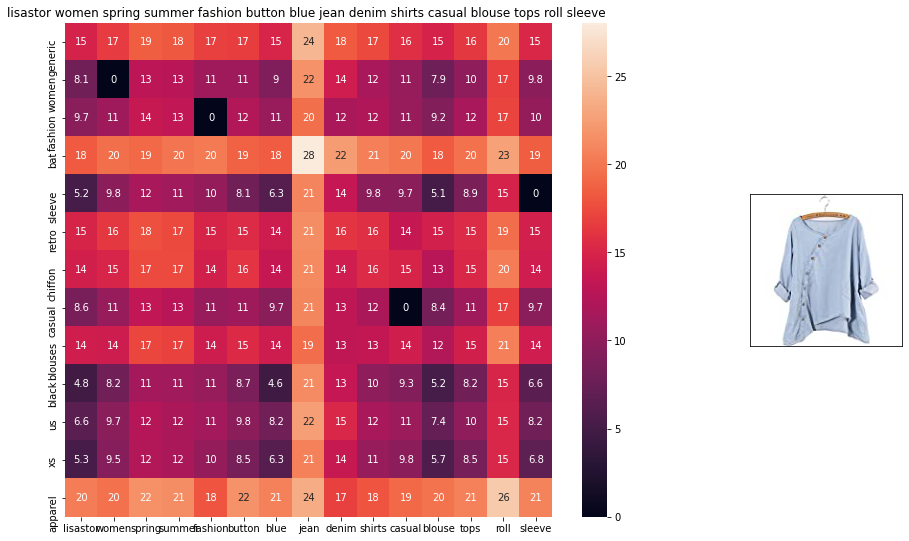

ASIN : B01KV2H7D4
Brand : LISASTOR
euclidean distance from input : 3.6474018


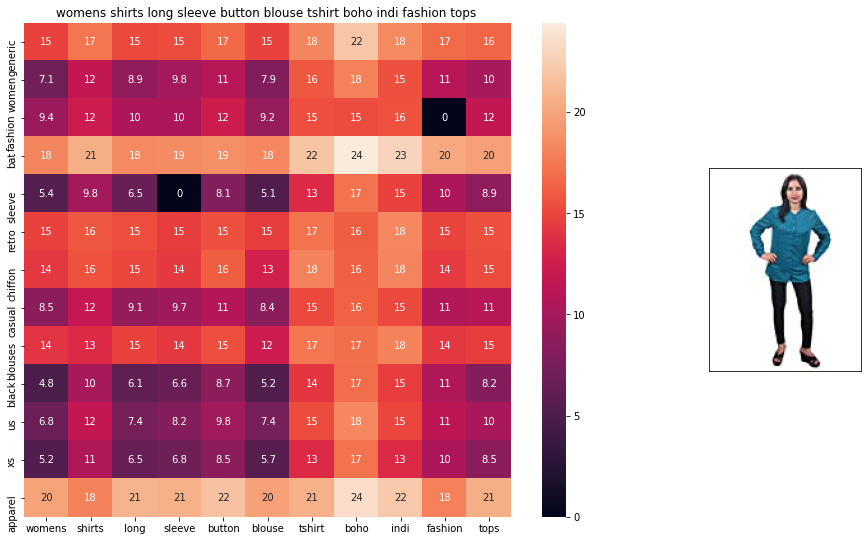

ASIN : B012WI5FES
Brand : Mogul Interior
euclidean distance from input : 3.719793


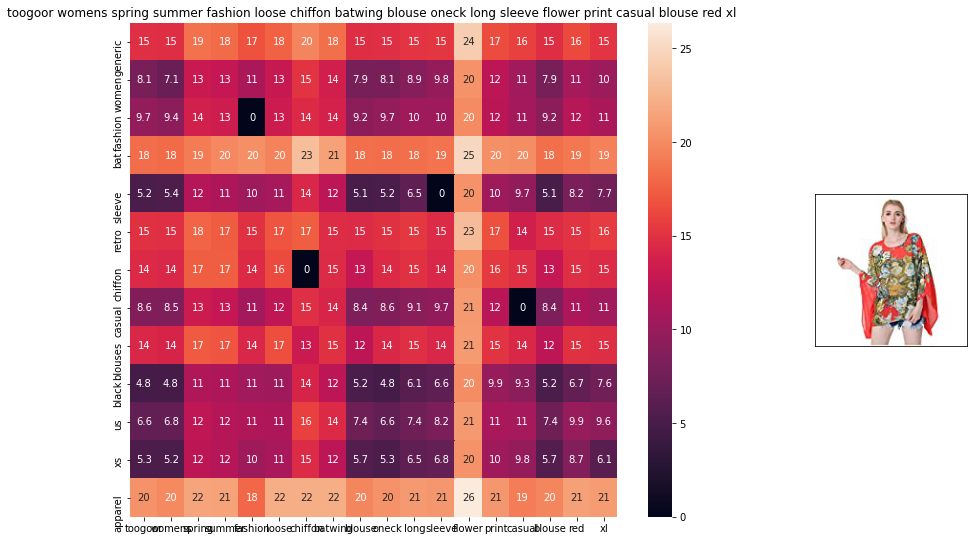

ASIN : B01NCZ9CMF
Brand : TOOGOO(R)
euclidean distance from input : 3.7226815


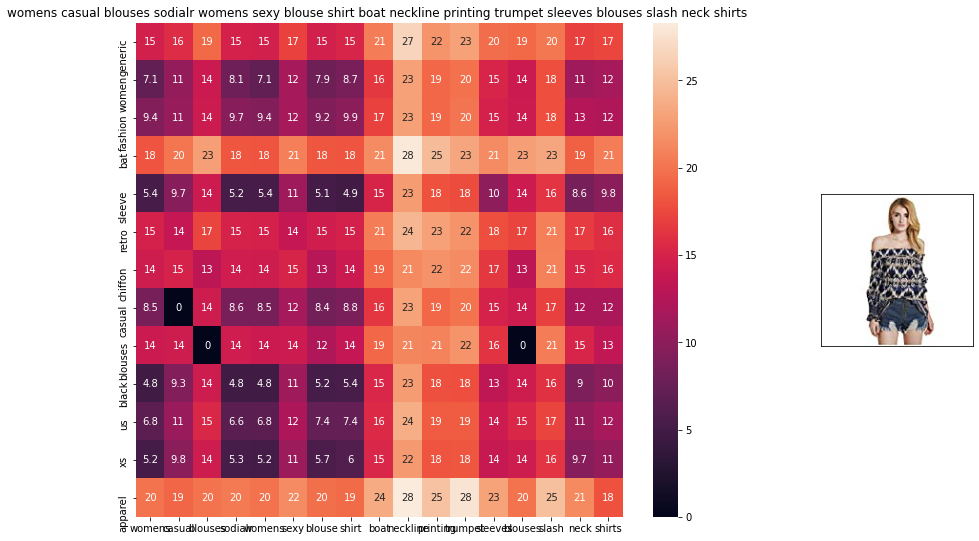

ASIN : B01MZBB7RR
Brand : SODIAL(R)
euclidean distance from input : 3.735971


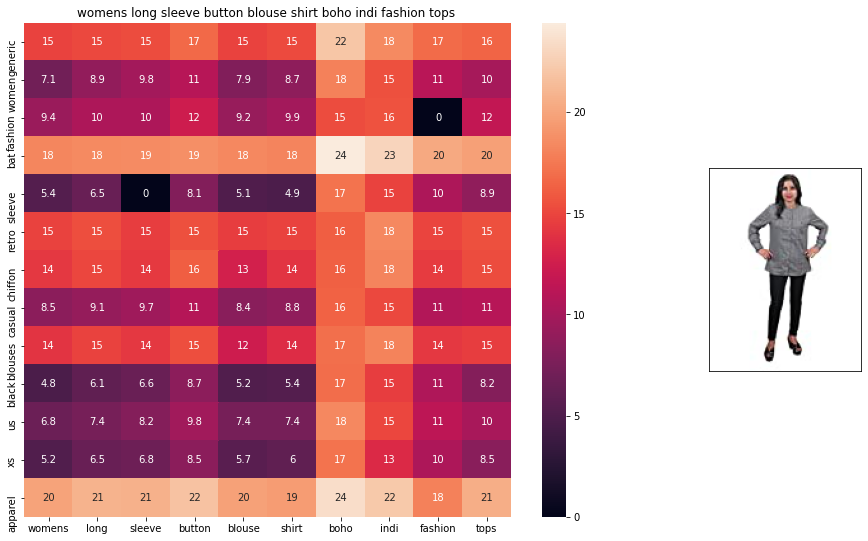

ASIN : B012WGJT6A
Brand : Mogul Interior
euclidean distance from input : 3.7429657


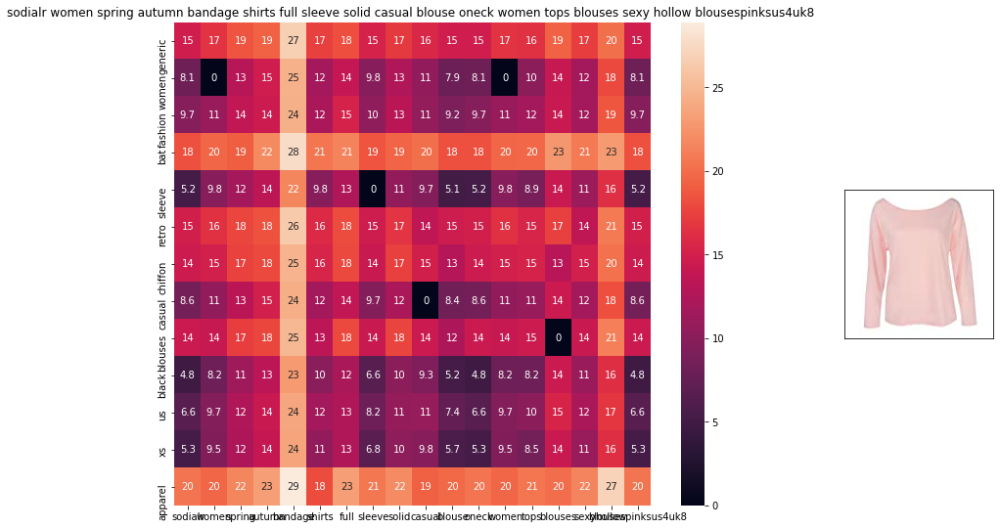

ASIN : B07336178W
Brand : SODIAL(R)
euclidean distance from input : 3.8149722


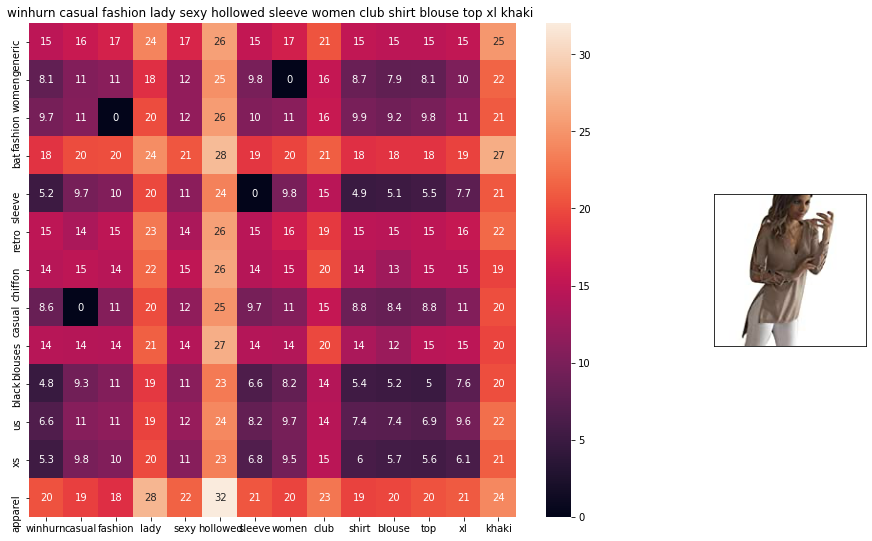

ASIN : B01NAFTMGN
Brand : Winhurn
euclidean distance from input : 3.8348944


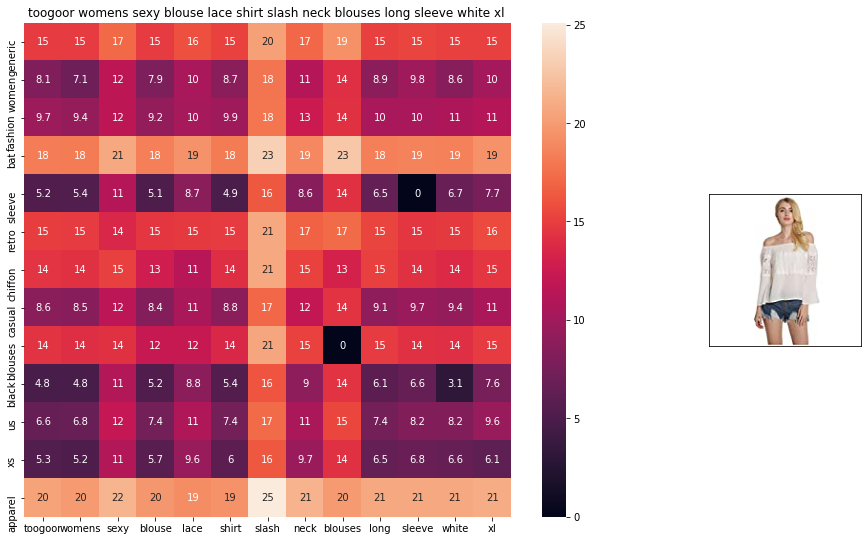

ASIN : B01MSALTPD
Brand : TOOGOO(R)
euclidean distance from input : 3.8504348


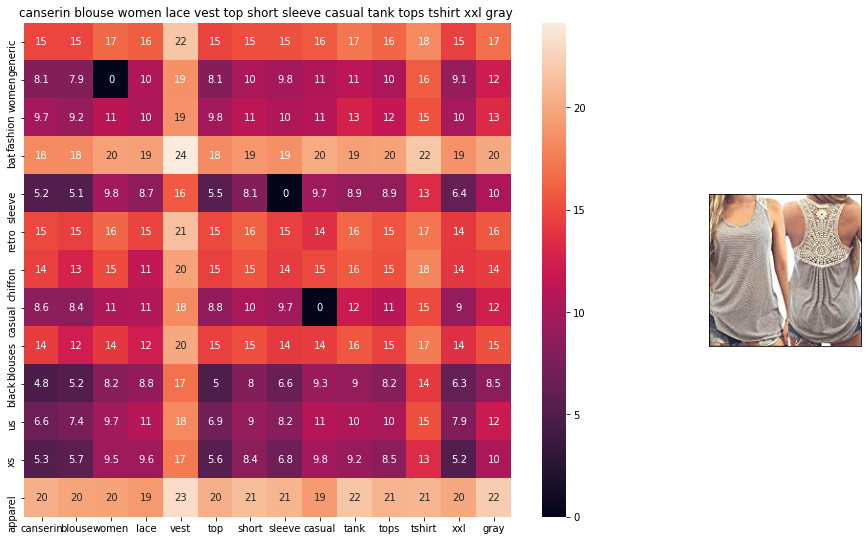

ASIN : B01GNNWE5G
Brand : Canserin
euclidean distance from input : 3.8523252


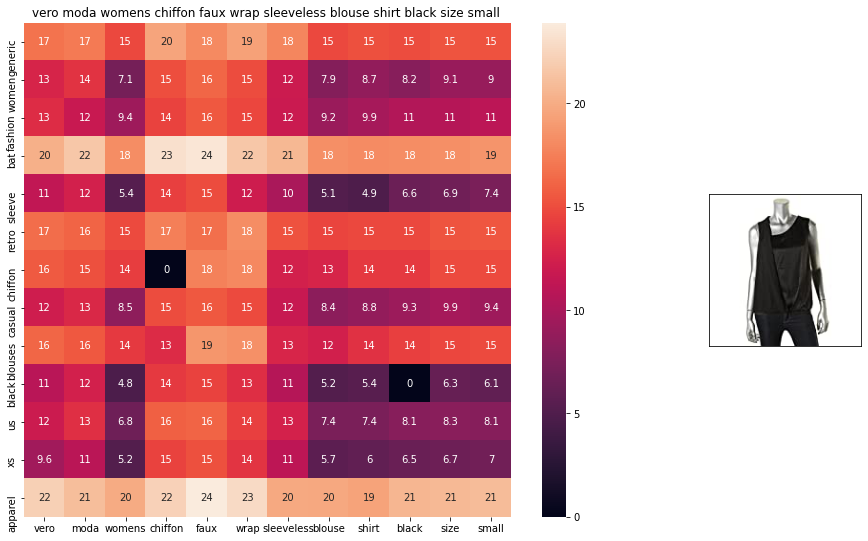

ASIN : B0719JZ1N3
Brand : VERO MODA
euclidean distance from input : 3.882325


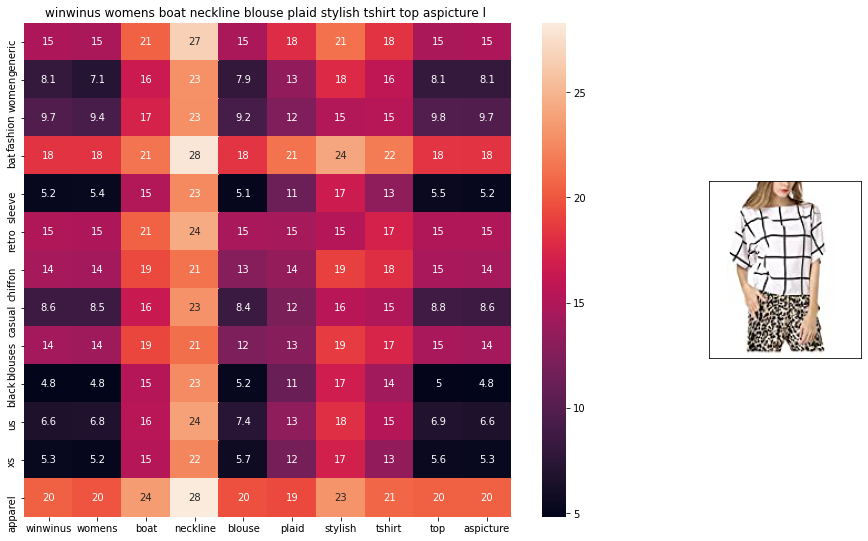

ASIN : B01LEKS4LQ
Brand : Winwinus
euclidean distance from input : 3.9081213


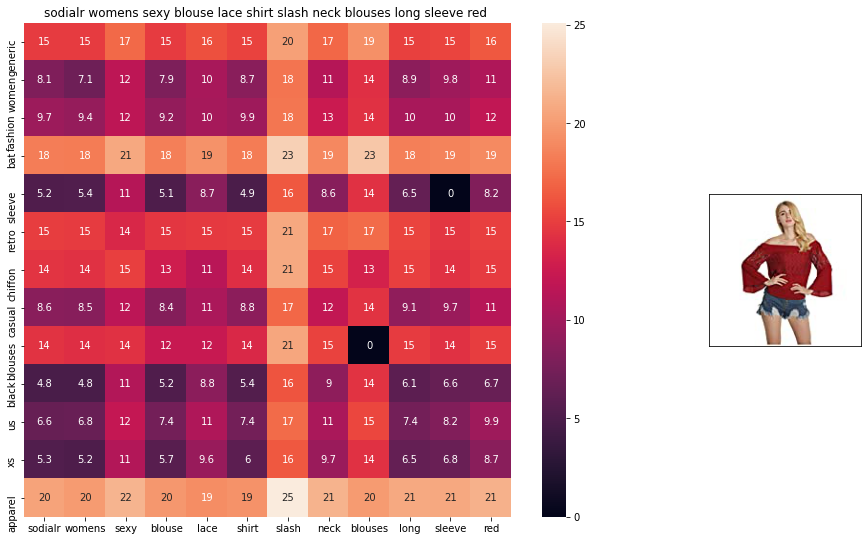

ASIN : B01MY9VNBW
Brand : SODIAL(R)
euclidean distance from input : 3.9235184


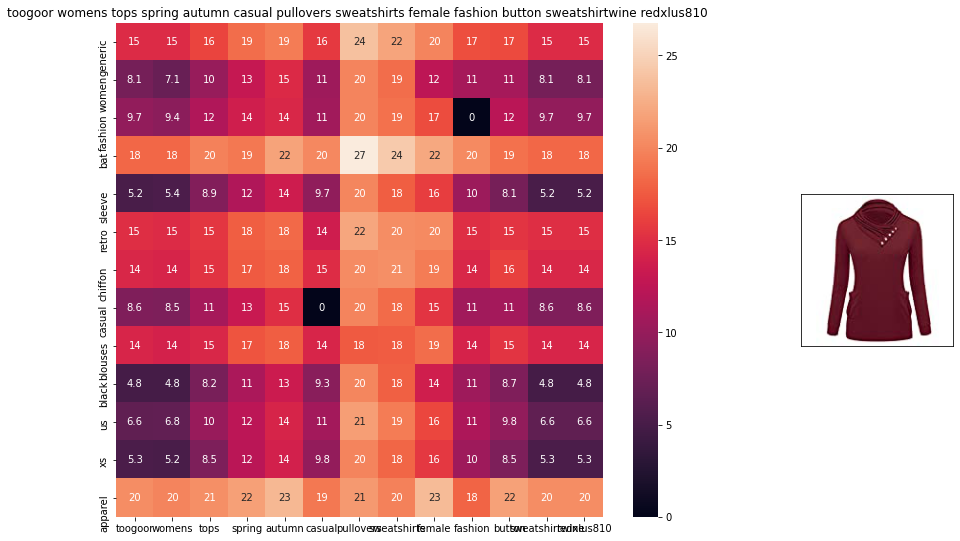

ASIN : B01N144I9J
Brand : TOOGOO(R)
euclidean distance from input : 3.954854


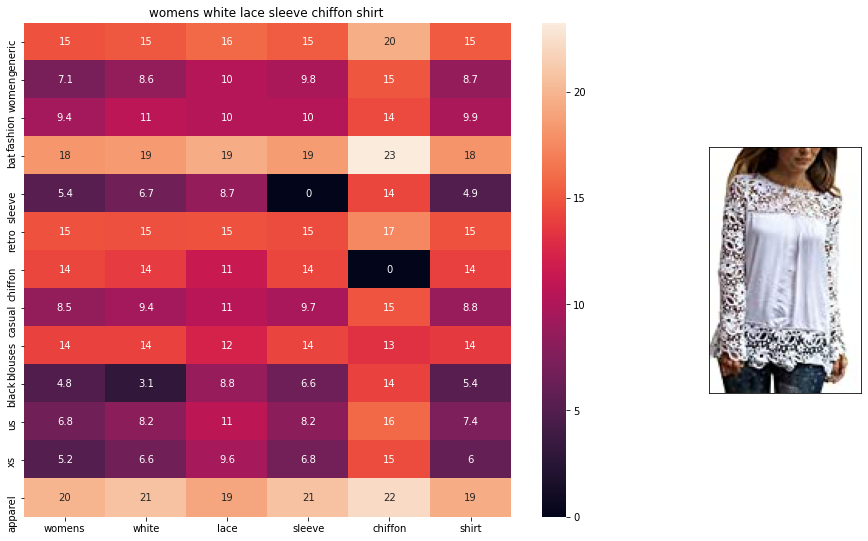

ASIN : B073JWSM1V
Brand : Fuming
euclidean distance from input : 3.9635832


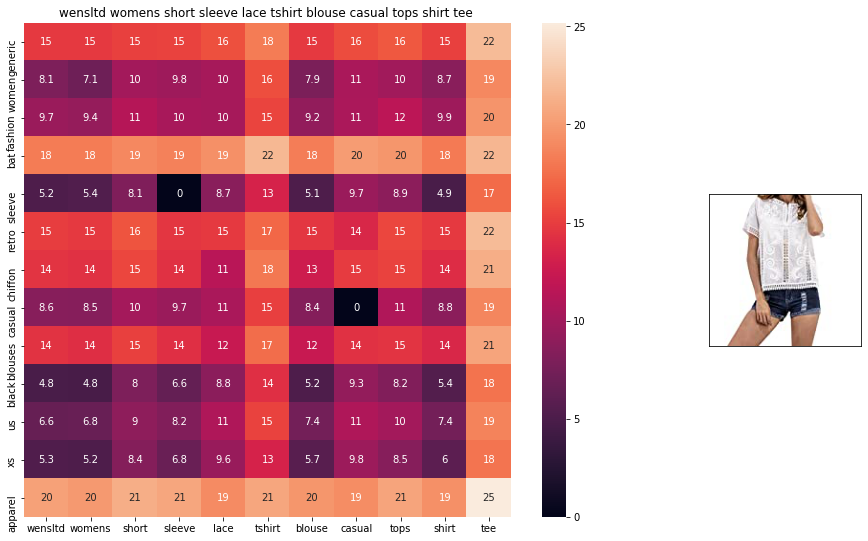

ASIN : B06W2LXT6G
Brand : WensLTD
euclidean distance from input : 3.9741323


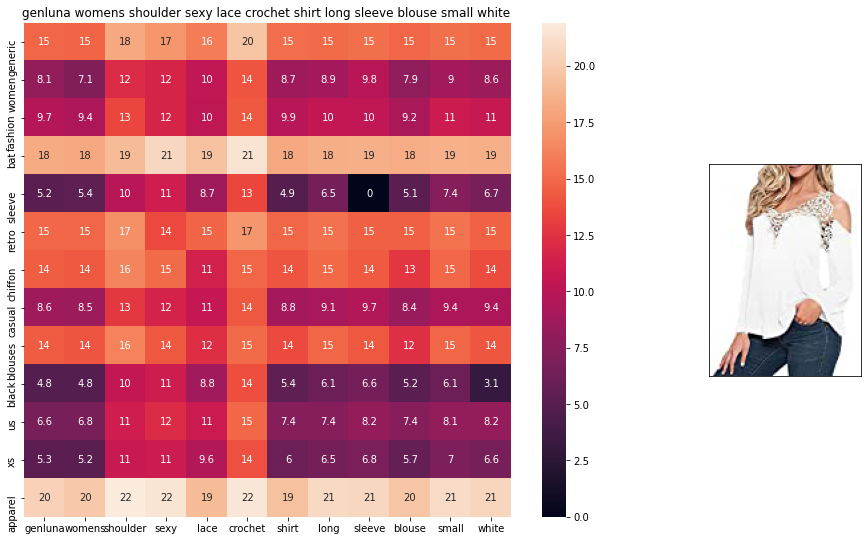

ASIN : B01LZRBG03
Brand : Genluna
euclidean distance from input : 3.9877687


In [122]:
def weighted_w2v_model(doc_id, num_results):
    # doc_id: apparel's id in given corpus
    
    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    pairwise_dist = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    
    for i in range(0, len(indices)):
        heat_map_w2v(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

weighted_w2v_model(125, 20)
#931
#12566
# in the give heat map, each cell contains the euclidean distance between words i, j

### [9.6] Weighted similarity using brand and color.

In [0]:
# some of the brand values are empty. 
# Need to replace Null with string "NULL"
data['brand'].fillna(value="Not given", inplace=True )

# replace spaces with hypen
brands = [x.replace(" ", "-") for x in data['brand'].values]
types = [x.replace(" ", "-") for x in data['product_type_name'].values]
colors = [x.replace(" ", "-") for x in data['color'].values]

brand_vectorizer = CountVectorizer()
brand_features = brand_vectorizer.fit_transform(brands)

type_vectorizer = CountVectorizer()
type_features = type_vectorizer.fit_transform(types)

color_vectorizer = CountVectorizer()
color_features = color_vectorizer.fit_transform(colors)

extra_features = hstack((brand_features, type_features, color_features)).tocsr()

In [0]:
def heat_map_w2v_brand(sentance1, sentance2, url, doc_id1, doc_id2, df_id1, df_id2, model):
    
    # sentance1 : title1, input apparel
    # sentance2 : title2, recommended apparel
    # url: apparel image url
    # doc_id1: document id of input apparel
    # doc_id2: document id of recommended apparel
    # df_id1: index of document1 in the data frame
    # df_id2: index of document2 in the data frame
    # model: it can have two values, 1. avg 2. weighted
    
    #s1_vec = np.array(#number_of_words_title1 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s1_vec = get_word_vec(sentance1, doc_id1, model)
    #s2_vec = np.array(#number_of_words_title2 * 300), each row is a vector(weighted/avg) of length 300 corresponds to each word in give title
    s2_vec = get_word_vec(sentance2, doc_id2, model)
    
    # s1_s2_dist = np.array(#number of words in title1 * #number of words in title2)
    # s1_s2_dist[i,j] = euclidean distance between words i, j
    s1_s2_dist = get_distance(s1_vec, s2_vec)
   
    data_matrix = [['Asin','Brand', 'Color', 'Product type'],
               [data['asin'].loc[df_id1],brands[doc_id1], colors[doc_id1], types[doc_id1]], # input apparel's features
               [data['asin'].loc[df_id2],brands[doc_id2], colors[doc_id2], types[doc_id2]]] # recommonded apparel's features
    
    colorscale = [[0, '#1d004d'],[.5, '#f2e5ff'],[1, '#f2e5d1']] # to color the headings of each column 
    
    # we create a table with the data_matrix
    table = ff.create_table(data_matrix, index=True, colorscale=colorscale)
    # plot it with plotly
    plotly.offline.iplot(table, filename='simple_table')
    
    # devide whole figure space into 25 * 1:10 grids
    gs = gridspec.GridSpec(25, 15)
    fig = plt.figure(figsize=(25,5))
    
    # in first 25*10 grids we plot heatmap
    ax1 = plt.subplot(gs[:, :-5])
    # ploting the heap map based on the pairwise distances
    ax1 = sns.heatmap(np.round(s1_s2_dist,6), annot=True)
    # set the x axis labels as recommended apparels title
    ax1.set_xticklabels(sentance2.split())
    # set the y axis labels as input apparels title
    ax1.set_yticklabels(sentance1.split())
    # set title as recommended apparels title
    ax1.set_title(sentance2)

    # in last 25 * 10:15 grids we display image
    ax2 = plt.subplot(gs[:, 10:16])
    # we dont display grid lins and axis labels to images
    ax2.grid(False)
    ax2.set_xticks([])
    ax2.set_yticks([])
    
    # pass the url it display it
    display_img(url, ax2, fig)
    
    plt.show()

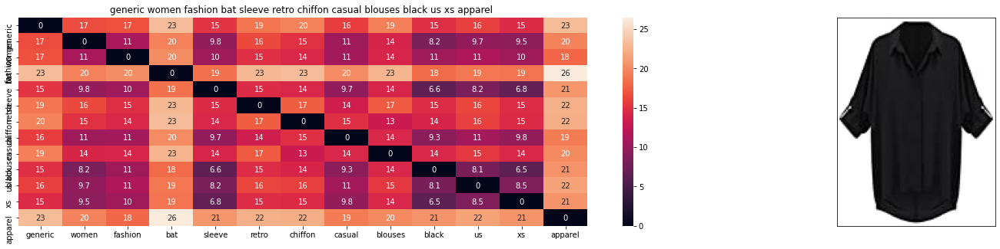

ASIN : B019MDNF8Y
Brand : Absolutely
euclidean distance from input : 0.0


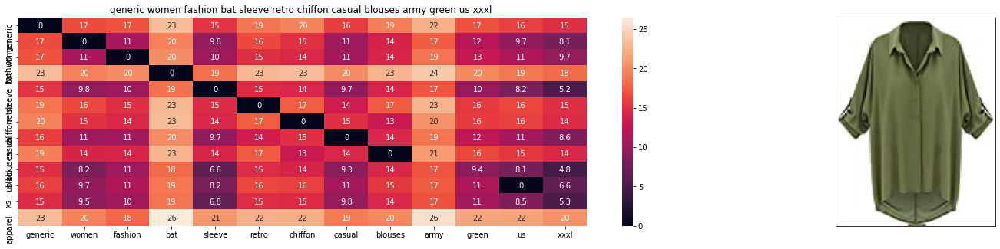

ASIN : B019MDNNHC
Brand : Absolutely
euclidean distance from input : 1.9286934411989893


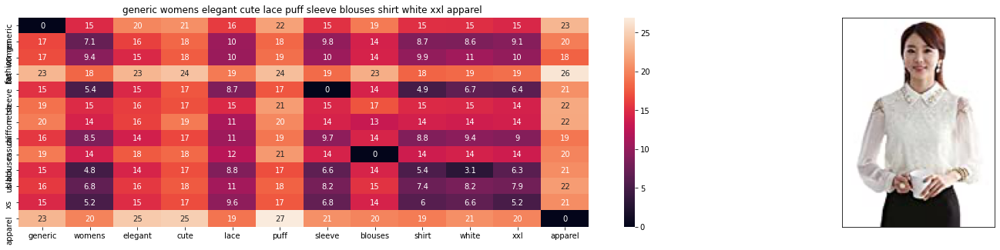

ASIN : B014CF1PC0
Brand : Absolutely
euclidean distance from input : 2.1627079011816646


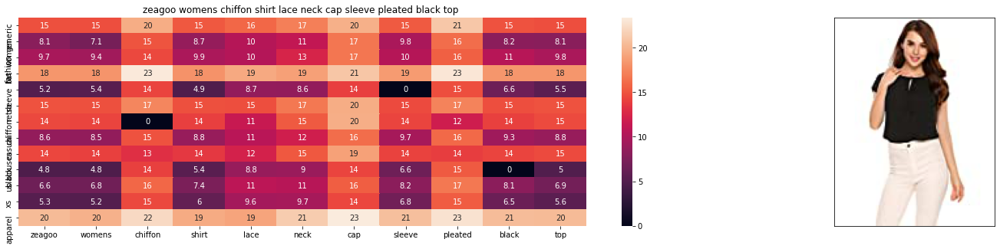

ASIN : B072MYLMVY
Brand : Zeagoo
euclidean distance from input : 2.7622655870337156


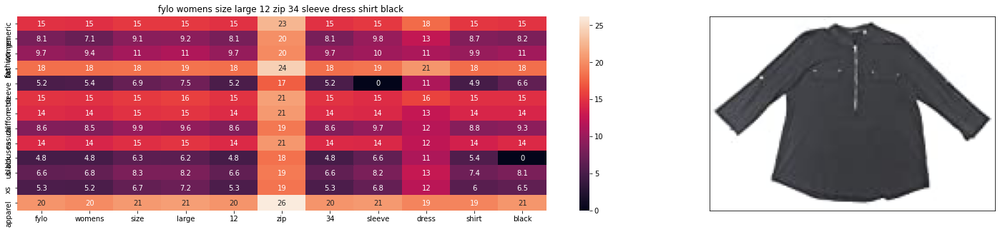

ASIN : B0718Y9J4M
Brand : f
euclidean distance from input : 2.7741701126098635


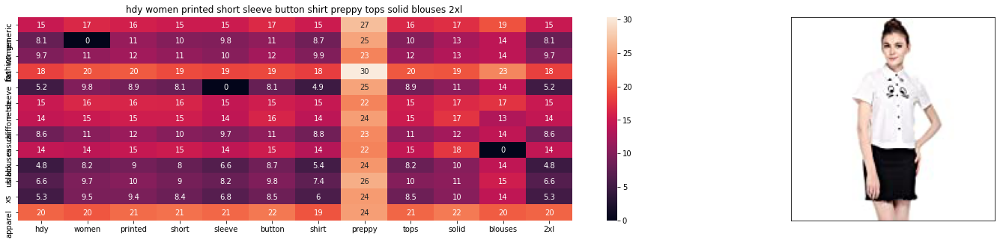

ASIN : B01M9C24GM
Brand : WeHeart
euclidean distance from input : 2.791305732727051


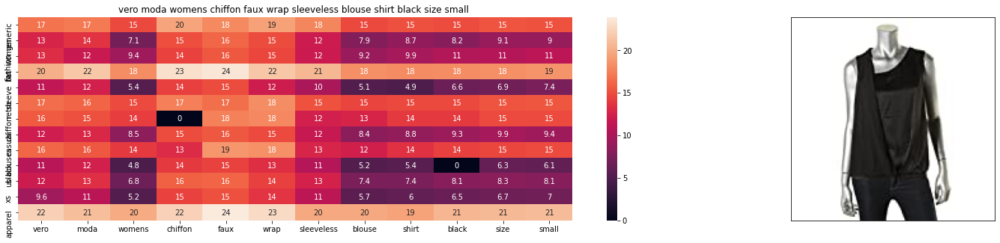

ASIN : B0719JZ1N3
Brand : VERO MODA
euclidean distance from input : 2.8071878946291653


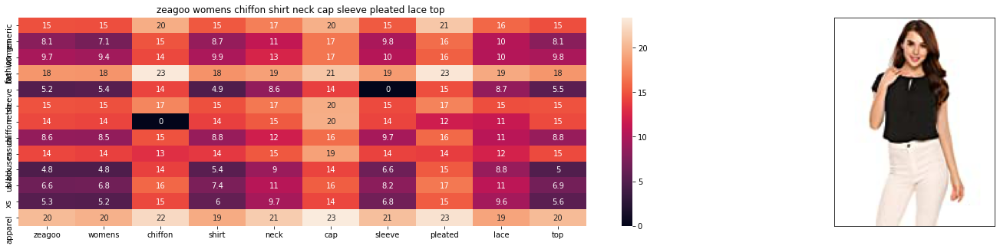

ASIN : B072KCRTKK
Brand : Zeagoo
euclidean distance from input : 2.813902855100122


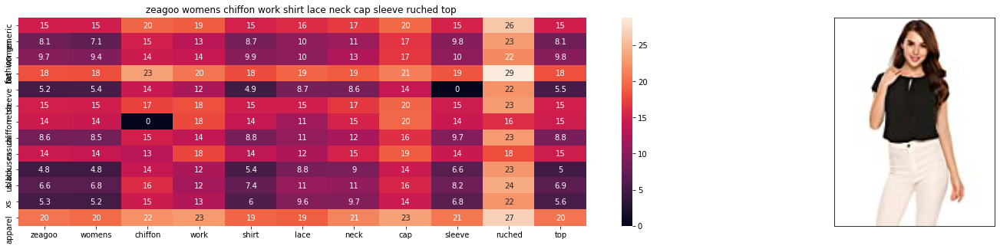

ASIN : B071GK7CNP
Brand : Zeagoo
euclidean distance from input : 2.8338840486426022


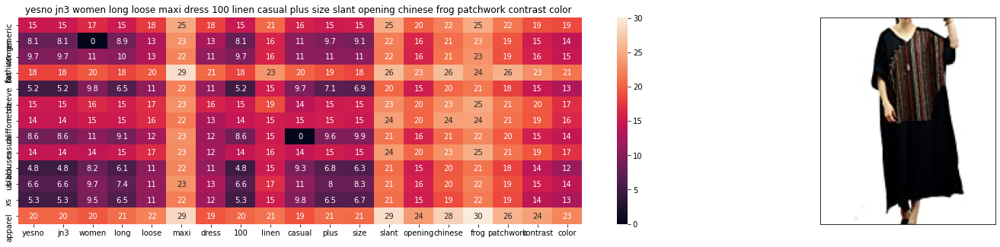

ASIN : B073ZYCCCQ
Brand : YESNO
euclidean distance from input : 2.8460166932959226


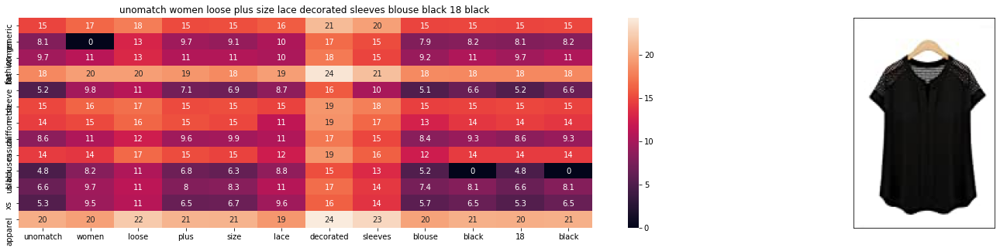

ASIN : B01MZFZOFD
Brand : Unomatch
euclidean distance from input : 2.8754356386084226


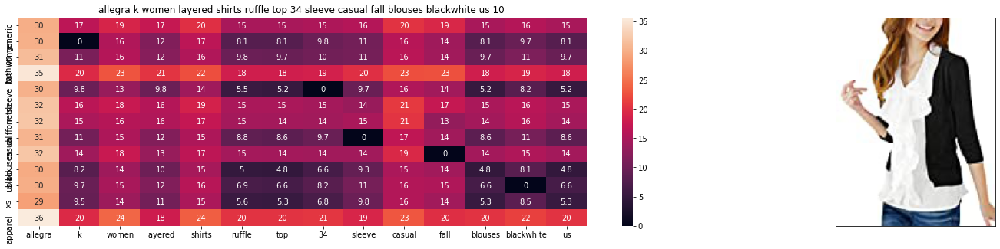

ASIN : B008X1FTI6
Brand : Allegra K
euclidean distance from input : 2.8808573282229153


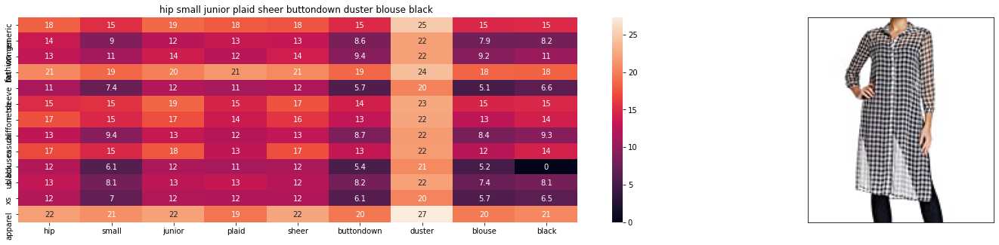

ASIN : B07582L1MH
Brand : Hip
euclidean distance from input : 2.9102188112158442


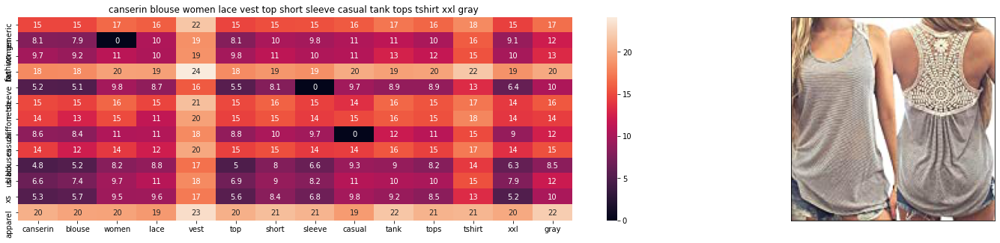

ASIN : B01GNNWE5G
Brand : Canserin
euclidean distance from input : 2.926162528991699


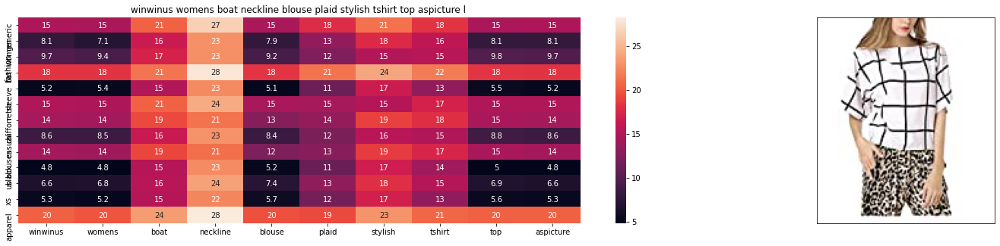

ASIN : B01LEKS4LQ
Brand : Winwinus
euclidean distance from input : 2.954060745239258


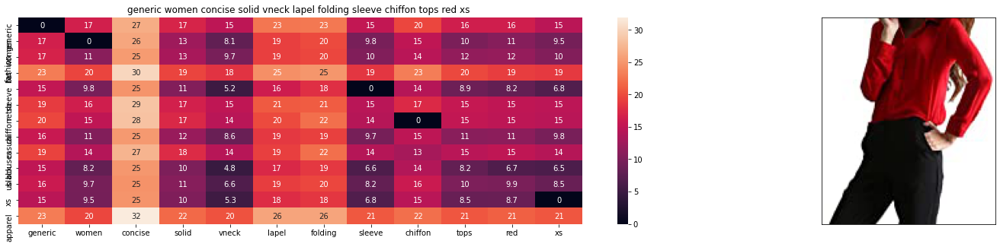

ASIN : B013JPTCV0
Brand : Absolutely
euclidean distance from input : 2.971723747434106


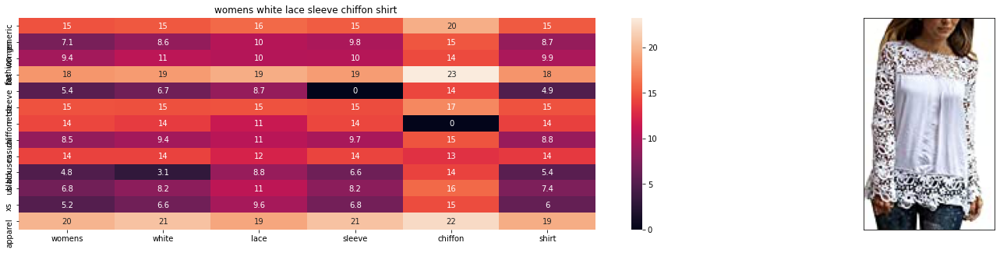

ASIN : B073JWSM1V
Brand : Fuming
euclidean distance from input : 2.981791687011719


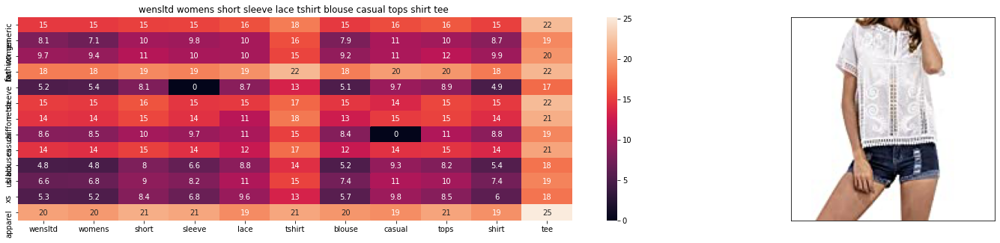

ASIN : B06W2LXT6G
Brand : WensLTD
euclidean distance from input : 2.987066078186035


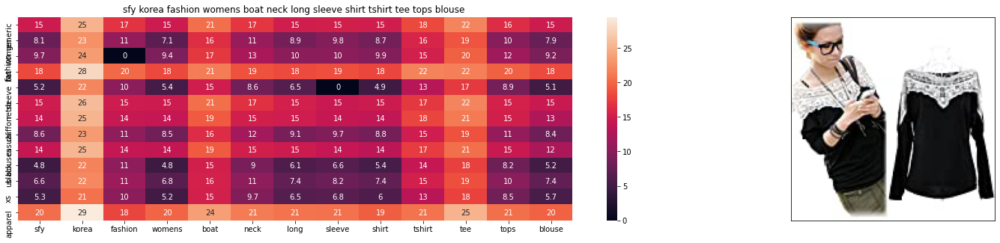

ASIN : B01MCTNYL2
Brand : SoForYou
euclidean distance from input : 2.9933956148047116


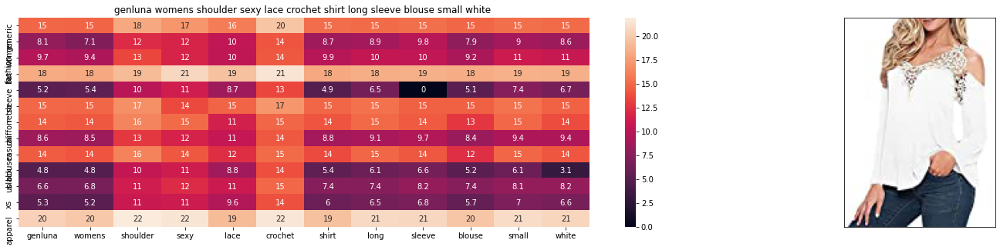

ASIN : B01LZRBG03
Brand : Genluna
euclidean distance from input : 2.99388427734375


In [126]:
def idf_w2v_brand(doc_id, w1, w2, num_results):
    # doc_id: apparel's id in given corpus
    # w1: weight for  w2v features
    # w2: weight for brand and color features

    # pairwise_dist will store the distance from given input apparel to all remaining apparels
    # the metric we used here is cosine, the coside distance is mesured as K(X, Y) = <X, Y> / (||X||*||Y||)
    # http://scikit-learn.org/stable/modules/metrics.html#cosine-similarity
    idf_w2v_dist  = pairwise_distances(w2v_title_weight, w2v_title_weight[doc_id].reshape(1,-1))
    ex_feat_dist = pairwise_distances(extra_features, extra_features[doc_id])
    pairwise_dist   = (w1 * idf_w2v_dist +  w2 * ex_feat_dist)/float(w1 + w2)

    # np.argsort will return indices of 9 smallest distances
    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    #pdists will store the 9 smallest distances
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    #data frame indices of the 9 smallest distace's
    df_indices = list(data.index[indices])
    

    for i in range(0, len(indices)):
        heat_map_w2v_brand(data['title'].loc[df_indices[0]],data['title'].loc[df_indices[i]], data['medium_image_url'].loc[df_indices[i]], indices[0], indices[i],df_indices[0], df_indices[i], 'weighted')
        print('ASIN :',data['asin'].loc[df_indices[i]])
        print('Brand :',data['brand'].loc[df_indices[i]])
        print('euclidean distance from input :', pdists[i])
        print('='*125)

idf_w2v_brand(125, 5, 5, 20)
# in the give heat map, each cell contains the euclidean distance between words i, j

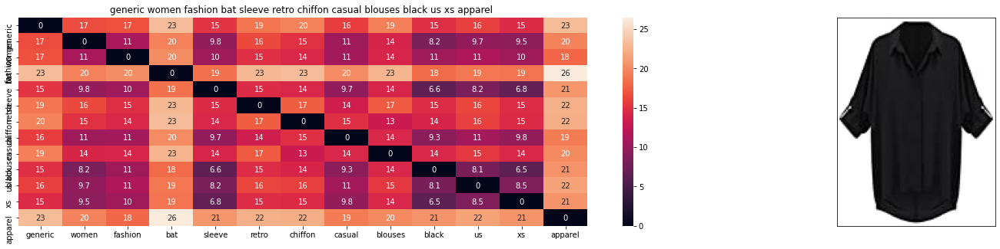

ASIN : B019MDNF8Y
Brand : Absolutely
euclidean distance from input : 0.0


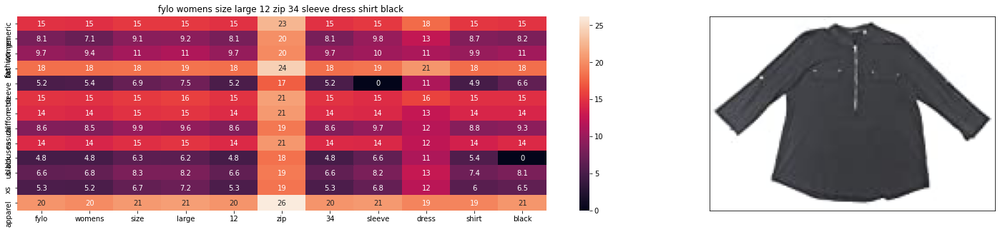

ASIN : B0718Y9J4M
Brand : f
euclidean distance from input : 1.3225763841108842


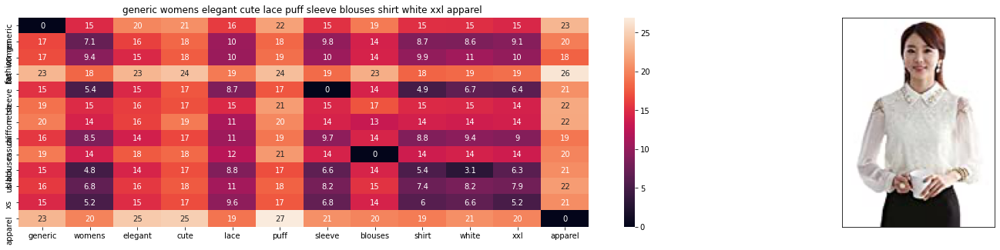

ASIN : B014CF1PC0
Brand : Absolutely
euclidean distance from input : 1.5503034421564714


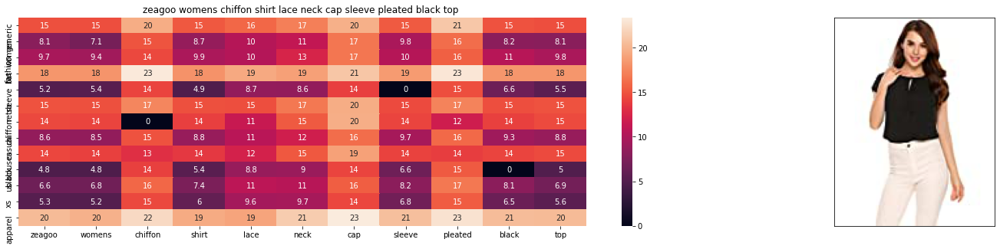

ASIN : B072MYLMVY
Brand : Zeagoo
euclidean distance from input : 1.6593139304932079


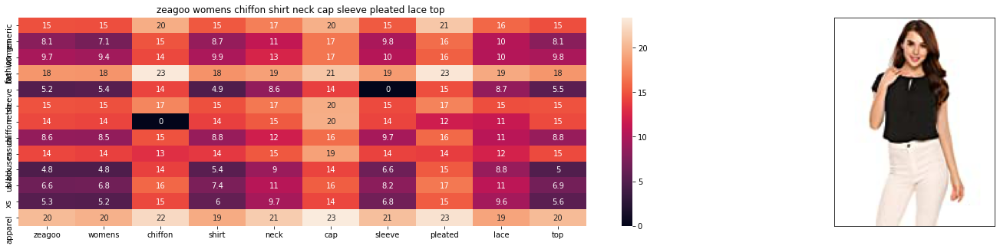

ASIN : B072KCRTKK
Brand : Zeagoo
euclidean distance from input : 1.6687025246871


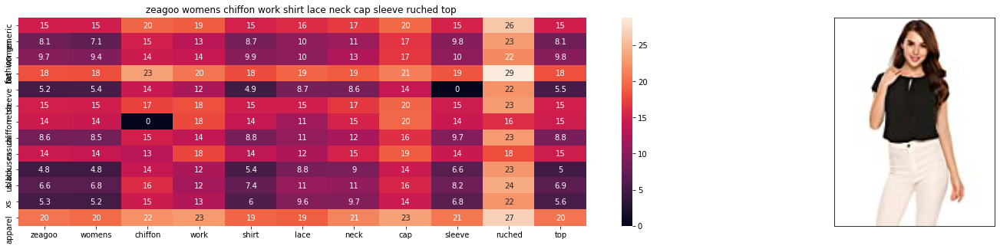

ASIN : B071GK7CNP
Brand : Zeagoo
euclidean distance from input : 1.672335468967551


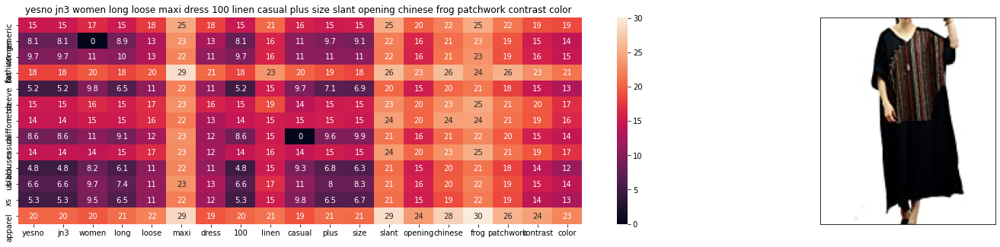

ASIN : B073ZYCCCQ
Brand : YESNO
euclidean distance from input : 1.6745414043590636


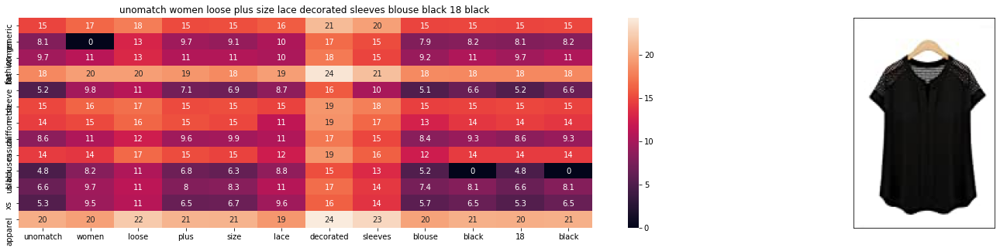

ASIN : B01MZFZOFD
Brand : Unomatch
euclidean distance from input : 1.679890303506791


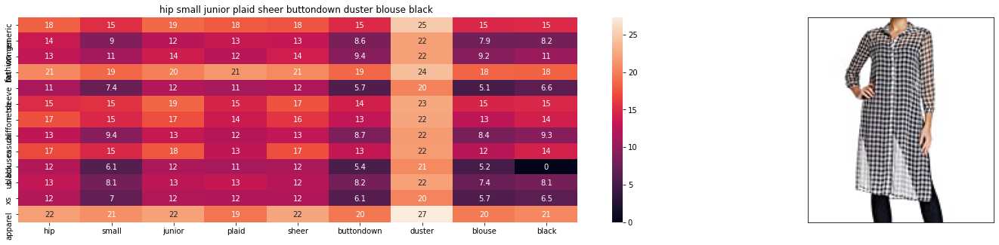

ASIN : B07582L1MH
Brand : Hip
euclidean distance from input : 1.6862145167081404


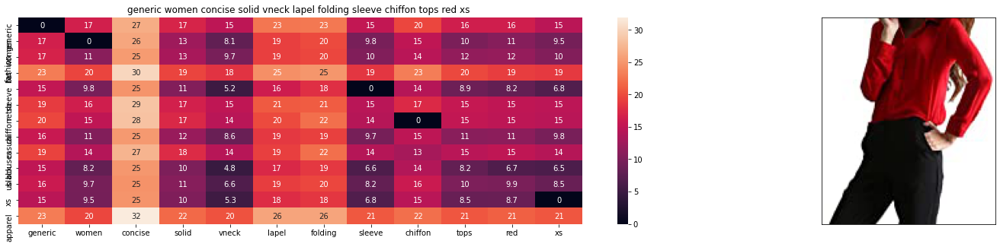

ASIN : B013JPTCV0
Brand : Absolutely
euclidean distance from input : 1.697397232384188


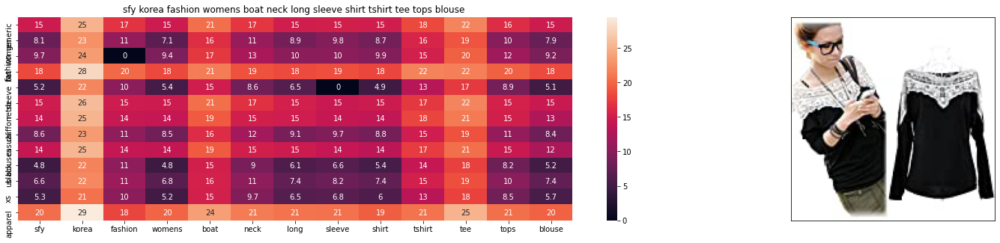

ASIN : B01MCTNYL2
Brand : SoForYou
euclidean distance from input : 1.7013375719061163


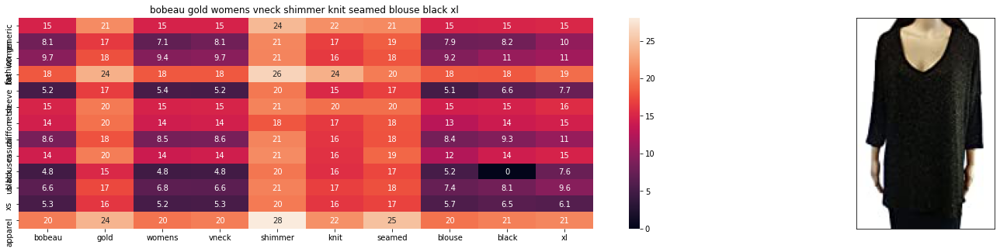

ASIN : B071LHRT1W
Brand : Bobeau
euclidean distance from input : 1.7033675803955517


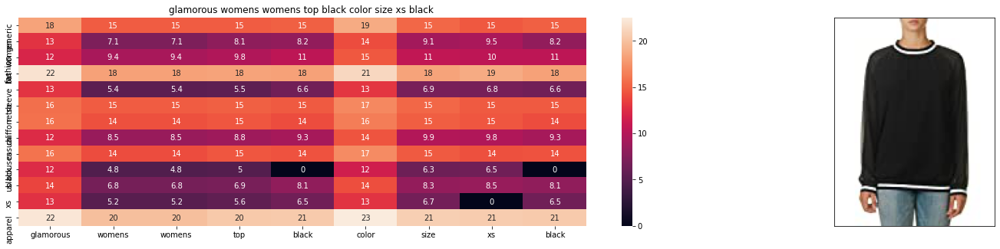

ASIN : B01LWXT1BI
Brand : Glamorous
euclidean distance from input : 1.7041421720148697


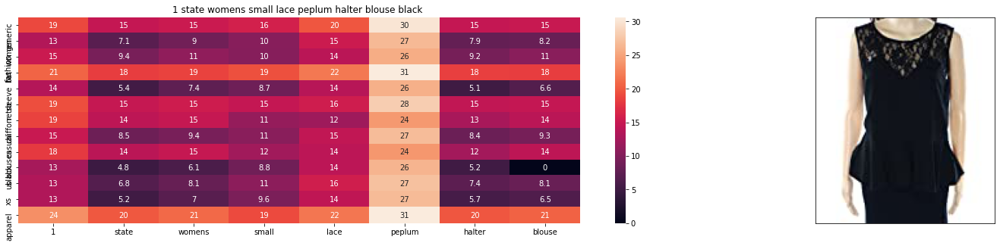

ASIN : B072XN45H5
Brand : 1.State
euclidean distance from input : 1.7042964591797314


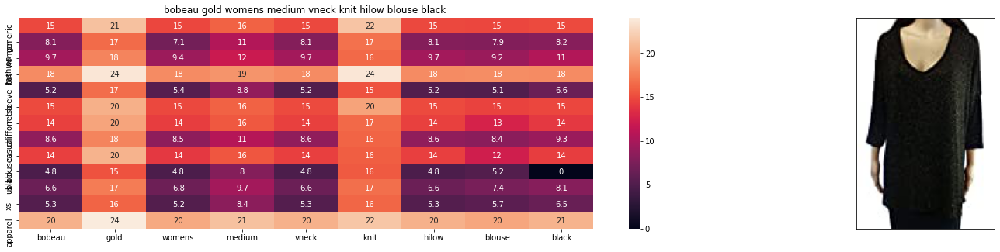

ASIN : B0719S3N2Y
Brand : Bobeau
euclidean distance from input : 1.7146387970481618


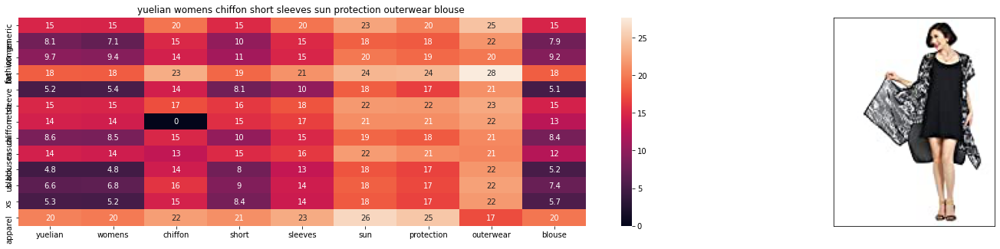

ASIN : B01MRV2IFS
Brand : YueLian
euclidean distance from input : 1.716621954119362


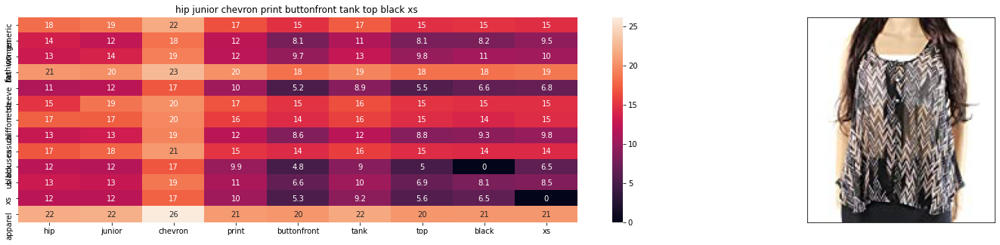

ASIN : B0716TC3YF
Brand : Hip
euclidean distance from input : 1.723791469555708


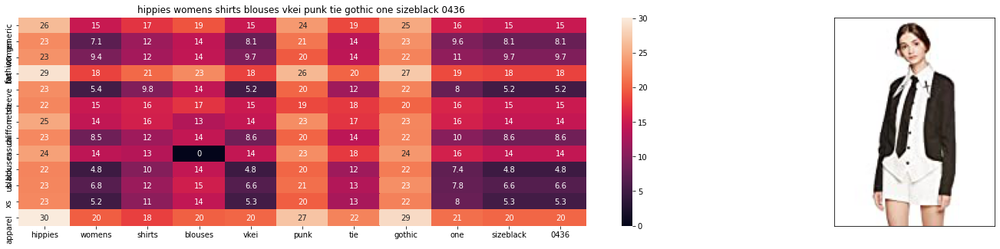

ASIN : B00QNCAN1U
Brand : Hippies
euclidean distance from input : 1.7244706590643195


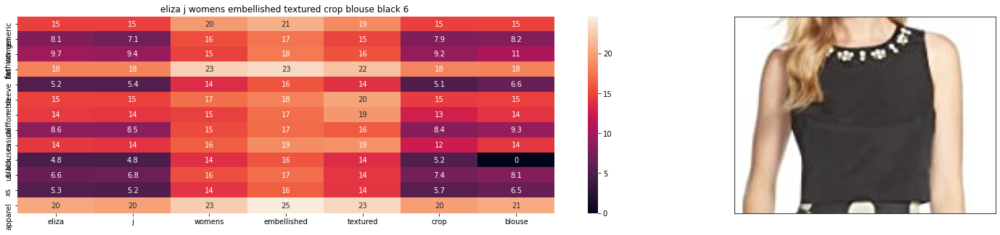

ASIN : B0757ZSHH3
Brand : Eliza J
euclidean distance from input : 1.725111874995605


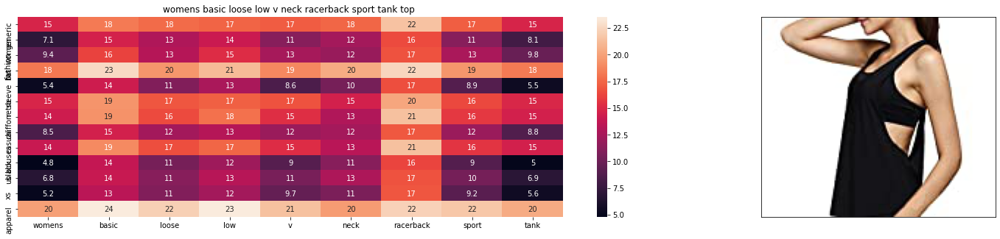

ASIN : B06W2MYXPM
Brand : Shawhuaa
euclidean distance from input : 1.7277203649858393


In [128]:
# brand and color weight =50
# title vector weight = 5

idf_w2v_brand(125, 5, 50, 20)

# [10.2] Keras and Tensorflow to extract features

In [129]:
import numpy as np
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense
from keras import applications
from sklearn.metrics import pairwise_distances
import matplotlib.pyplot as plt
import requests
from PIL import Image
import pandas as pd
import pickle

Using TensorFlow backend.


In [130]:
# https://gist.github.com/fchollet/f35fbc80e066a49d65f1688a7e99f069
# Code reference: https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html



# This code takes 40 minutes to run on a modern GPU (graphics card) 
# like Nvidia  1050.
# GPU (NVidia 1050): 0.175 seconds per image

# This codse takes 160 minutes to run on a high end i7 CPU
# CPU (i7): 0.615 seconds per image.

#Do NOT run this code unless you want to wait a few hours for it to generate output

# each image is converted into 25088 length dense-vector


'''
# dimensions of our images.
img_width, img_height = 224, 224

top_model_weights_path = 'bottleneck_fc_model.h5'
train_data_dir = 'images2/'
nb_train_samples = 16042
epochs = 50
batch_size = 1


def save_bottlebeck_features():
    
    #Function to compute VGG-16 CNN for image feature extraction.
    
    asins = []
    datagen = ImageDataGenerator(rescale=1. / 255)
    
    # build the VGG16 network
    model = applications.VGG16(include_top=False, weights='imagenet')
    generator = datagen.flow_from_directory(
        train_data_dir,
        target_size=(img_width, img_height),
        batch_size=batch_size,
        class_mode=None,
        shuffle=False)

    for i in generator.filenames:
        asins.append(i[2:-5])

    bottleneck_features_train = model.predict_generator(generator, nb_train_samples // batch_size)
    bottleneck_features_train = bottleneck_features_train.reshape((16042,25088))
    
    np.save(open('16k_data_cnn_features.npy', 'wb'), bottleneck_features_train)
    np.save(open('16k_data_cnn_feature_asins.npy', 'wb'), np.array(asins))
    

save_bottlebeck_features()

'''

"\n# dimensions of our images.\nimg_width, img_height = 224, 224\n\ntop_model_weights_path = 'bottleneck_fc_model.h5'\ntrain_data_dir = 'images2/'\nnb_train_samples = 16042\nepochs = 50\nbatch_size = 1\n\n\ndef save_bottlebeck_features():\n    \n    #Function to compute VGG-16 CNN for image feature extraction.\n    \n    asins = []\n    datagen = ImageDataGenerator(rescale=1. / 255)\n    \n    # build the VGG16 network\n    model = applications.VGG16(include_top=False, weights='imagenet')\n    generator = datagen.flow_from_directory(\n        train_data_dir,\n        target_size=(img_width, img_height),\n        batch_size=batch_size,\n        class_mode=None,\n        shuffle=False)\n\n    for i in generator.filenames:\n        asins.append(i[2:-5])\n\n    bottleneck_features_train = model.predict_generator(generator, nb_train_samples // batch_size)\n    bottleneck_features_train = bottleneck_features_train.reshape((16042,25088))\n    \n    np.save(open('16k_data_cnn_features.npy', 'w

# [10.3] Visual features based product similarity.

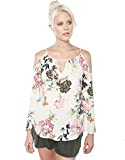

Product Title:  fifteen twenty floral print cold shoulder top 
Euclidean Distance from input image: 4.862804e-06
Amazon Url: www.amzon.com/dp/B06XJ66M4P


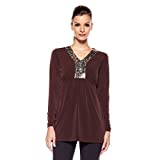

Product Title:  hot hollywood sequin leopard henley 203608 brown 
Euclidean Distance from input image: 40.760216
Amazon Url: www.amzon.com/dp/B074HF4HMD


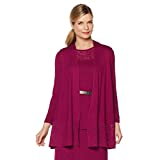

Product Title:  antthony burn baby burn burnout hem vest 538225 magenta 
Euclidean Distance from input image: 41.38967
Amazon Url: www.amzon.com/dp/B0759XVPM1


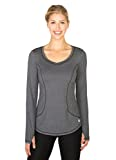

Product Title:  rbx active womens long sleeve heathered stripe top 
Euclidean Distance from input image: 41.728043
Amazon Url: www.amzon.com/dp/B06XWV6FWM


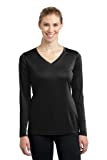

Product Title:  sporttek ladies long sleeve vneck competitor teexs black lst353ls 
Euclidean Distance from input image: 42.18612
Amazon Url: www.amzon.com/dp/B00J9UIK0O


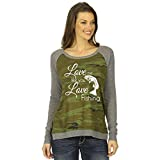

Product Title:  pikolai women stitching letters printed longsleeved tshirt top blouse xl army green 
Euclidean Distance from input image: 42.278744
Amazon Url: www.amzon.com/dp/B01LYP1FWS


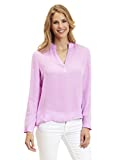

Product Title:  robert graham womens blouse trish lavender small 
Euclidean Distance from input image: 42.501396
Amazon Url: www.amzon.com/dp/B071NQ52LM


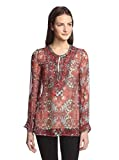

Product Title:  custo barcelona sela rococorum sequin embroidered silk tunic sheer blouse size 3 ml 
Euclidean Distance from input image: 42.562065
Amazon Url: www.amzon.com/dp/B01N4K7BEL


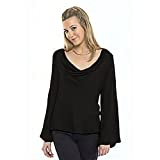

Product Title:  love sam cowl neck bell sleeve top extra small black 
Euclidean Distance from input image: 42.783405
Amazon Url: www.amzon.com/dp/B00WRSRHR2


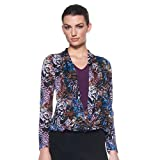

Product Title:  slinky brand long slv draped mesh twofer top 160330 blue multi 
Euclidean Distance from input image: 42.80642
Amazon Url: www.amzon.com/dp/B074LQW8H4


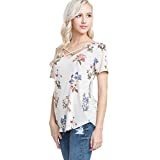

Product Title:  mitto shop t7076 beige womens shirt 
Euclidean Distance from input image: 42.872364
Amazon Url: www.amzon.com/dp/B07255NKVV


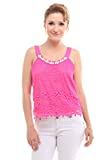

Product Title:  vitamina usa laced cropped top 8018 pink 
Euclidean Distance from input image: 42.94887
Amazon Url: www.amzon.com/dp/B00ZSP066A


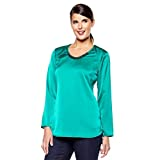

Product Title:  guilana rancic embellished neckline blouse 209389 emerald green 
Euclidean Distance from input image: 42.977634
Amazon Url: www.amzon.com/dp/B074LRK7D4


<IPython.core.display.Image object>

Product Title:  sag harbor womens petite size lace blouse duet top pinkblack pm 
Euclidean Distance from input image: 43.00709
Amazon Url: www.amzon.com/dp/B01NCAB9D8


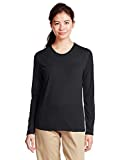

Product Title:  hot chillys pepper skins crew  women39s 
Euclidean Distance from input image: 43.070328
Amazon Url: www.amzon.com/dp/B0045VK3KM


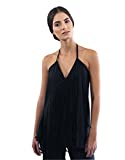

Product Title:  guayabita womens alba black blouse 
Euclidean Distance from input image: 43.07584
Amazon Url: www.amzon.com/dp/B01JM4ZO3M


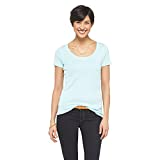

Product Title:  6 pack merona turquoise short sleeve shirt 
Euclidean Distance from input image: 43.249294
Amazon Url: www.amzon.com/dp/B01KGKYZ6I


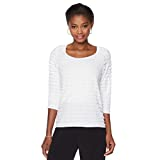

Product Title:  slinky 34slv ruffle scoopneck tee 532020 white l 
Euclidean Distance from input image: 43.27667
Amazon Url: www.amzon.com/dp/B0759W1F8F


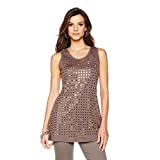

Product Title:  dg2 diane gilman sequined tank tunic 342140 taupe 
Euclidean Distance from input image: 43.384007
Amazon Url: www.amzon.com/dp/B074LXSCDF


<IPython.core.display.Image object>

Product Title:  ella moon womens irene short ruffle sleeve printed top ecru floral print small 
Euclidean Distance from input image: 43.433826
Amazon Url: www.amzon.com/dp/B01N6X5Z00


In [132]:
#load the features and corresponding ASINS info.
bottleneck_features_train = np.load('16k_data_cnn_features.npy')
asins = np.load('16k_data_cnn_feature_asins.npy')
asins = list(asins)

# load the original 16K dataset
data = pd.read_pickle('pickels/16k_apperal_data_preprocessed')
df_asins = list(data['asin'])


from IPython.display import display, Image, SVG, Math, YouTubeVideo


#get similar products using CNN features (VGG-16)
def get_similar_products_cnn(doc_id, num_results):
    doc_id = asins.index(df_asins[doc_id])
    pairwise_dist = pairwise_distances(bottleneck_features_train, bottleneck_features_train[doc_id].reshape(1,-1))

    indices = np.argsort(pairwise_dist.flatten())[0:num_results]
    pdists  = np.sort(pairwise_dist.flatten())[0:num_results]

    for i in range(len(indices)):
        rows = data[['medium_image_url','title']].loc[data['asin']==asins[indices[i]]]
        for indx, row in rows.iterrows():
            display(Image(url=row['medium_image_url'], embed=True))
            print('Product Title: ', row['title'])
            print('Euclidean Distance from input image:', pdists[i])
            print('Amazon Url: www.amzon.com/dp/'+ asins[indices[i]])

get_similar_products_cnn(125, 20)
